<a href="https://colab.research.google.com/github/Akshatpattiwar512/Exploratory-Data-Analysis/blob/main/Air_Quality_Index_India.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install missingno

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt 
import numpy as np 
import pandas as pd 
from missingno import matrix
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import plotly.express as px

In [ ]:
dfstation_hour = pd.read_csv("station_hour.csv")
dfcity_hour    = pd.read_csv("city_hour.csv")
dfstation_day  = pd.read_csv("station_day.csv")
dfcity_day     = pd.read_csv("city_day.csv")
dfstations     = pd.read_csv("stations.csv")

In [ ]:
print("List of Columns in each dataframe : ",'\n')
print('dfStation_hour : ',list(dfstation_hour.columns),'\n')
print("dfcity_hour : ",list(dfcity_hour.columns),'\n')
print("dfstation_day : ",list(dfstation_day.columns),'\n')
print("dfCity day : ",list(dfcity_day.columns),'\n')
print("dfStation : ",list(dfstations.columns),'\n')

List of Columns in each dataframe :  

dfStation_hour :  ['StationId', 'Datetime', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket'] 

dfcity_hour :  ['City', 'Datetime', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket'] 

dfstation_day :  ['StationId', 'Date', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket'] 

dfCity day :  ['City', 'Date', 'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket'] 

dfStation :  ['StationId', 'StationName', 'City', 'State', 'Status'] 



Missing Values of : dfstation_hour


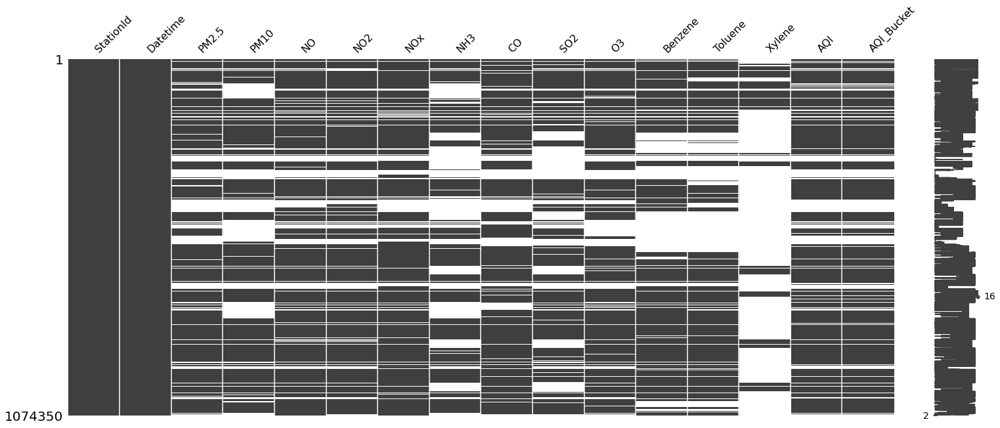

In [ ]:
print('Missing Values of : dfstation_hour')
matrix(dfstation_hour)

Missing Values of : dfcity_hour


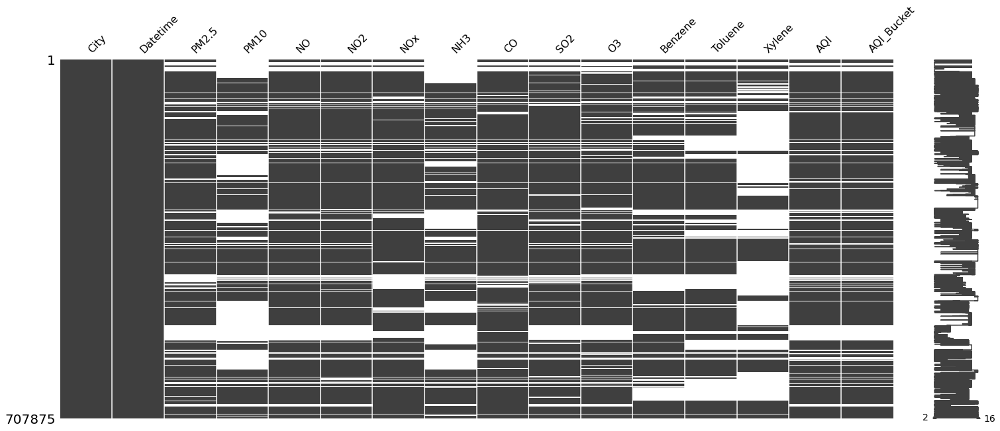

In [ ]:
print('Missing Values of : dfcity_hour')
matrix(dfcity_hour)

Missing Values of : dfstation_day


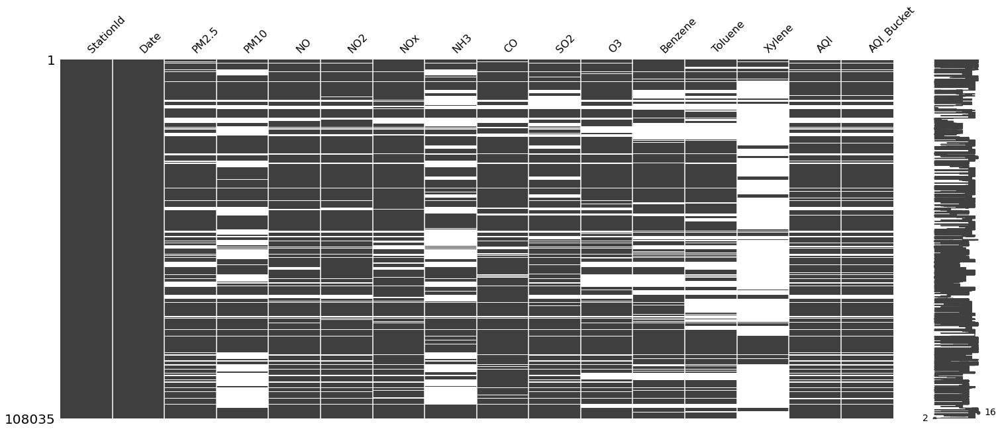

In [ ]:
print('Missing Values of : dfstation_day') 
matrix(dfstation_day) 

Missing Values of : dfcity_day


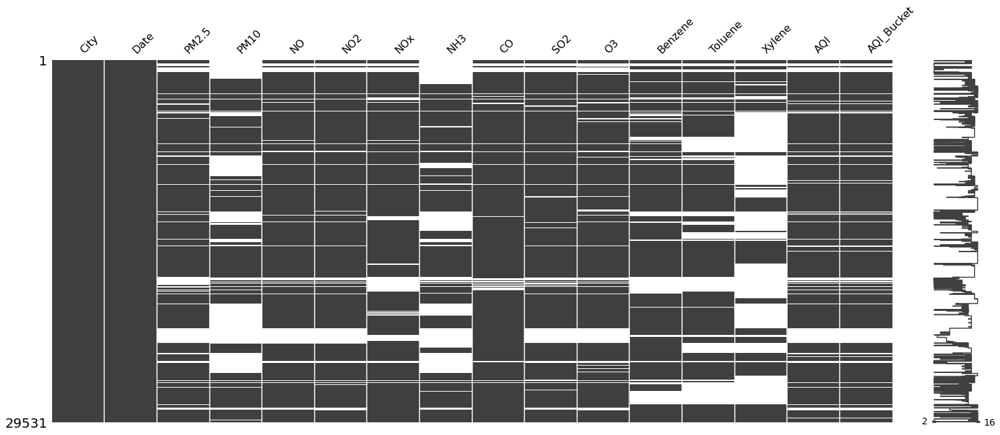

In [ ]:
print('Missing Values of : dfcity_day')    
matrix(dfcity_day)

Missing Values of : dfstations


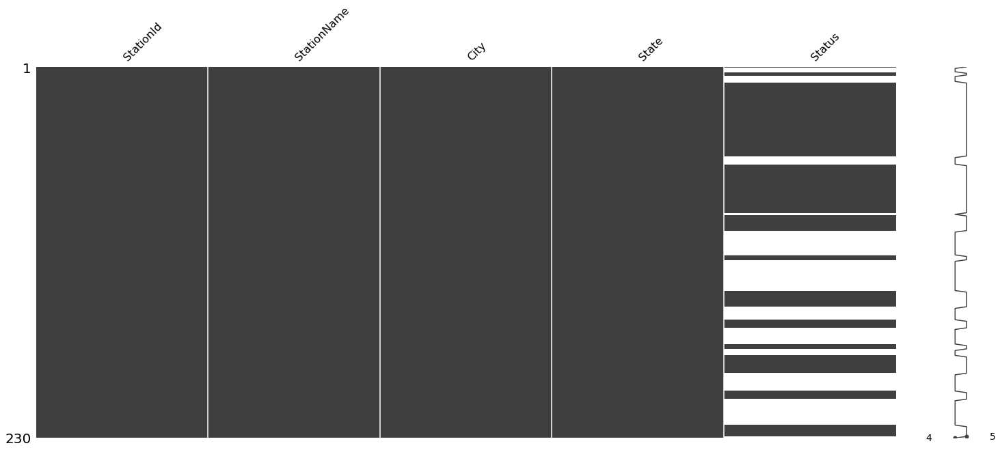

In [ ]:
print('Missing Values of : dfstations')    
matrix(dfstations)    

In [ ]:
dfstation_hour.AQI_Bucket = dfstation_hour.AQI_Bucket.fillna('Unknown')
dfcity_hour.AQI_Bucket = dfcity_hour.AQI_Bucket.fillna('Unknown')
dfstation_day.AQI_Bucket = dfstation_day.AQI_Bucket.fillna('Unknown') 
dfcity_day.AQI_Bucket = dfcity_day.AQI_Bucket.fillna('Unknown')

In [ ]:
dfstations.Status = dfstations.Status.fillna('Unknown')

In [ ]:
dfstation_hour.isnull().sum()
dfcity_hour.isnull().sum()   
dfstation_day.isnull().sum()
dfcity_day.isnull().sum()
dfstations.isnull().sum()

StationId      0
StationName    0
City           0
State          0
Status         0
dtype: int64

## Station Dataset

In [ ]:
dfstation_hour.info()
dfstation_hour.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1074350 entries, 0 to 1074349
Data columns (total 16 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   StationId   1074350 non-null  object 
 1   Datetime    1074350 non-null  object 
 2   PM2.5       820143 non-null   float64
 3   PM10        724074 non-null   float64
 4   NO          841816 non-null   float64
 5   NO2         853161 non-null   float64
 6   NOx         879932 non-null   float64
 7   NH3         599613 non-null   float64
 8   CO          849043 non-null   float64
 9   SO2         686063 non-null   float64
 10  O3          819921 non-null   float64
 11  Benzene     720574 non-null   float64
 12  Toluene     690739 non-null   float64
 13  Xylene      213458 non-null   float64
 14  AQI         829280 non-null   float64
 15  AQI_Bucket  1074350 non-null  object 
dtypes: float64(13), object(3)
memory usage: 131.1+ MB


,StationId,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,AP001,2017-11-24 17:00:00,60.50,98.00,2.35,30.80,18.25,8.50,0.1,11.85,126.40,0.1,6.10,0.10,NaN,Unknown
1,AP001,2017-11-24 18:00:00,65.50,111.25,2.70,24.20,15.07,9.77,0.1,13.17,117.12,0.1,6.25,0.15,NaN,Unknown
2,AP001,2017-11-24 19:00:00,80.00,132.00,2.10,25.18,15.15,12.02,0.1,12.08,98.98,0.2,5.98,0.18,NaN,Unknown
3,AP001,2017-11-24 20:00:00,81.50,133.25,1.95,16.25,10.23,11.58,0.1,10.47,112.20,0.2,6.72,0.10,NaN,Unknown
4,AP001,2017-11-24 21:00:00,75.25,116.00,1.43,17.48,10.43,12.03,0.1,9.12,106.35,0.2,5.75,0.08,NaN,Unknown


In [ ]:
dfstation_day.info()
dfstation_day.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 108035 entries, 0 to 108034
Data columns (total 16 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   StationId   108035 non-null  object 
 1   Date        108035 non-null  object 
 2   PM2.5       86410 non-null   float64
 3   PM10        65329 non-null   float64
 4   NO          90929 non-null   float64
 5   NO2         91488 non-null   float64
 6   NOx         92535 non-null   float64
 7   NH3         59930 non-null   float64
 8   CO          95037 non-null   float64
 9   SO2         82831 non-null   float64
 10  O3          82467 non-null   float64
 11  Benzene     76580 non-null   float64
 12  Toluene     69333 non-null   float64
 13  Xylene      22898 non-null   float64
 14  AQI         87025 non-null   float64
 15  AQI_Bucket  108035 non-null  object 
dtypes: float64(13), object(3)
memory usage: 13.2+ MB


,StationId,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,AP001,2017-11-24,71.36,115.75,1.75,20.65,12.40,12.19,0.10,10.76,109.26,0.17,5.92,0.10,NaN,Unknown
1,AP001,2017-11-25,81.40,124.50,1.44,20.50,12.08,10.72,0.12,15.24,127.09,0.20,6.50,0.06,184.0,Moderate
2,AP001,2017-11-26,78.32,129.06,1.26,26.00,14.85,10.28,0.14,26.96,117.44,0.22,7.95,0.08,197.0,Moderate
3,AP001,2017-11-27,88.76,135.32,6.60,30.85,21.77,12.91,0.11,33.59,111.81,0.29,7.63,0.12,198.0,Moderate
4,AP001,2017-11-28,64.18,104.09,2.56,28.07,17.01,11.42,0.09,19.00,138.18,0.17,5.02,0.07,188.0,Moderate


In [ ]:
dfstations.info()
dfstations.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 230 entries, 0 to 229
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   StationId    230 non-null    object
 1   StationName  230 non-null    object
 2   City         230 non-null    object
 3   State        230 non-null    object
 4   Status       230 non-null    object
dtypes: object(5)
memory usage: 9.1+ KB


,StationId,StationName,City,State,Status
0,AP001,"Secretariat, Amaravati - APPCB",Amaravati,Andhra Pradesh,Active
1,AP002,"Anand Kala Kshetram, Rajamahendravaram - APPCB",Rajamahendravaram,Andhra Pradesh,Unknown
2,AP003,"Tirumala, Tirupati - APPCB",Tirupati,Andhra Pradesh,Unknown
3,AP004,"PWD Grounds, Vijayawada - APPCB",Vijayawada,Andhra Pradesh,Unknown
4,AP005,"GVM Corporation, Visakhapatnam - APPCB",Visakhapatnam,Andhra Pradesh,Active


### Count of types of station

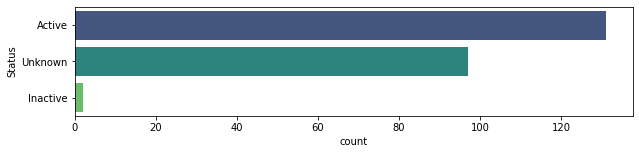

In [ ]:
plt.figure(figsize=(10,2))
sns.countplot(y='Status',data = dfstations,palette='viridis')
sns.set(style="whitegrid", font_scale= 1.5)

### City Wise number of Active stations

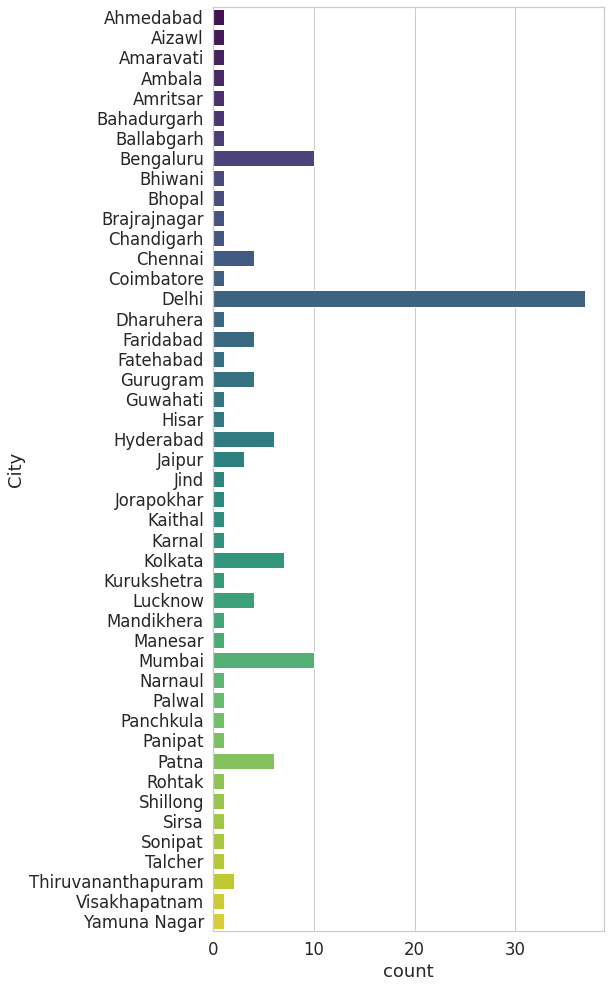

In [ ]:
active_station = dfstations[dfstations['Status']=='Active'].sort_values(by='City')
plt.figure(figsize=(7,17))
sns.countplot(y='City',data = active_station,palette='viridis')
sns.set(style="whitegrid", font_scale=1.5)

### Top 5 cities with number of Active stations

In [ ]:
active_station['City'].value_counts().nlargest(5)

Delhi        37
Bengaluru    10
Mumbai       10
Kolkata       7
Patna         6
Name: City, dtype: int64

### City Wise number of Inactive stations

Text(0.5, 1.0, 'Citywise Number of Inactive Stations')

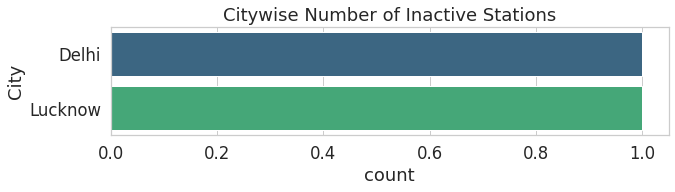

In [ ]:
inactive_station = dfstations[dfstations['Status']=='Inactive'].sort_values(by='City')
plt.figure(figsize=(10,2))
sns.countplot(y='City',data = inactive_station,palette='viridis')
sns.set(style="whitegrid", font_scale=1.5)
plt.title('Citywise Number of Inactive Stations')

### City Wise number of Unknown stations

Citywise Number of Unknown Stations


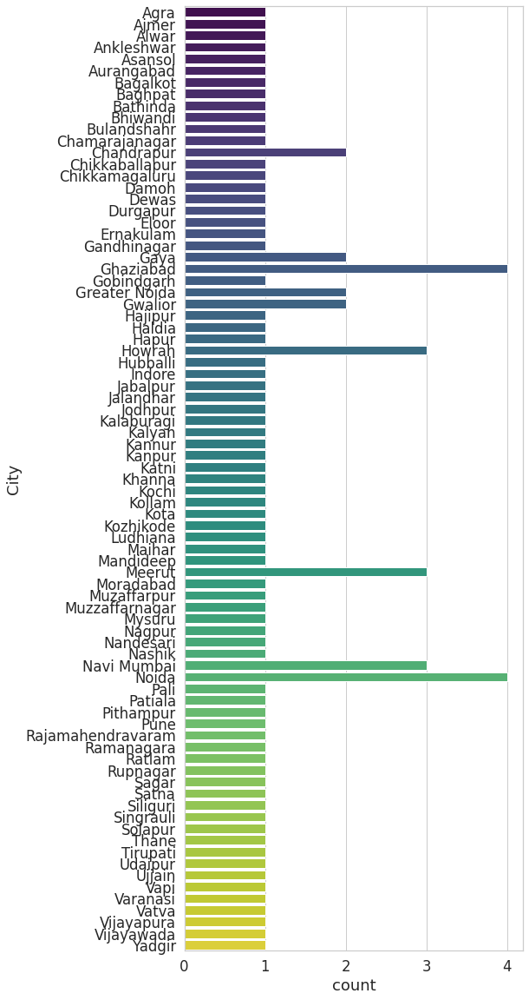

In [ ]:
print('Citywise Number of Unknown Stations')
unknown_station = dfstations[dfstations['Status']=='Unknown'].sort_values(by='City')
plt.figure(figsize=(7,20))
sns.countplot(y='City',data = unknown_station,palette='viridis')
sns.set(style="whitegrid", font_scale=1.5)

Top 5 station with number of unknown stations

In [ ]:
unknown_station['City'].value_counts().nlargest(5)

Ghaziabad      4
Noida          4
Howrah         3
Navi Mumbai    3
Meerut         3
Name: City, dtype: int64

Text(0.5, 1.0, 'Station Day')

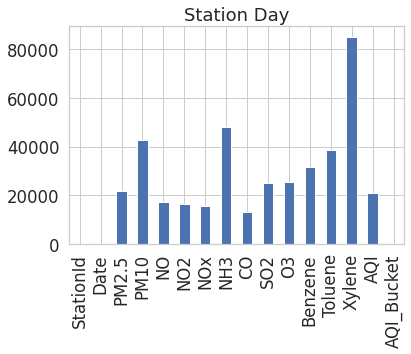

In [ ]:
dfstation_day.isnull().sum().plot(kind ='bar')
plt.title("Station Day")

Text(0.5, 1.0, 'Station Day')

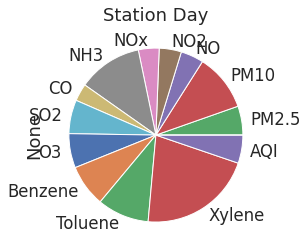

In [ ]:
dfstation_day.isnull().sum().plot(kind ='pie')
plt.title("Station Day")

## City Dataset

In [ ]:
dfcity_hour.info()
dfcity_hour.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 707875 entries, 0 to 707874
Data columns (total 16 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   City        707875 non-null  object 
 1   Datetime    707875 non-null  object 
 2   PM2.5       562787 non-null  float64
 3   PM10        411138 non-null  float64
 4   NO          591243 non-null  float64
 5   NO2         590753 non-null  float64
 6   NOx         584651 non-null  float64
 7   NH3         435333 non-null  float64
 8   CO          621358 non-null  float64
 9   SO2         577502 non-null  float64
 10  O3          578667 non-null  float64
 11  Benzene     544229 non-null  float64
 12  Toluene     487268 non-null  float64
 13  Xylene      252046 non-null  float64
 14  AQI         578795 non-null  float64
 15  AQI_Bucket  707875 non-null  object 
dtypes: float64(13), object(3)
memory usage: 86.4+ MB


,City,Datetime,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01 01:00:00,NaN,NaN,1.00,40.01,36.37,NaN,1.00,122.07,NaN,0.0,0.0,0.0,NaN,Unknown
1,Ahmedabad,2015-01-01 02:00:00,NaN,NaN,0.02,27.75,19.73,NaN,0.02,85.90,NaN,0.0,0.0,0.0,NaN,Unknown
2,Ahmedabad,2015-01-01 03:00:00,NaN,NaN,0.08,19.32,11.08,NaN,0.08,52.83,NaN,0.0,0.0,0.0,NaN,Unknown
3,Ahmedabad,2015-01-01 04:00:00,NaN,NaN,0.30,16.45,9.20,NaN,0.30,39.53,153.58,0.0,0.0,0.0,NaN,Unknown
4,Ahmedabad,2015-01-01 05:00:00,NaN,NaN,0.12,14.90,7.85,NaN,0.12,32.63,NaN,0.0,0.0,0.0,NaN,Unknown


In [ ]:
dfcity_day.info()
dfcity_day.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29531 entries, 0 to 29530
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   City        29531 non-null  object 
 1   Date        29531 non-null  object 
 2   PM2.5       24933 non-null  float64
 3   PM10        18391 non-null  float64
 4   NO          25949 non-null  float64
 5   NO2         25946 non-null  float64
 6   NOx         25346 non-null  float64
 7   NH3         19203 non-null  float64
 8   CO          27472 non-null  float64
 9   SO2         25677 non-null  float64
 10  O3          25509 non-null  float64
 11  Benzene     23908 non-null  float64
 12  Toluene     21490 non-null  float64
 13  Xylene      11422 non-null  float64
 14  AQI         24850 non-null  float64
 15  AQI_Bucket  29531 non-null  object 
dtypes: float64(13), object(3)
memory usage: 3.6+ MB


,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,Unknown
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,Unknown
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,Unknown
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,Unknown
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,Unknown


In [ ]:
dfstation = pd.merge(dfstation_day,dfstations,how = 'left')
dfstation.head()

,StationId,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket,StationName,City,State,Status
0,AP001,2017-11-24,71.36,115.75,1.75,20.65,12.40,12.19,0.10,10.76,109.26,0.17,5.92,0.10,NaN,Unknown,"Secretariat, Amaravati - APPCB",Amaravati,Andhra Pradesh,Active
1,AP001,2017-11-25,81.40,124.50,1.44,20.50,12.08,10.72,0.12,15.24,127.09,0.20,6.50,0.06,184.0,Moderate,"Secretariat, Amaravati - APPCB",Amaravati,Andhra Pradesh,Active
2,AP001,2017-11-26,78.32,129.06,1.26,26.00,14.85,10.28,0.14,26.96,117.44,0.22,7.95,0.08,197.0,Moderate,"Secretariat, Amaravati - APPCB",Amaravati,Andhra Pradesh,Active
3,AP001,2017-11-27,88.76,135.32,6.60,30.85,21.77,12.91,0.11,33.59,111.81,0.29,7.63,0.12,198.0,Moderate,"Secretariat, Amaravati - APPCB",Amaravati,Andhra Pradesh,Active
4,AP001,2017-11-28,64.18,104.09,2.56,28.07,17.01,11.42,0.09,19.00,138.18,0.17,5.02,0.07,188.0,Moderate,"Secretariat, Amaravati - APPCB",Amaravati,Andhra Pradesh,Active


In [ ]:
print(len(dfcity_day['City'].unique()),'Cities :',dfcity_day['City'].unique())

26 Cities : ['Ahmedabad' 'Aizawl' 'Amaravati' 'Amritsar' 'Bengaluru' 'Bhopal'
 'Brajrajnagar' 'Chandigarh' 'Chennai' 'Coimbatore' 'Delhi' 'Ernakulam'
 'Gurugram' 'Guwahati' 'Hyderabad' 'Jaipur' 'Jorapokhar' 'Kochi' 'Kolkata'
 'Lucknow' 'Mumbai' 'Patna' 'Shillong' 'Talcher' 'Thiruvananthapuram'
 'Visakhapatnam']


In [ ]:
print('Start date in Data : ',dfcity_day['Date'].min())
print('End Date in Data   : ',dfcity_day['Date'].max())

Start date in Data :  2015-01-01
End Date in Data   :  2020-07-01


In [ ]:
dfcity_day.describe()

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
count,24933.000000,18391.000000,25949.000000,25946.000000,25346.000000,19203.000000,27472.000000,25677.000000,25509.000000,23908.000000,21490.000000,11422.000000,24850.000000
mean,67.450578,118.127103,17.574730,28.560659,32.309123,23.483476,2.248598,14.531977,34.491430,3.280840,8.700972,3.070128,166.463581
std,64.661449,90.605110,22.785846,24.474746,31.646011,25.684275,6.962884,18.133775,21.694928,15.811136,19.969164,6.323247,140.696585
min,0.040000,0.010000,0.020000,0.010000,0.000000,0.010000,0.000000,0.010000,0.010000,0.000000,0.000000,0.000000,13.000000
25%,28.820000,56.255000,5.630000,11.750000,12.820000,8.580000,0.510000,5.670000,18.860000,0.120000,0.600000,0.140000,81.000000
50%,48.570000,95.680000,9.890000,21.690000,23.520000,15.850000,0.890000,9.160000,30.840000,1.070000,2.970000,0.980000,118.000000
75%,80.590000,149.745000,19.950000,37.620000,40.127500,30.020000,1.450000,15.220000,45.570000,3.080000,9.150000,3.350000,208.000000
max,949.990000,1000.000000,390.680000,362.210000,467.630000,352.890000,175.810000,193.860000,257.730000,455.030000,454.850000,170.370000,2049.000000


### Fill Missing Data

In [ ]:
dfcity_day.interpolate(limit_direction="both",inplace=True)
dfcity_day.isnull().sum()

City          0
Date          0
PM2.5         0
PM10          0
NO            0
NO2           0
NOx           0
NH3           0
CO            0
SO2           0
O3            0
Benzene       0
Toluene       0
Xylene        0
AQI           0
AQI_Bucket    0
dtype: int64

### City Wise Yearly Average Polution data

Mumbai Yearly Average Polution data

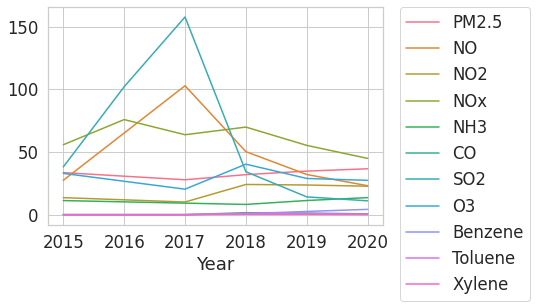

In [ ]:
df_Mumbai = dfcity_day[dfcity_day['City'] == 'Mumbai']
df_Mumbai['Year'] = pd.DatetimeIndex(df_Mumbai['Date']).year
df_Mumbai['Month'] = pd.DatetimeIndex(df_Mumbai['Date']).month
sns.lineplot(data = df_Mumbai.groupby('Year').mean().drop(['AQI','Month','PM10'],axis=1),dashes=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

Ahmedabad Yearly Average Polution data

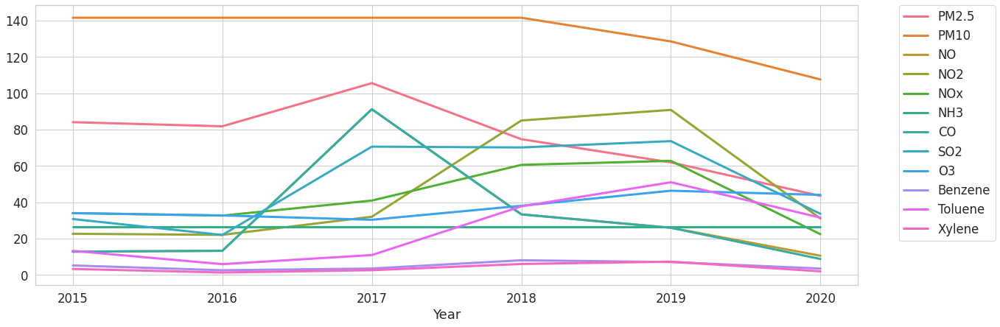

In [ ]:
plt.rcParams['figure.figsize'] = [20,7];
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

df_Ahmedabad = dfcity_day[dfcity_day['City'] == 'Ahmedabad']
df_Ahmedabad['Year'] = pd.DatetimeIndex(df_Ahmedabad['Date']).year
df_Ahmedabad['Month'] = pd.DatetimeIndex(df_Ahmedabad['Date']).month
sns.lineplot(data = df_Ahmedabad.groupby('Year').mean().drop(['AQI','Month'],axis=1),dashes=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

Delhi Yearly Average Polution data

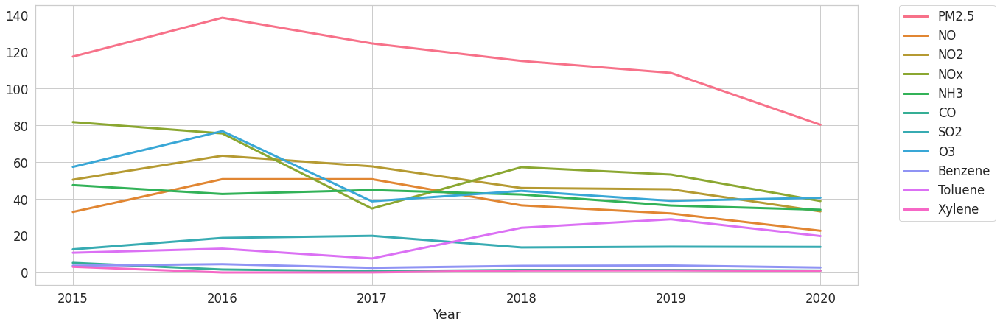

In [ ]:
df_Delhi = dfcity_day[dfcity_day['City'] == 'Delhi']
df_Delhi['Year'] = pd.DatetimeIndex(df_Delhi['Date']).year
df_Delhi['Month'] = pd.DatetimeIndex(df_Delhi['Date']).month
sns.lineplot(data = df_Delhi.groupby('Year').mean().drop(['AQI','Month','PM10'],axis=1),dashes=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

 Bengaluru Yearly Average Polution data

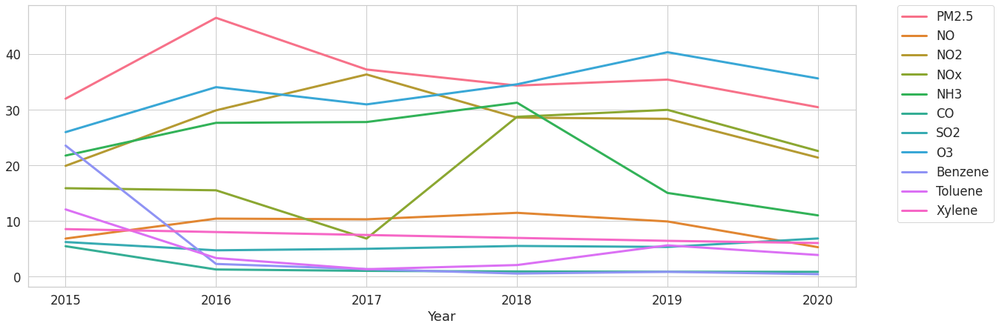

In [ ]:
df_Bengaluru = dfcity_day[dfcity_day['City'] == 'Bengaluru']
df_Bengaluru['Year'] = pd.DatetimeIndex(df_Bengaluru['Date']).year
df_Bengaluru['Month'] = pd.DatetimeIndex(df_Bengaluru['Date']).month
sns.lineplot(data = df_Bengaluru.groupby('Year').mean().drop(['AQI','Month','PM10'],axis=1),dashes=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

Kolkata Yearly Average Polution data

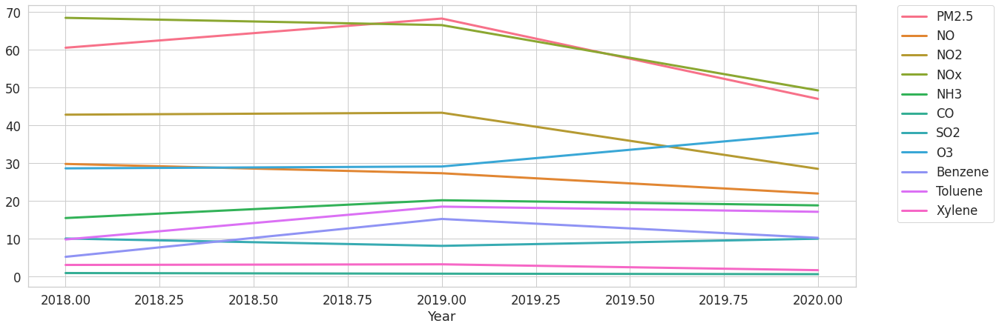

In [ ]:
df_Kolkata = dfcity_day[dfcity_day['City'] == 'Kolkata']
df_Kolkata['Year'] = pd.DatetimeIndex(df_Kolkata['Date']).year
df_Kolkata['Month'] = pd.DatetimeIndex(df_Kolkata['Date']).month
sns.lineplot(data = df_Kolkata.groupby('Year').mean().drop(['AQI','Month','PM10'],axis=1),dashes=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

Chennai Yearly Average Polution data


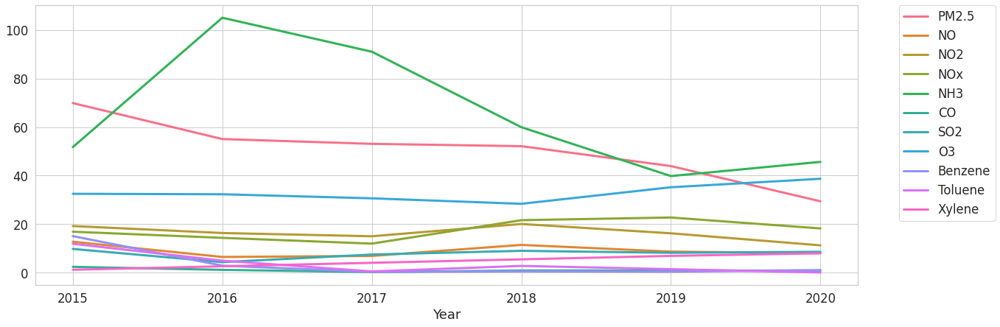

In [ ]:
df_Chennai = dfcity_day[dfcity_day['City'] == 'Chennai']
df_Chennai['Year'] = pd.DatetimeIndex(df_Chennai['Date']).year
df_Chennai['Month'] = pd.DatetimeIndex(df_Chennai['Date']).month
sns.lineplot(data = df_Chennai.groupby('Year').mean().drop(['AQI','Month','PM10'],axis=1),dashes=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

### CO levels across 12 months

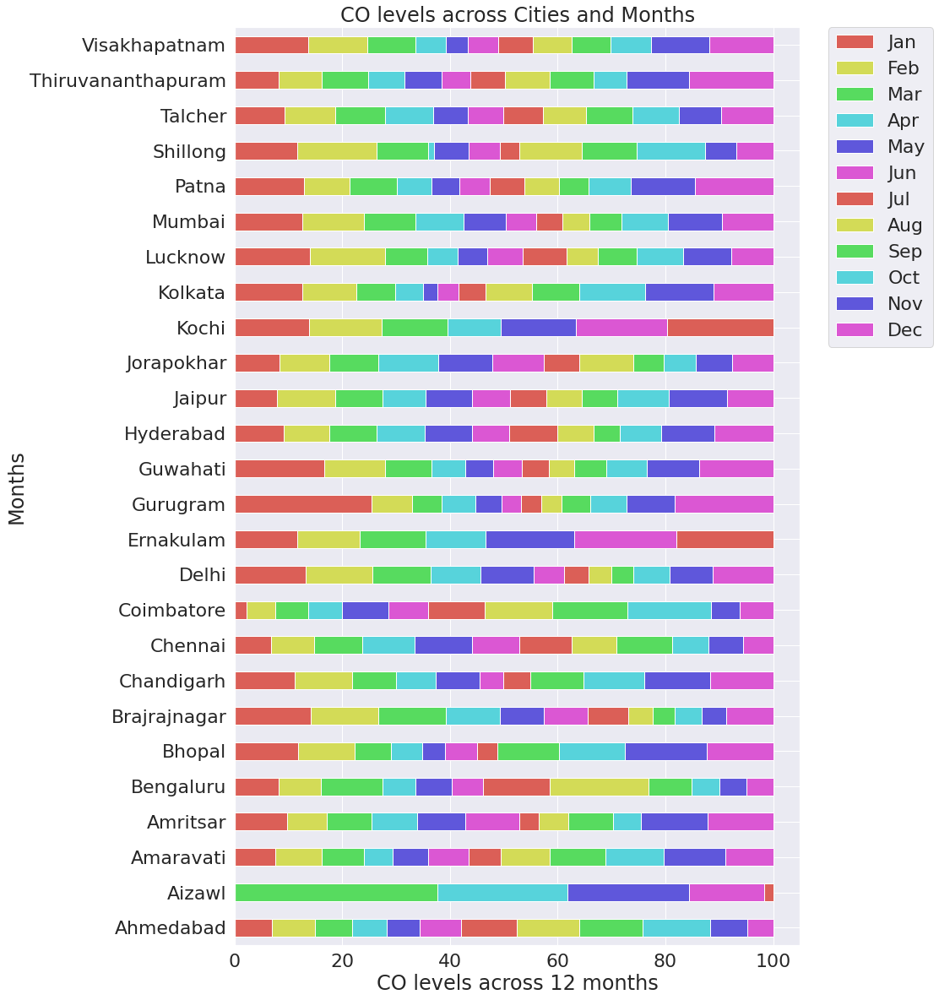

In [ ]:
plt.rcParams['figure.figsize'] = (12, 20);
sns.set(palette='hls')
sns.set_context("notebook", font_scale=2, rc={"lines.linewidth": 3})

dfcity_day['Month'] = pd.DatetimeIndex(dfcity_day['Date']).month
df_city_month_pivot_table = dfcity_day.fillna(0).sort_values(by=['City'], ascending=False) \
                                .pivot_table(values='CO', index='City', columns='Month', aggfunc=np.mean).fillna(0)
df_city_month_pivot_table = df_city_month_pivot_table.apply(lambda x: x*100/sum(x), axis=1)

df_city_month_pivot_table.rename(columns={1:'Jan' ,2:'Feb' ,3:'Mar' ,4:'Apr' ,5:'May' ,6:'Jun',7:'Jul' ,8:'Aug' ,9:'Sep' ,10:'Oct' ,11:'Nov' ,12:'Dec'},inplace = True)

ax = df_city_month_pivot_table.plot(kind='barh', stacked=True, title='CO levels across Cities and Months')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Months');
ax.set_xlabel('CO levels across 12 months');


### PM2.5 levels across 12 months

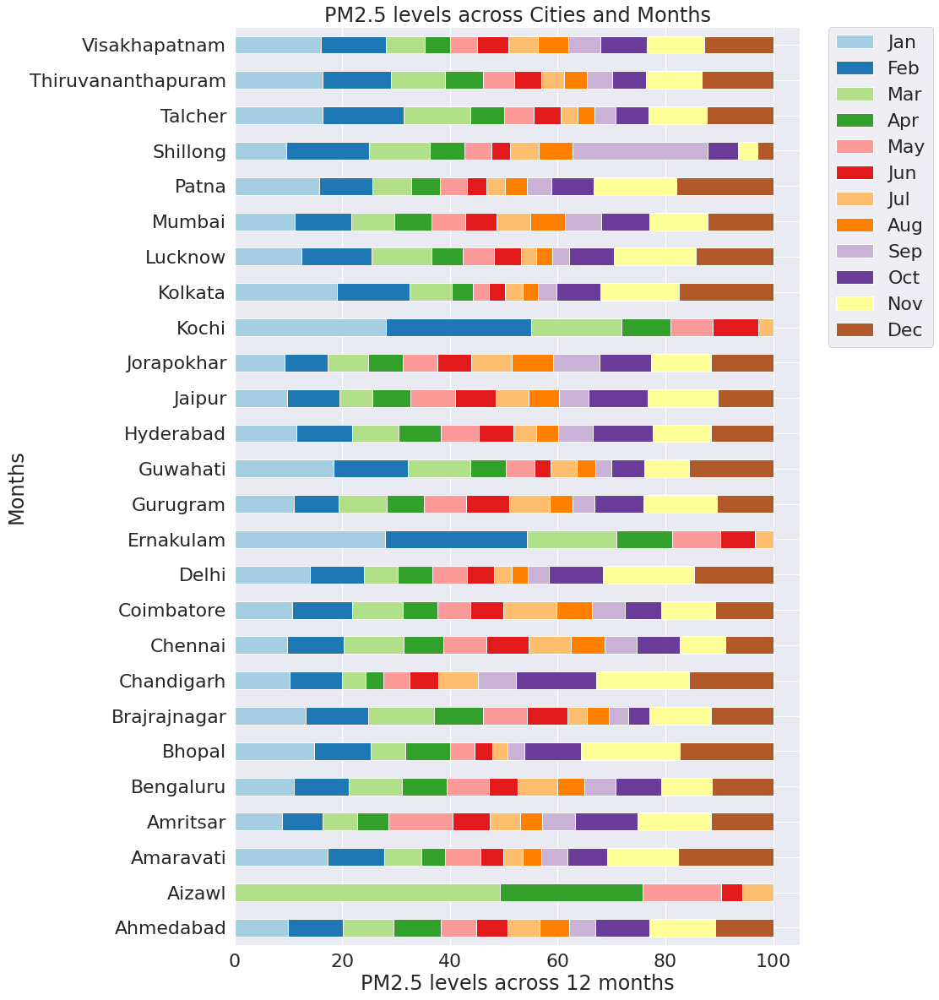

In [ ]:
plt.rcParams['figure.figsize'] = (12, 20);
sns.set(palette='Paired')
sns.set_context("notebook", font_scale=2, rc={"lines.linewidth": 3})

dfcity_day['Month'] = pd.DatetimeIndex(dfcity_day['Date']).month
df_city_month_pivot_table = dfcity_day.fillna(0).sort_values(by=['City'], ascending=False) \
                                .pivot_table(values='PM2.5', index='City', columns='Month', aggfunc=np.mean).fillna(0)
df_city_month_pivot_table = df_city_month_pivot_table.apply(lambda x: x*100/sum(x), axis=1)

df_city_month_pivot_table.rename(columns={1:'Jan' ,2:'Feb' ,3:'Mar' ,4:'Apr' ,5:'May' ,6:'Jun',7:'Jul' ,8:'Aug' ,9:'Sep' ,10:'Oct' ,11:'Nov' ,12:'Dec'},inplace = True)

ax = df_city_month_pivot_table.plot(kind='barh', stacked=True, title='PM2.5 levels across Cities and Months',grid=True)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Months');
ax.set_xlabel('PM2.5 levels across 12 months');

### AQI Bucket and Cities

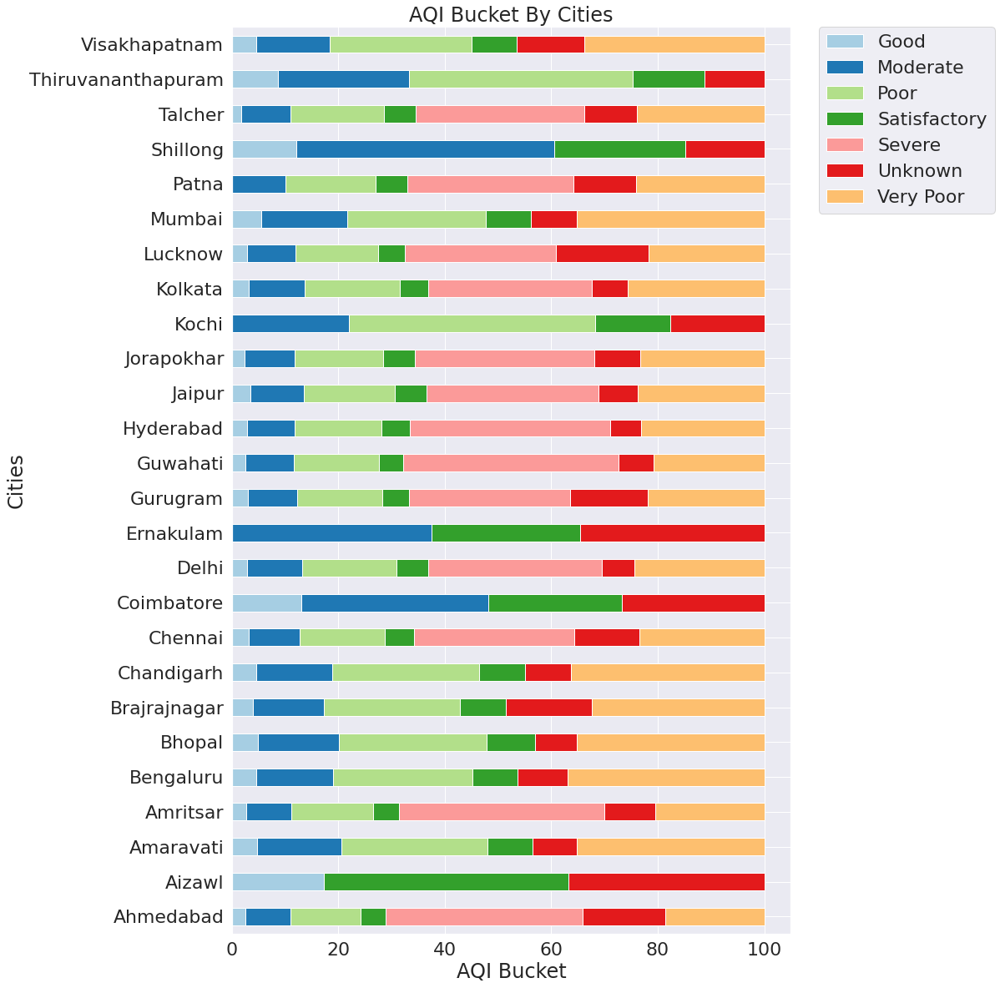

In [ ]:
df_city_month_pivot_table = dfcity_day.fillna(0).sort_values(by=['AQI', 'AQI_Bucket'], ascending=False).pivot_table(values='AQI', index='City', columns='AQI_Bucket', aggfunc=np.mean).fillna(0)
plt.rcParams['figure.figsize'] = (12, 20)
ax = df_city_month_pivot_table.apply(lambda x: x*100/sum(x), axis=1).plot(kind='barh', stacked=True, title='AQI Bucket By Cities')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Cities');
ax.set_xlabel('AQI Bucket');

### AQ Acceptability and Cities: listed by Acceptable AQ


In [ ]:
def AQ_acceptability(aqi_bucket):
    results = []
    for each_aqi_bucket in aqi_bucket.values:
        result = "Acceptable" if each_aqi_bucket in ["Good", "Satisfactory"] else "Unacceptable"
        results.append(result)
    return results

dfcity_day['AQ_acceptability'] = AQ_acceptability(dfcity_day['AQI_Bucket'])

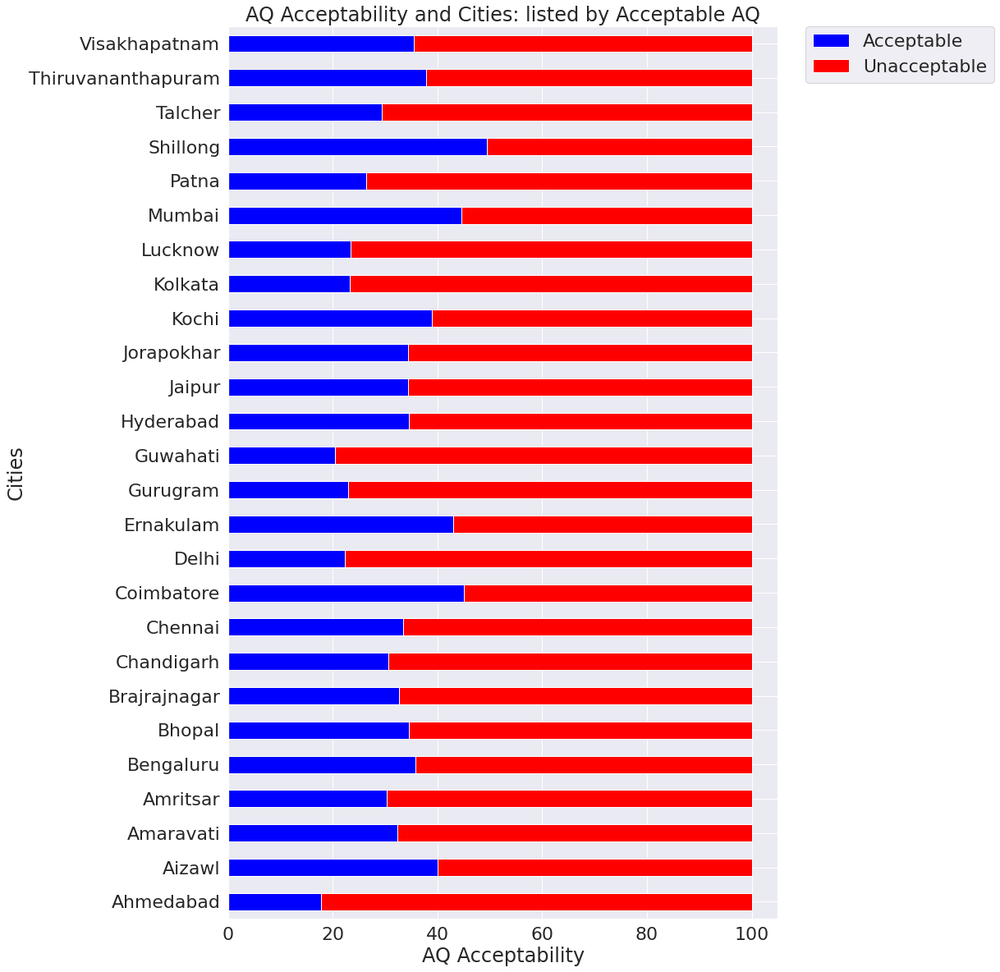

In [ ]:
df_city_month_pivot_table = dfcity_day.fillna(0).sort_values(by=['AQI', 'AQ_acceptability'], ascending=False).pivot_table(values='AQI', index='City', columns='AQ_acceptability', aggfunc=np.mean).fillna(0)
plt.rcParams['figure.figsize'] = (12, 20)
ax = df_city_month_pivot_table.apply(lambda x: x*100/sum(x), axis=1).plot(kind='barh', stacked=True, title='AQ Acceptability and Cities: listed by Acceptable AQ',colormap='bwr')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Cities');
ax.set_xlabel('AQ Acceptability');

### Weekday vs Weekend Polution

In [ ]:
dfcity_day['Day'] = pd.to_datetime(dfcity_day['Date']).dt.day_name()
cats = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

Mumbai Day Wise Pollution

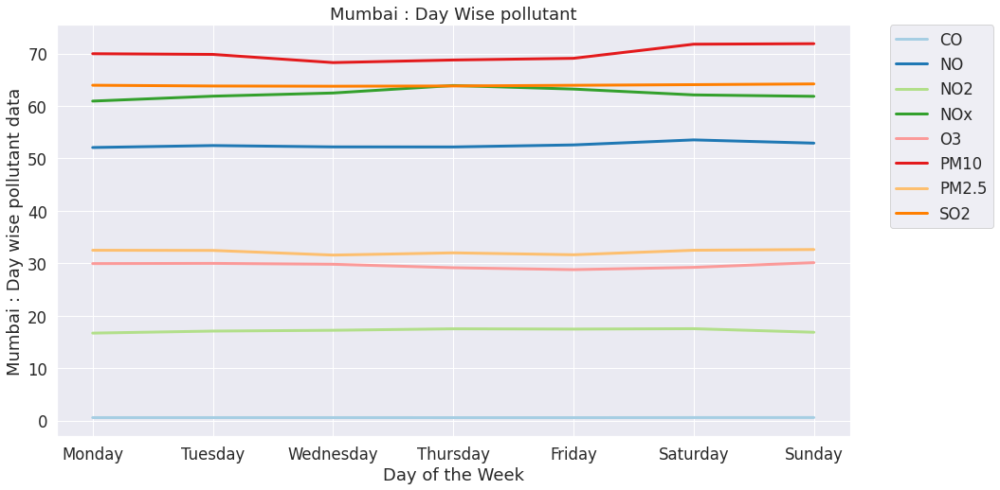

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfMumbai = dfcity_day[dfcity_day['City'] == 'Mumbai']
ax = dfMumbai.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Mumbai : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Mumbai : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Ahmedabad Day Wise Pollution

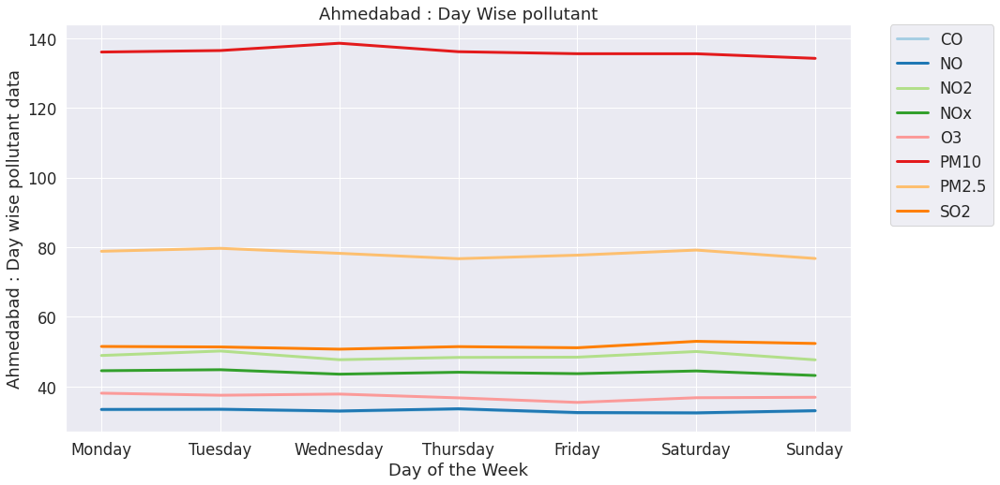

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfAhmedabad = dfcity_day[dfcity_day['City'] == 'Ahmedabad']
ax = dfAhmedabad.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Ahmedabad : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Ahmedabad : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Delhi Day Wise Pollution

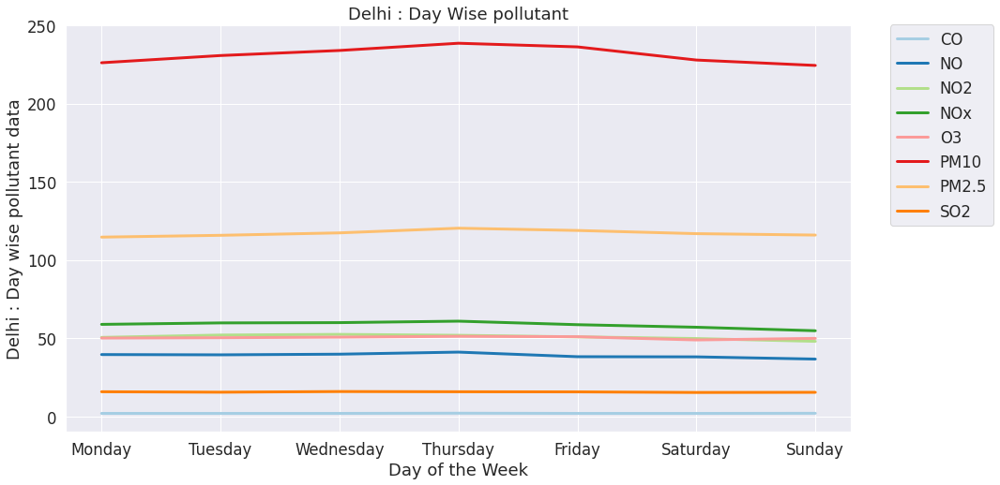

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfDelhi = dfcity_day[dfcity_day['City'] == 'Delhi']
ax = dfDelhi.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Delhi : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Delhi : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Bengaluru Day Wise Pollution

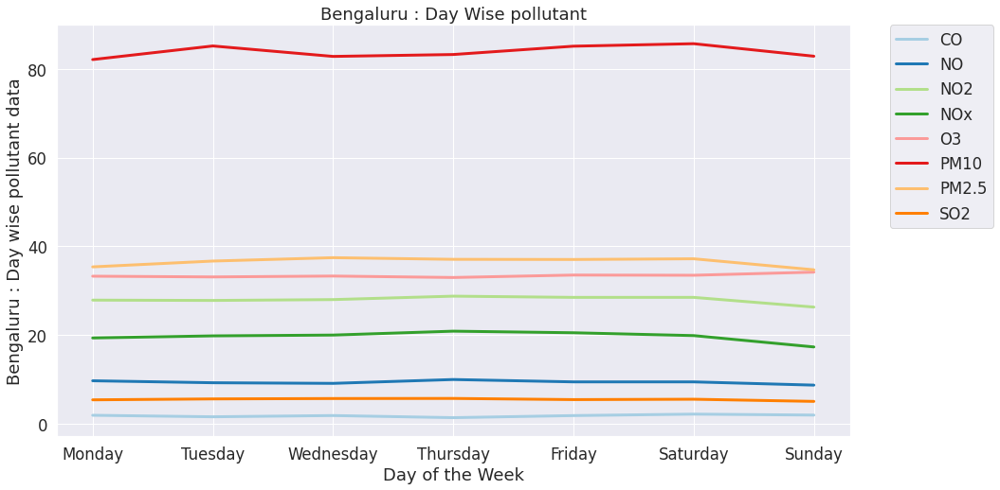

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfBengaluru = dfcity_day[dfcity_day['City'] == 'Bengaluru']
ax = dfBengaluru.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Bengaluru : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

ax.set_ylabel('Bengaluru : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Chennai Day Wise Pollution

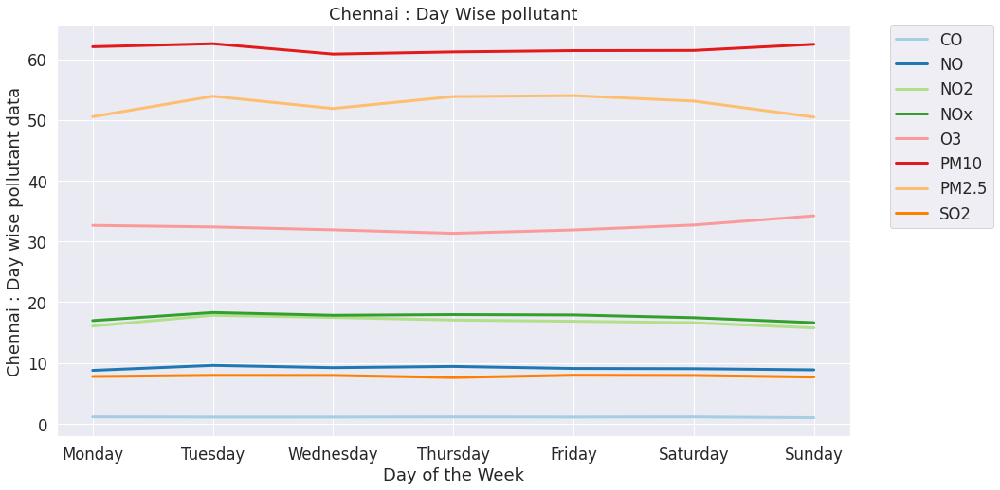

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfChennai = dfcity_day[dfcity_day['City'] == 'Chennai']
ax = dfChennai.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Chennai : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Chennai : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Aizawl Day Wise Pollution

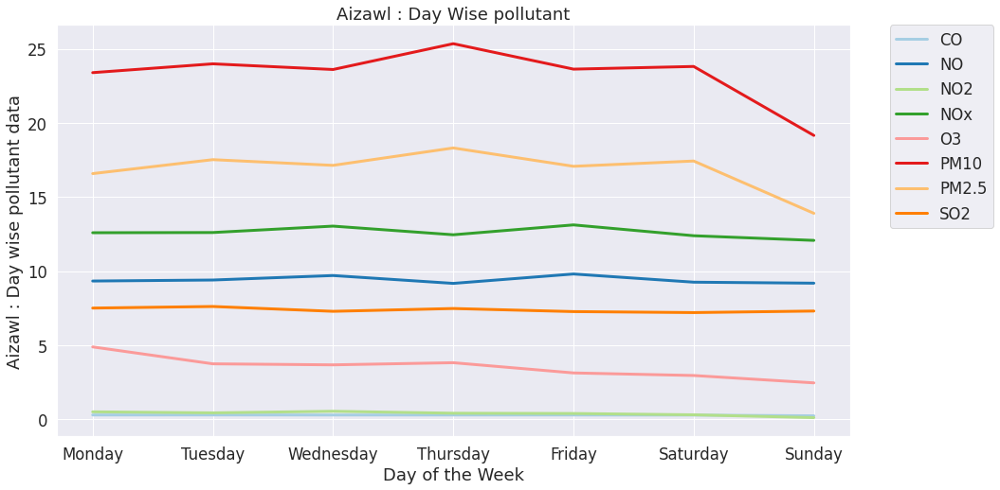

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfAizawl = dfcity_day[dfcity_day['City'] == 'Aizawl']
ax = dfAizawl.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Aizawl : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

ax.set_ylabel('Aizawl : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Hyderabad Day Wise Pollution

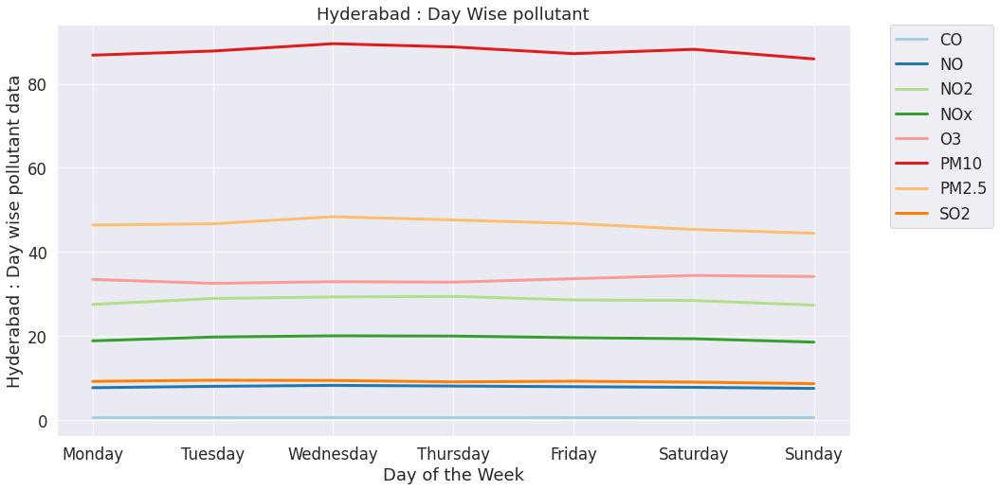

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfHyderabad = dfcity_day[dfcity_day['City'] == 'Hyderabad']
ax = dfHyderabad.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Hyderabad : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Hyderabad : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Amaravati Day Wise Pollution

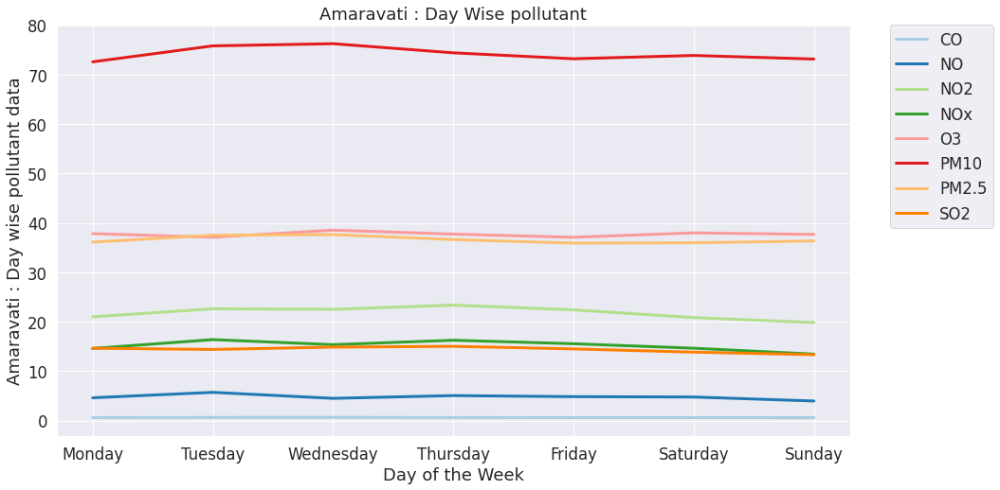

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfAmaravati = dfcity_day[dfcity_day['City'] == 'Amaravati']
ax = dfAmaravati.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Amaravati : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Amaravati : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Amritsar Day Wise Pollution

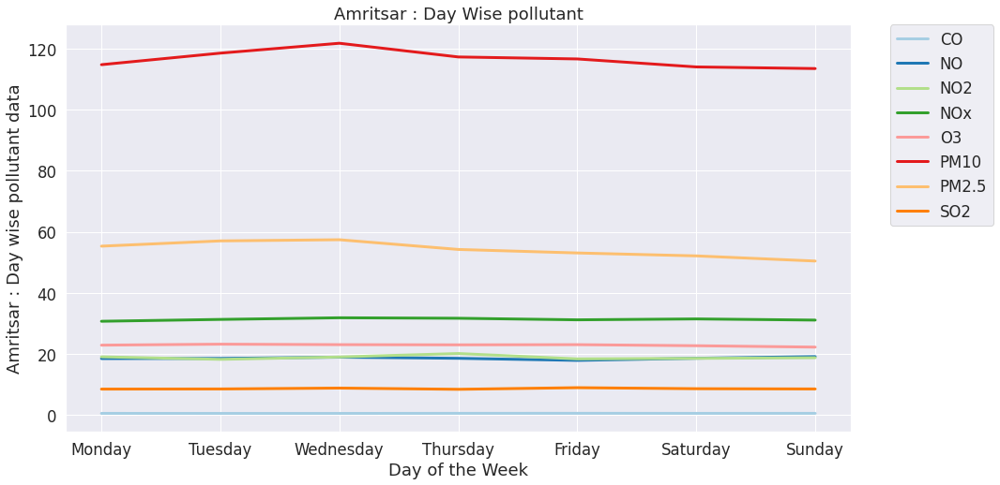

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfAmritsar = dfcity_day[dfcity_day['City'] == 'Amritsar']
ax = dfAmritsar.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Amritsar : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Amritsar : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Bhopal Day Wise Pollution

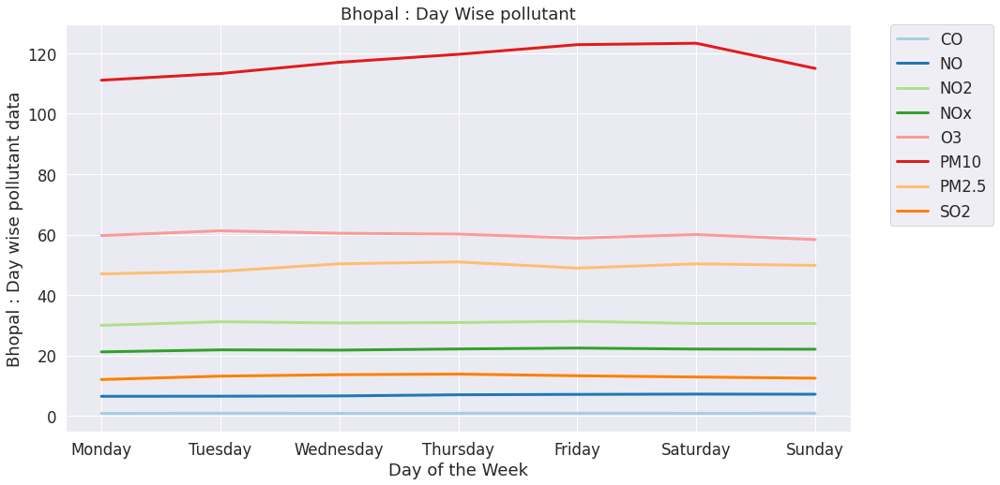

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfBhopal = dfcity_day[dfcity_day['City'] == 'Bhopal']
ax = dfBhopal.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Bhopal : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Bhopal : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Chandigarh Day Wise Pollution

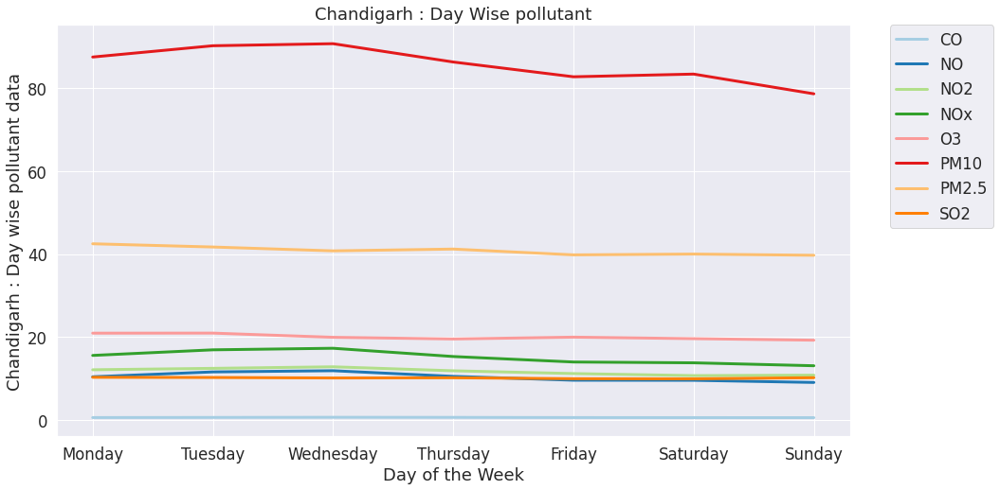

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfChandigarh = dfcity_day[dfcity_day['City'] == 'Chandigarh']
ax = dfChandigarh.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Chandigarh : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Chandigarh : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Coimbatore Day Wise Pollution

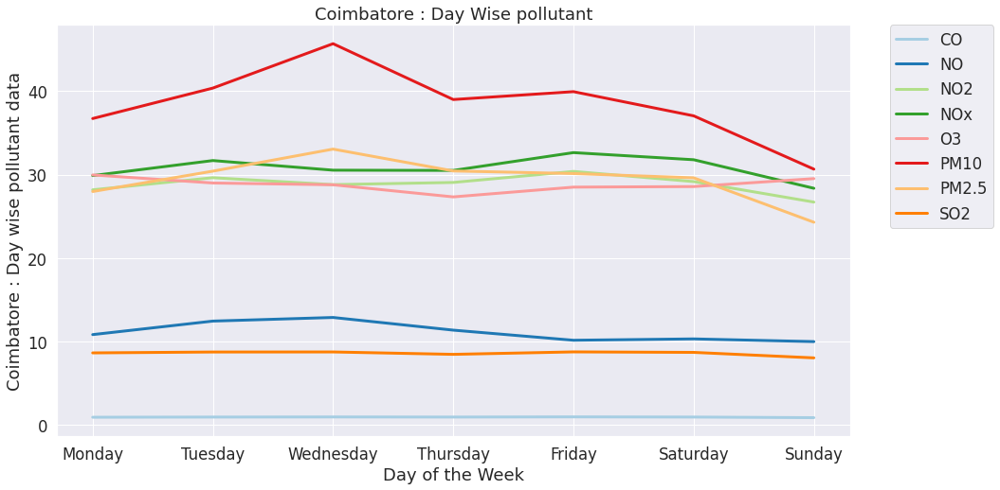

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfCoimbatore = dfcity_day[dfcity_day['City'] == 'Coimbatore']
ax = dfCoimbatore.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Coimbatore : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Coimbatore : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Ernakulam Day Wise Pollution

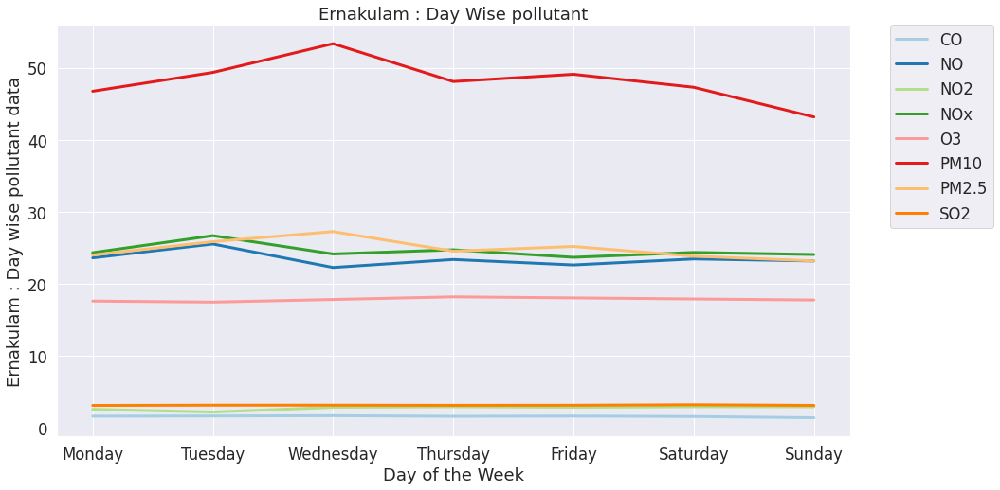

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfErnakulam = dfcity_day[dfcity_day['City'] == 'Ernakulam']
ax = dfErnakulam.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Ernakulam : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Ernakulam : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Gurugram Day WIse Pollution

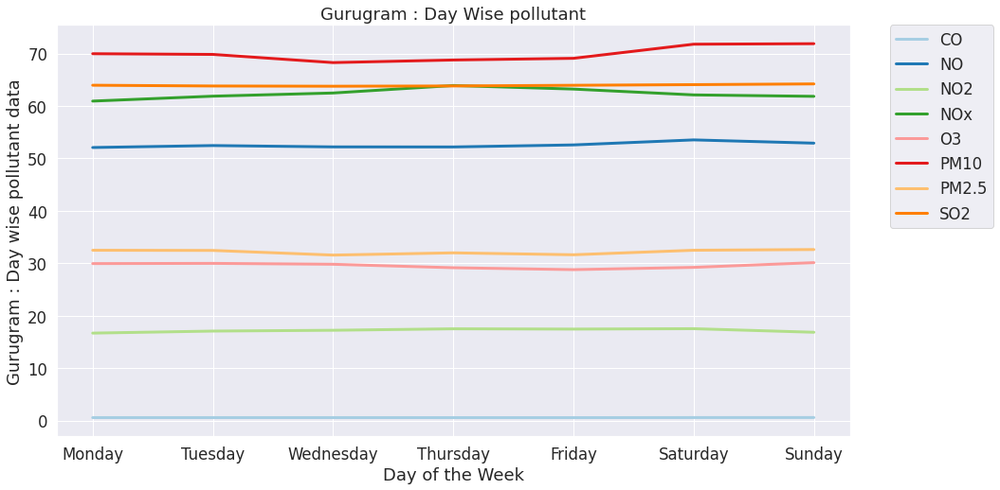

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfGurugram = dfcity_day[dfcity_day['City'] == 'Mumbai']
ax = dfGurugram.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Gurugram : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Gurugram : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Guwahati Day Wise Pollution

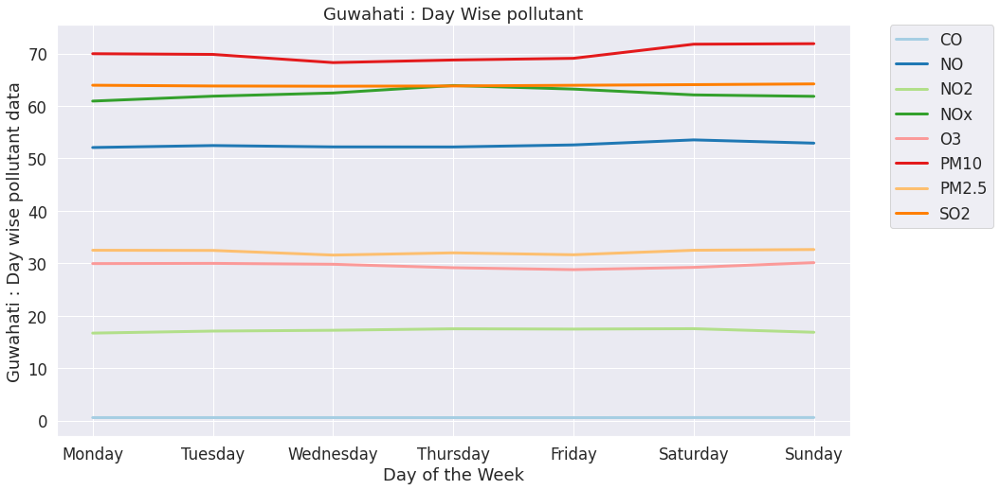

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfGuwahati = dfcity_day[dfcity_day['City'] == 'Mumbai']
ax = dfGuwahati.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Guwahati : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Guwahati : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Jaipur day Wise pollution

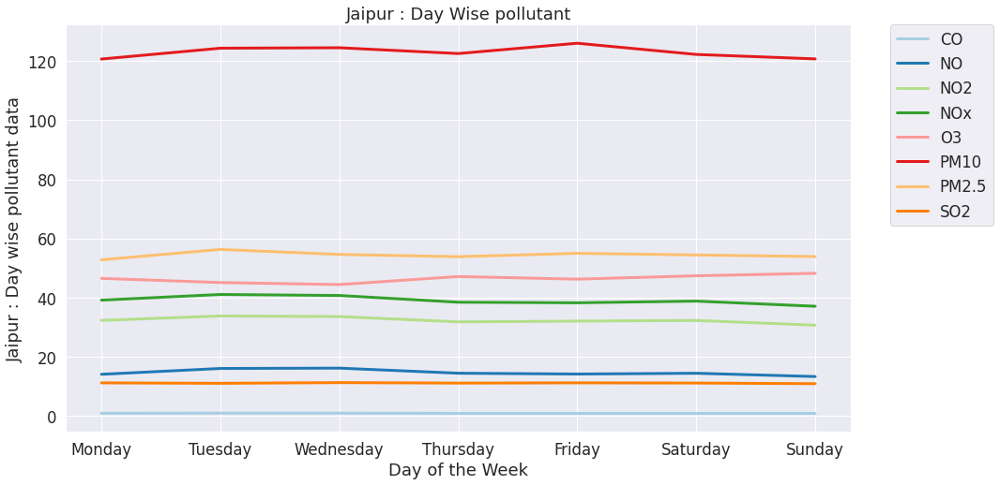

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfJaipur = dfcity_day[dfcity_day['City'] == 'Jaipur']
ax = dfJaipur.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Jaipur : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Jaipur : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Kochi Day Wise Pollution

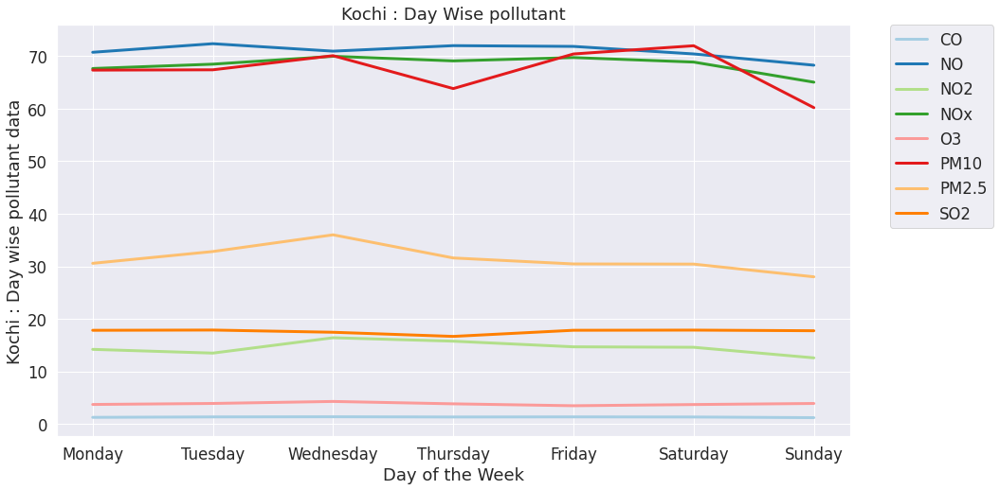

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfKochi = dfcity_day[dfcity_day['City'] == 'Kochi']
ax = dfKochi.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Kochi : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Kochi : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Kolkata Day Wise Pollution

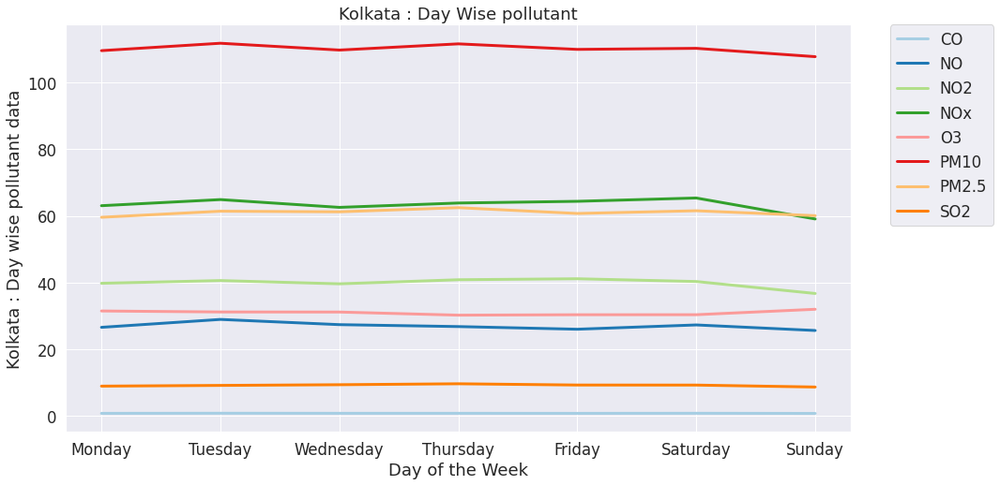

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfKolkata = dfcity_day[dfcity_day['City'] == 'Kolkata']
ax = dfKolkata.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Kolkata : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Kolkata : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Lucknow Day Wise Pollution

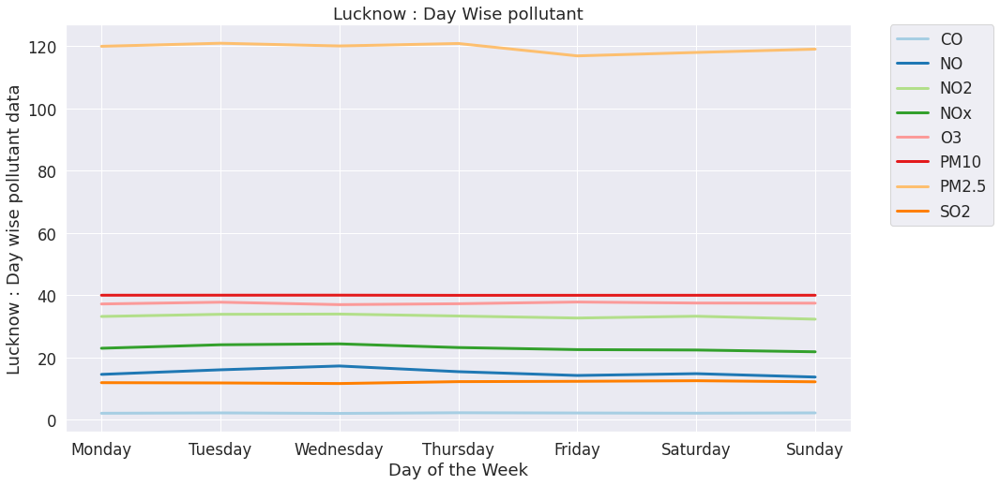

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfLucknow = dfcity_day[dfcity_day['City'] == 'Lucknow']
ax = dfLucknow.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Lucknow : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Lucknow : Day wise pollutant data');
ax.set_xlabel('Day of the Week');


Patna Day Wise Pollution

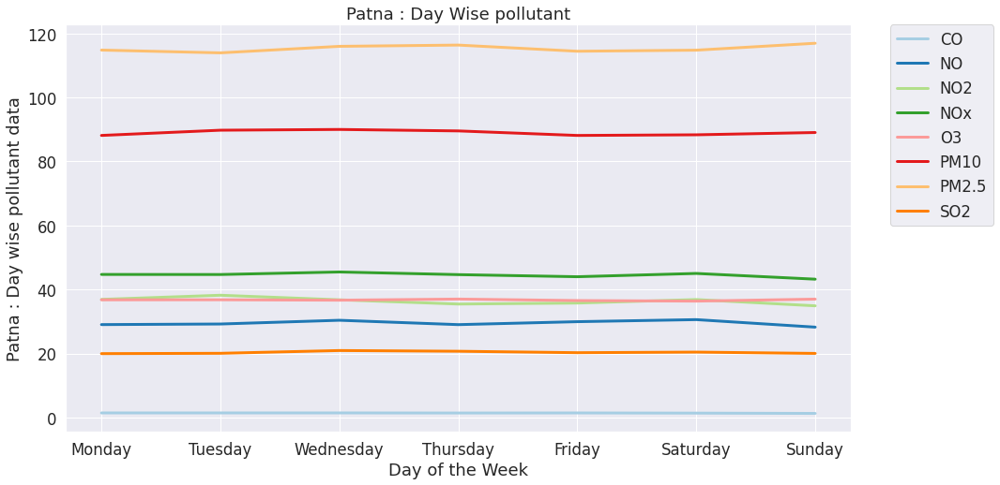

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfPatna = dfcity_day[dfcity_day['City'] == 'Patna']
ax = dfPatna.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Patna : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Patna : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Shillong Day Wise Pollution

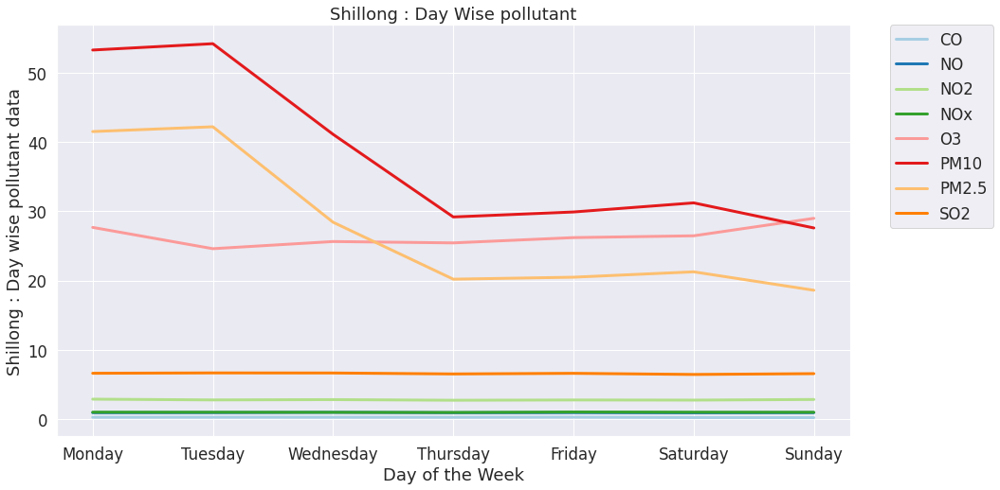

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfShillong = dfcity_day[dfcity_day['City'] == 'Shillong']
ax = dfShillong.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Shillong : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Shillong : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Talcher Day Wise Pollution

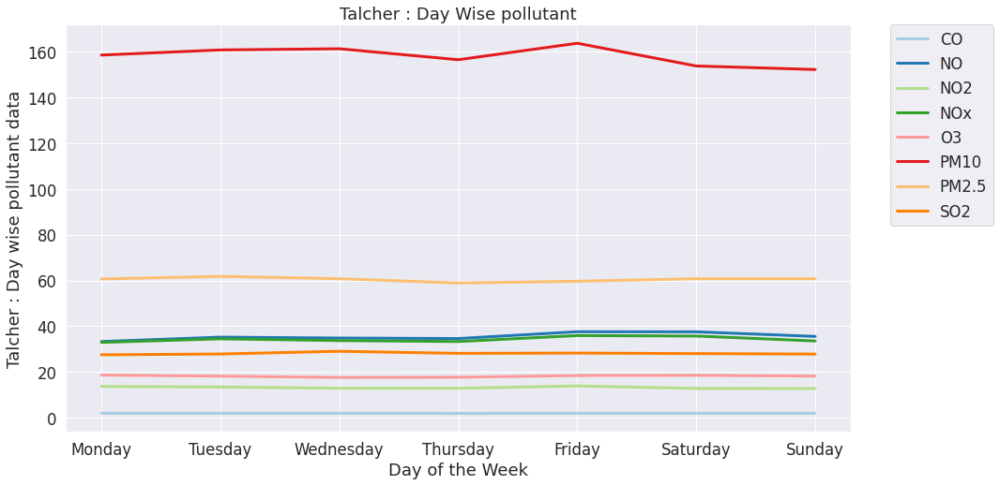

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfTalcher = dfcity_day[dfcity_day['City'] == 'Talcher']
ax = dfTalcher.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Talcher : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Talcher : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Thiruvananthapuram Day Wise Pollution

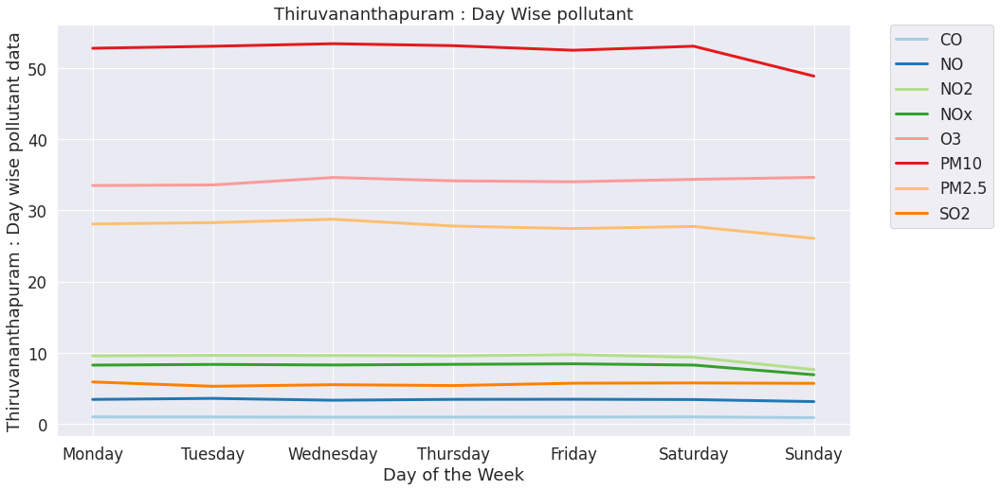

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfThiruvananthapuram = dfcity_day[dfcity_day['City'] == 'Thiruvananthapuram']
ax = dfThiruvananthapuram.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Thiruvananthapuram : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Thiruvananthapuram : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

Visakhapatnam Day Wise Pollution

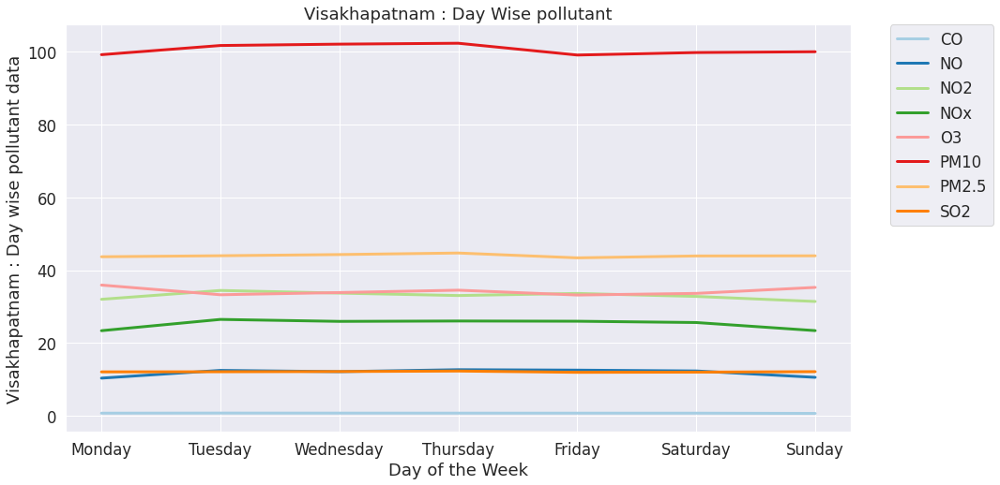

In [ ]:
plt.rcParams['figure.figsize'] = (15, 8);                                 
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3})

dfVisakhapatnam = dfcity_day[dfcity_day['City'] == 'Visakhapatnam']
ax = dfVisakhapatnam.groupby('Day').mean().reindex(cats).drop('AQI',axis=1).plot(kind = 'line',y=['CO', 'NO', 'NO2', 'NOx', 'O3', 'PM10', 'PM2.5','SO2'],title = 'Visakhapatnam : Day Wise pollutant')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);
ax.set_ylabel('Visakhapatnam : Day wise pollutant data');
ax.set_xlabel('Day of the Week');

### COVID-19 Effect : January 2020 and April 2020 'CO' Data Check

In [ ]:
df_CO = dfcity_day.pivot(index='Date', columns='City', values='CO')
df_CO = df_CO.fillna(df_CO.mean())
dfCO_Apr2020 = df_CO.loc['2020-04-01':'2020-04-30']
dfCO_Jan2020 = df_CO.loc['2020-01-01':'2020-01-30']

Mumbai CO Data

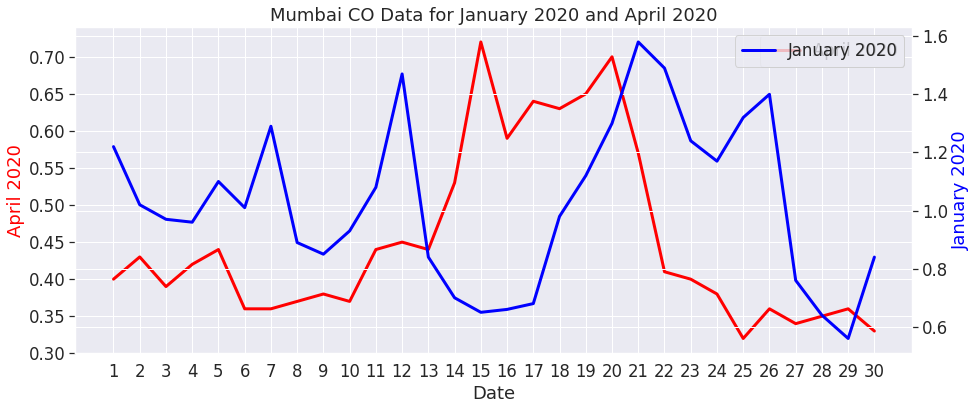

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Mumbai'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai CO Data for January 2020 and April 2020');

Ahmedabad CO Data

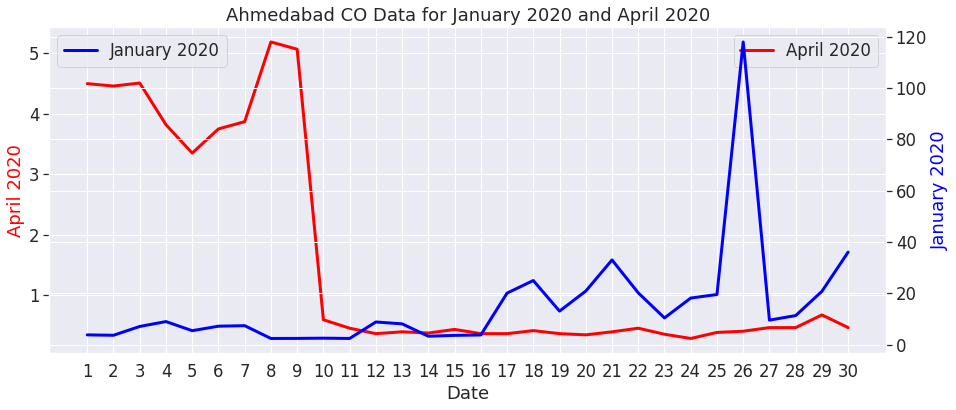

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad CO Data for January 2020 and April 2020');

Aizawl CO Data

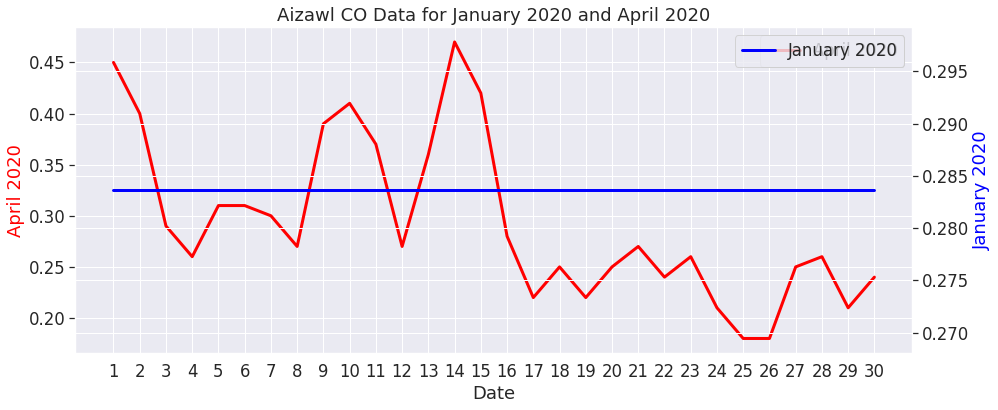

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Aizawl'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl CO Data for January 2020 and April 2020');

Amaravati CO Data

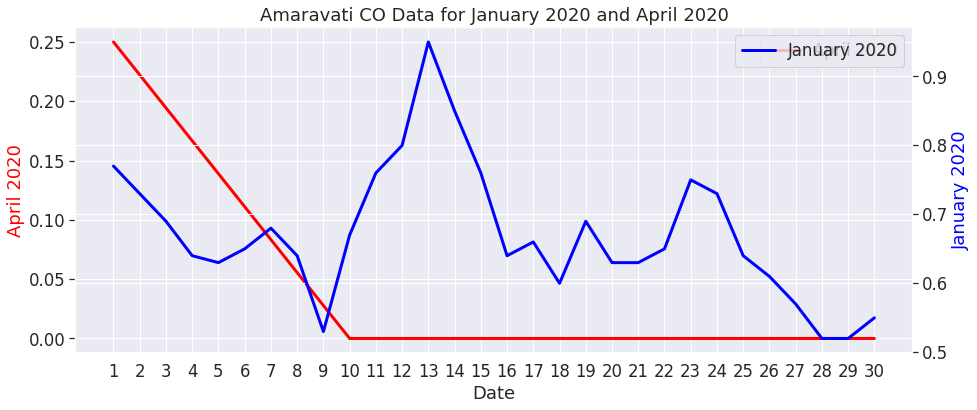

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Amaravati'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati CO Data for January 2020 and April 2020');

Amritsar CO Data

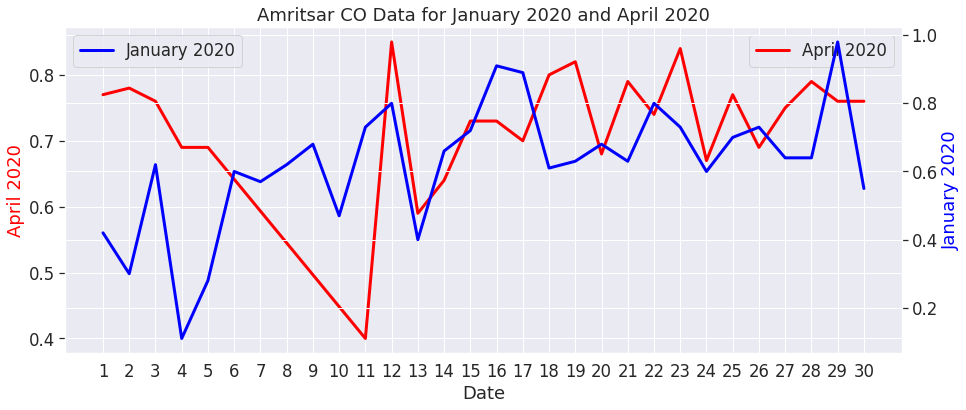

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Amritsar'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar CO Data for January 2020 and April 2020');

Bengaluru CO Data

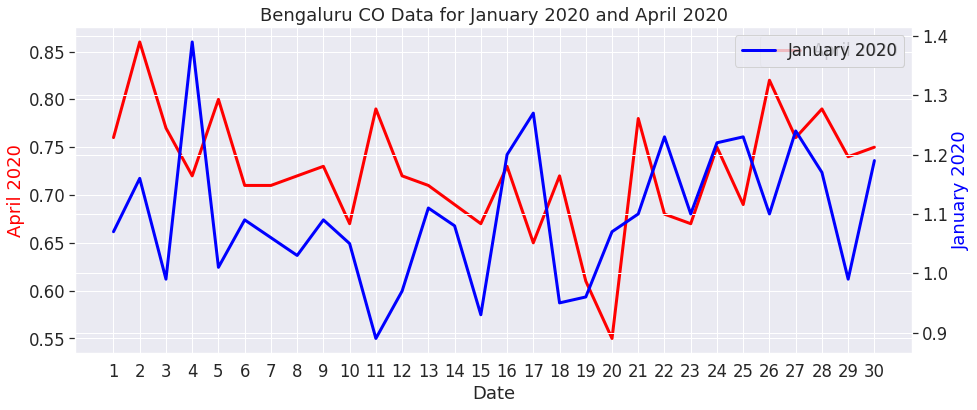

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Bengaluru'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru CO Data for January 2020 and April 2020');

Bhopal CO Data

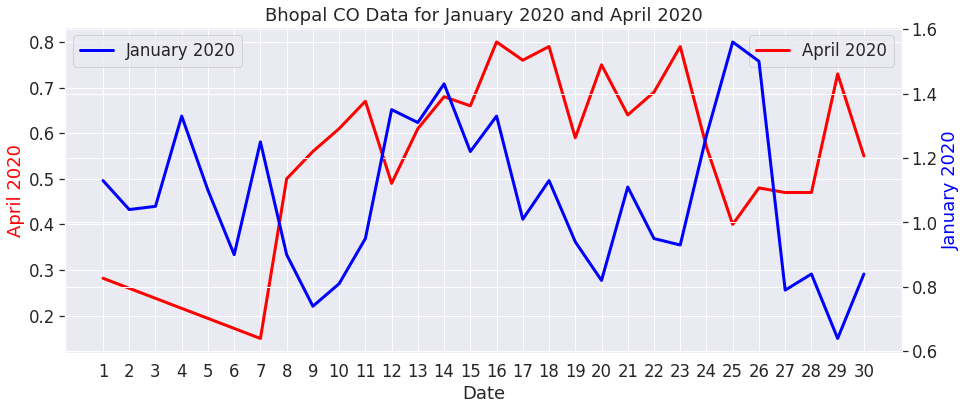

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Bhopal'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal CO Data for January 2020 and April 2020');

Chandigarh CO Data

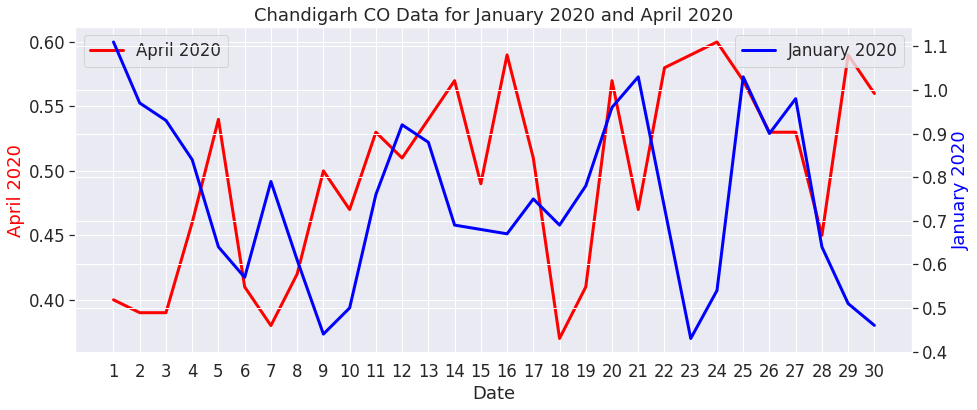

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Chandigarh'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh CO Data for January 2020 and April 2020');

Chennai CO Data

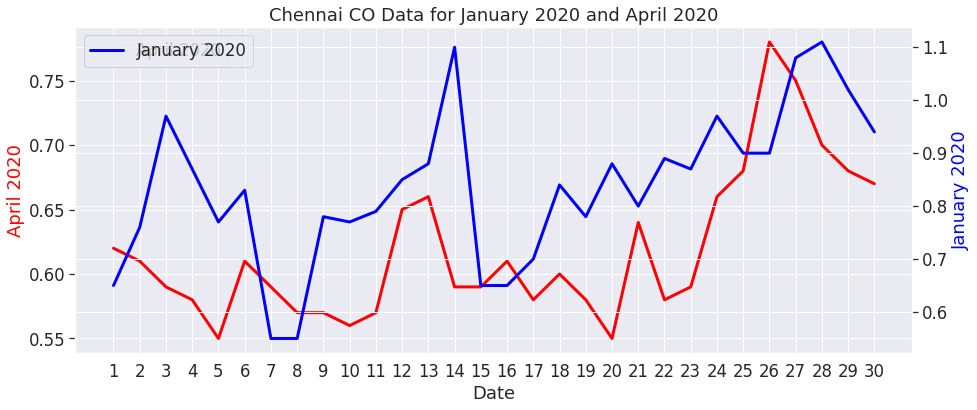

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Chennai'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai CO Data for January 2020 and April 2020');

Coimbatore CO Data

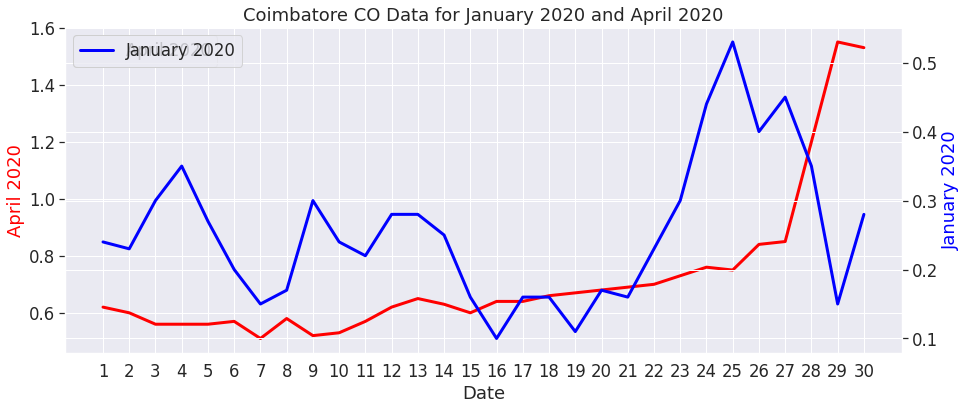

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Coimbatore'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore CO Data for January 2020 and April 2020');

Delhi CO Data

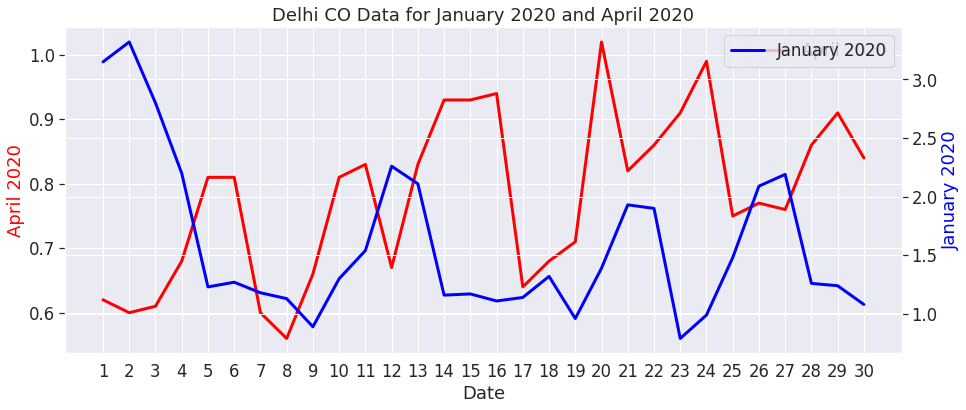

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Delhi'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi CO Data for January 2020 and April 2020');

Gurugram CO Data

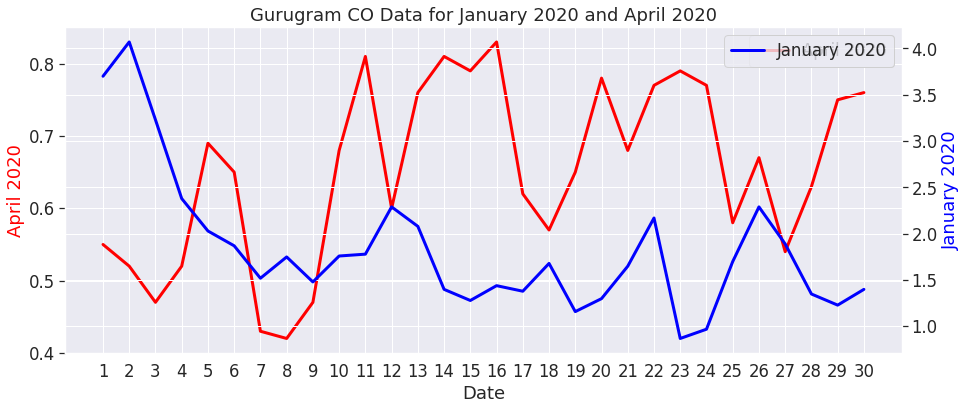

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Gurugram'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram CO Data for January 2020 and April 2020');

Hyderabad CO Data

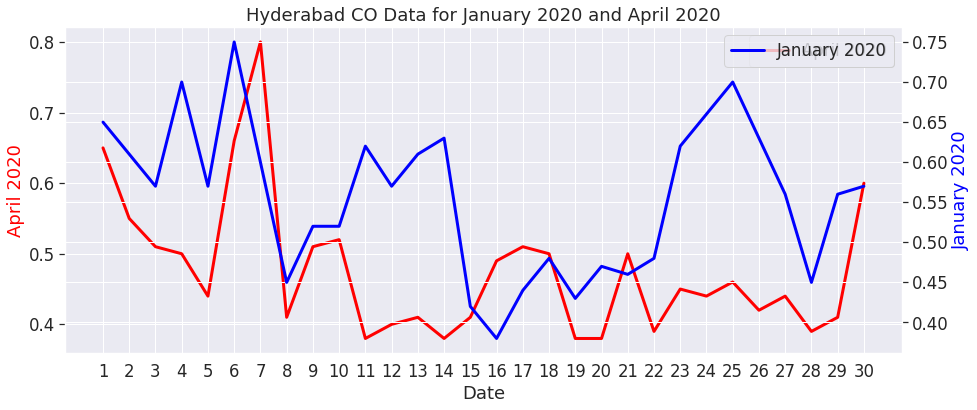

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Hyderabad'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Hyderabad'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad CO Data for January 2020 and April 2020');

Jaipur CO Data

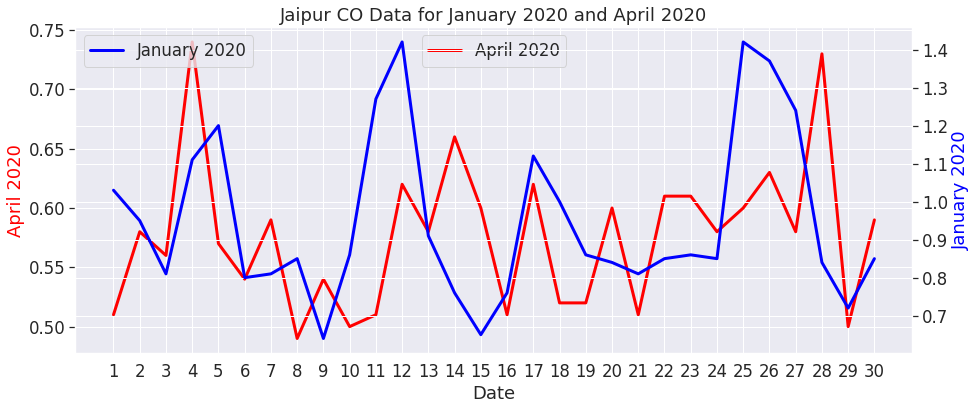

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Jaipur'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur CO Data for January 2020 and April 2020');

Kochi CO Data

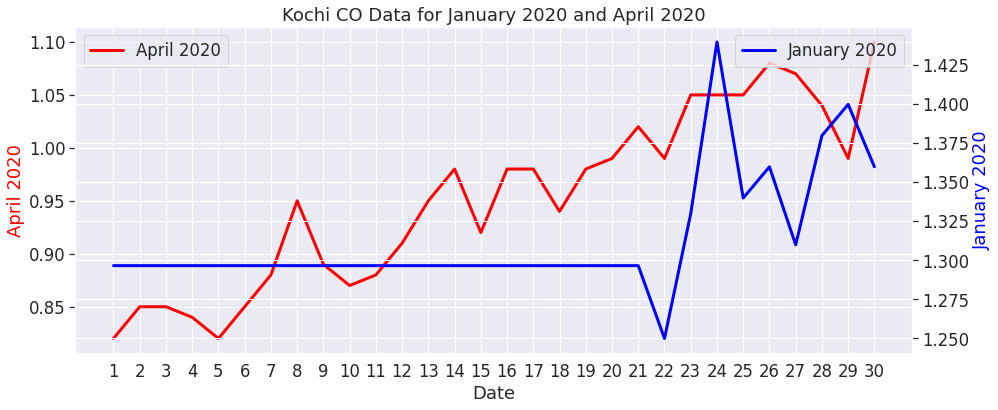

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Kochi'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Kochi'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kochi CO Data for January 2020 and April 2020');

Kolkata CO Data

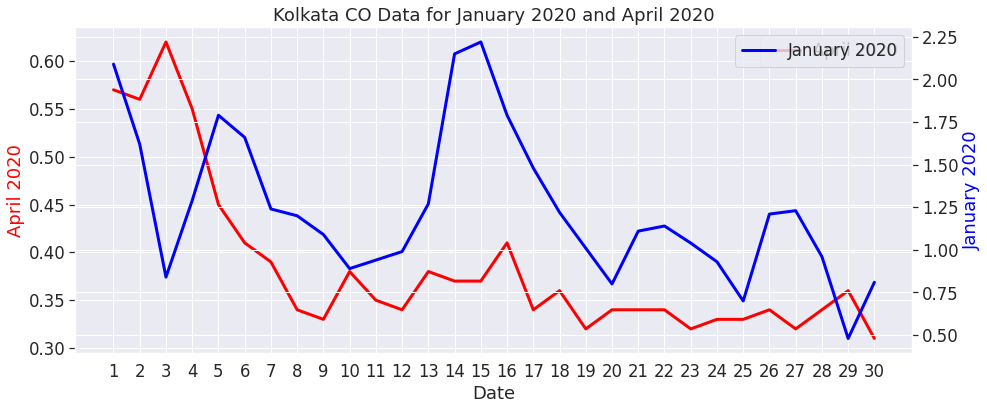

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Kolkata'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata CO Data for January 2020 and April 2020');

Lucknow CO Data

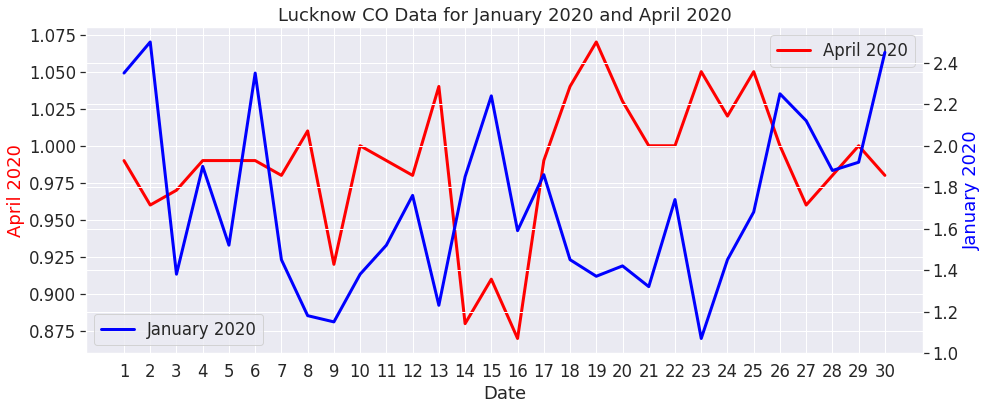

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Lucknow'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow CO Data for January 2020 and April 2020');

Patna CO Data

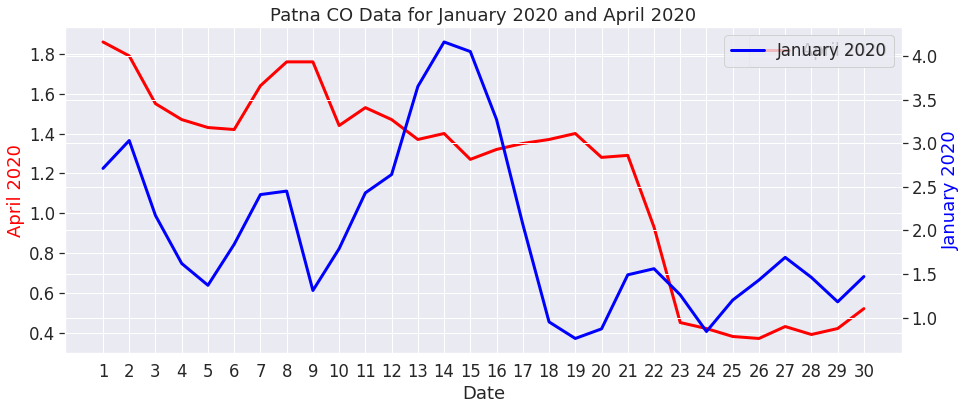

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Patna'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Patna'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna CO Data for January 2020 and April 2020');

Shillong CO Data

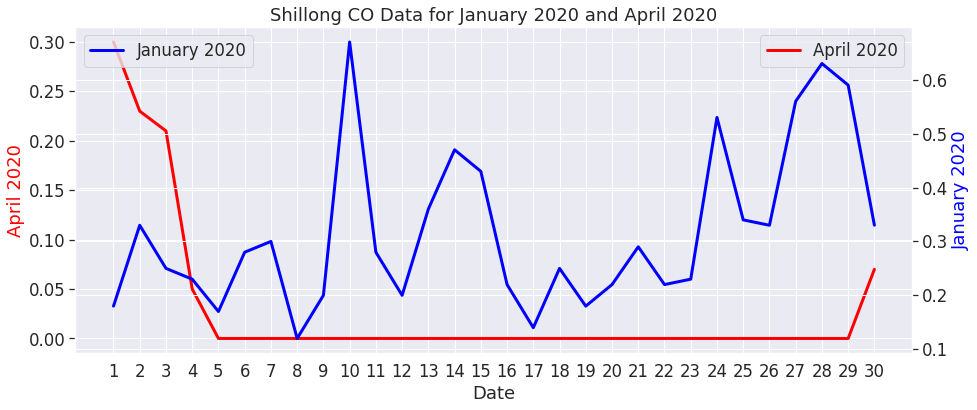

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Shillong'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong CO Data for January 2020 and April 2020');

Talcher CO Data

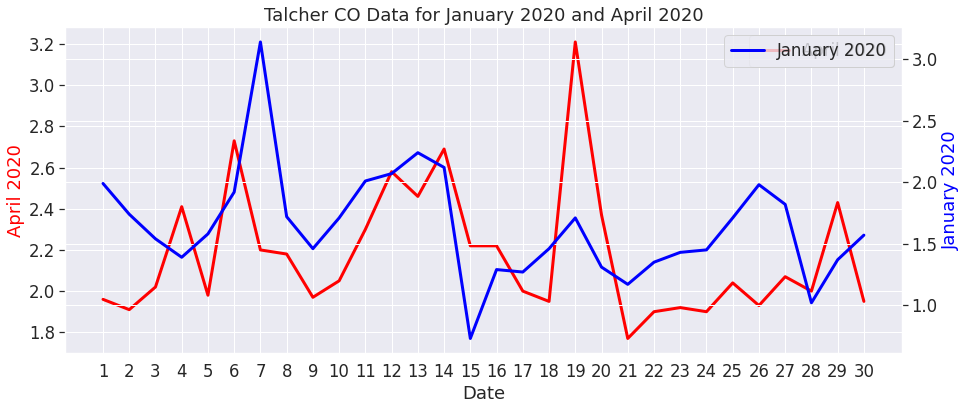

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Talcher'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Talcher'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Talcher CO Data for January 2020 and April 2020');

Thiruvananthapuram CO Data

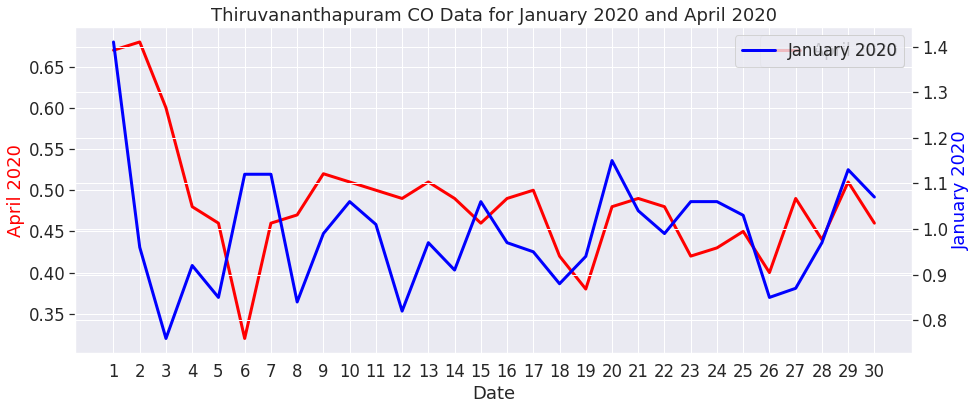

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Thiruvananthapuram'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Thiruvananthapuram'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Thiruvananthapuram CO Data for January 2020 and April 2020');

Visakhapatnam CO Data

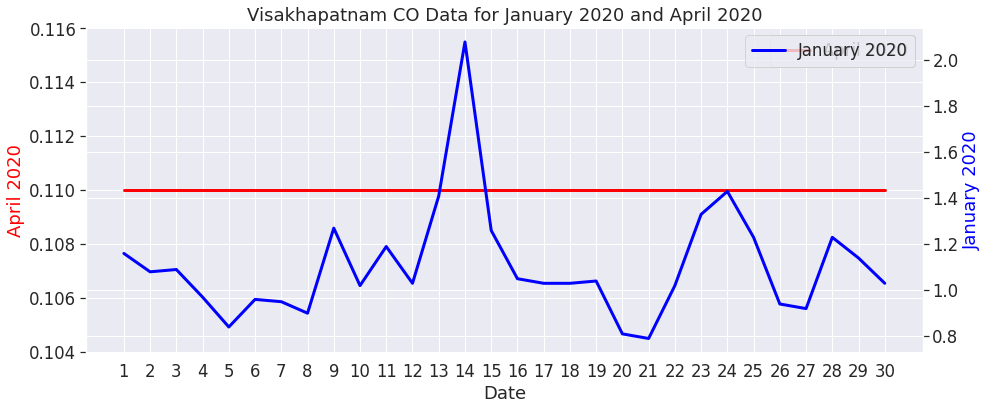

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale=1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfCO_Apr2020.index,dfCO_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.legend(['April 2020']);
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfCO_Jan2020.index,dfCO_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.legend(['January 2020']);
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam CO Data for January 2020 and April 2020');

### January 2020 and April 2020 'PM2.5' Data Check

In [ ]:
df_PM25 = dfcity_day.pivot(index='Date', columns='City', values='PM2.5')
df_PM25 = df_PM25.fillna(df_PM25.mean())
dfPM25_Apr2020 = df_PM25.loc['2020-04-01':'2020-04-30']
dfPM25_Jan2020 = df_PM25.loc['2020-01-01':'2020-01-30']

Ahmedabad PM2.5 Data

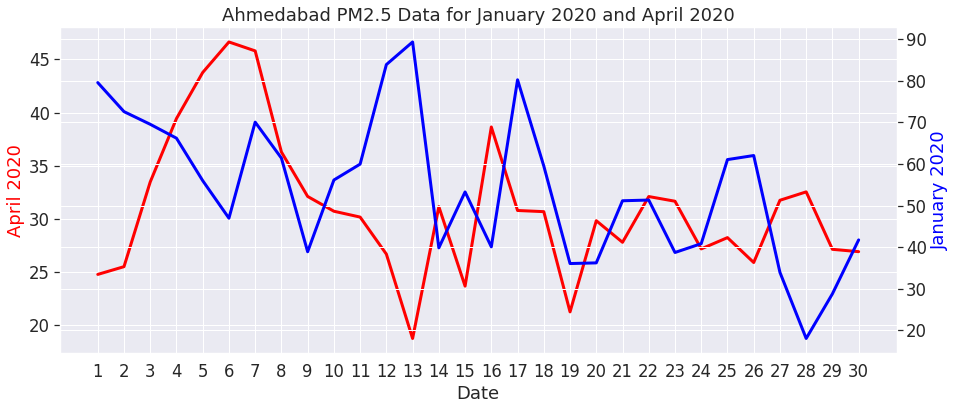

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad PM2.5 Data for January 2020 and April 2020');

Amritsar PM2.5 Data

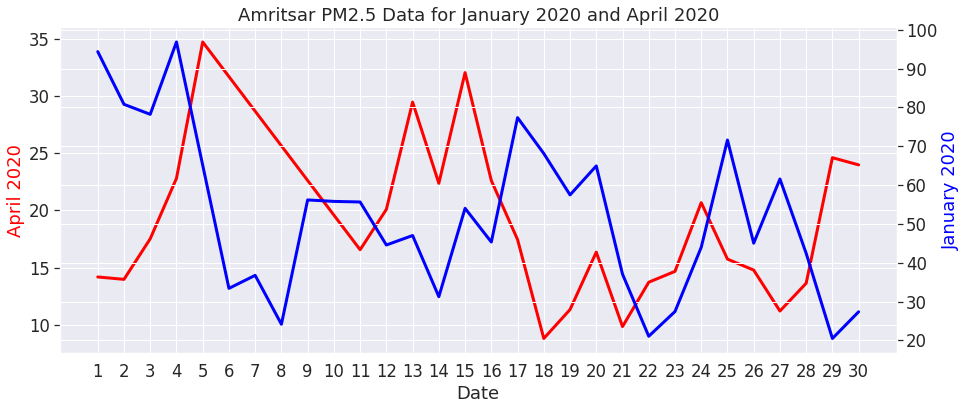

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar PM2.5 Data for January 2020 and April 2020');

Amaravati PM2.5 Data

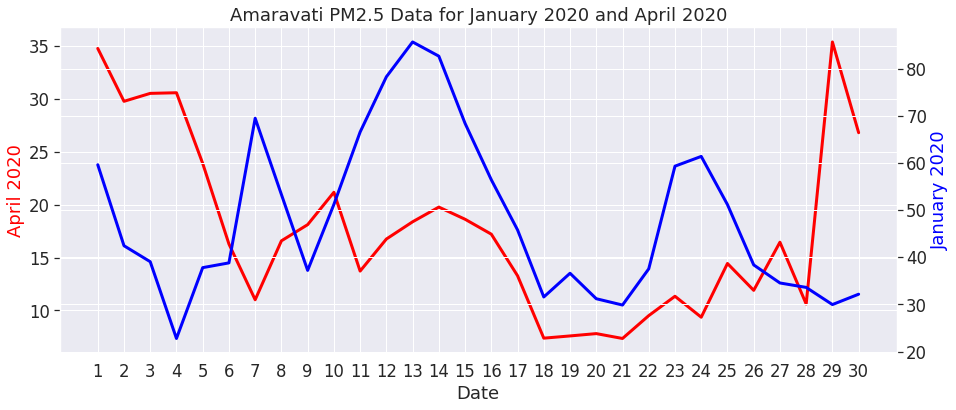

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Amaravati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati PM2.5 Data for January 2020 and April 2020');

Bengaluru PM2.5 Data

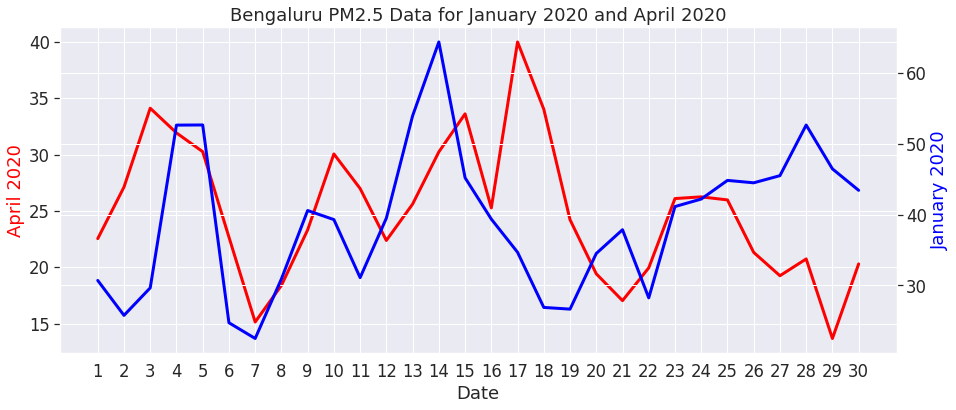

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru PM2.5 Data for January 2020 and April 2020');

Bhopal PM2.5 Data

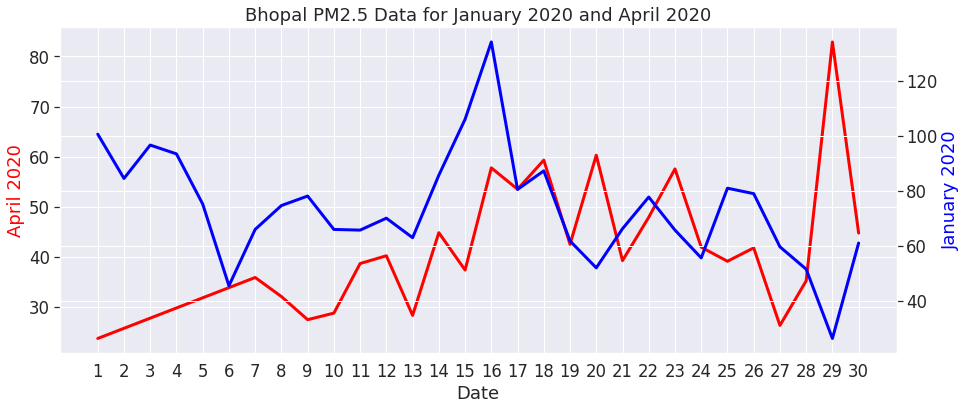

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal PM2.5 Data for January 2020 and April 2020');

Chennai PM2.5 Data

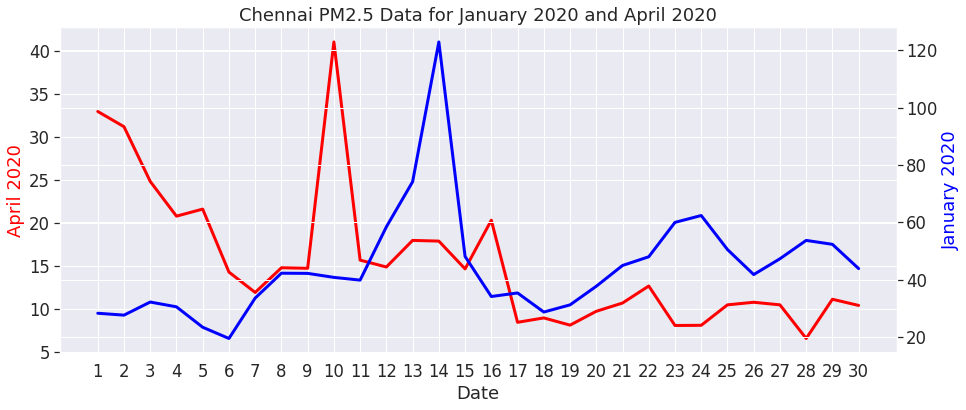

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Chennai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai PM2.5 Data for January 2020 and April 2020');

Coimbatore PM2.5 Data

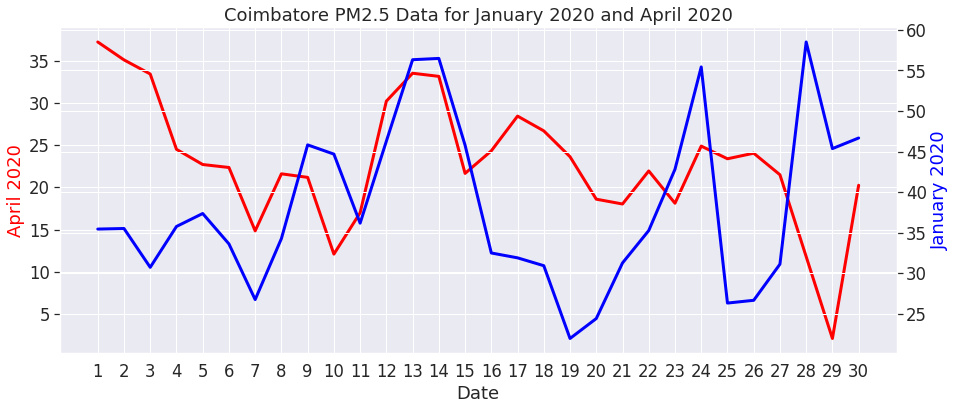

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Coimbatore'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore PM2.5 Data for January 2020 and April 2020');

Delhi PM2.5 Data

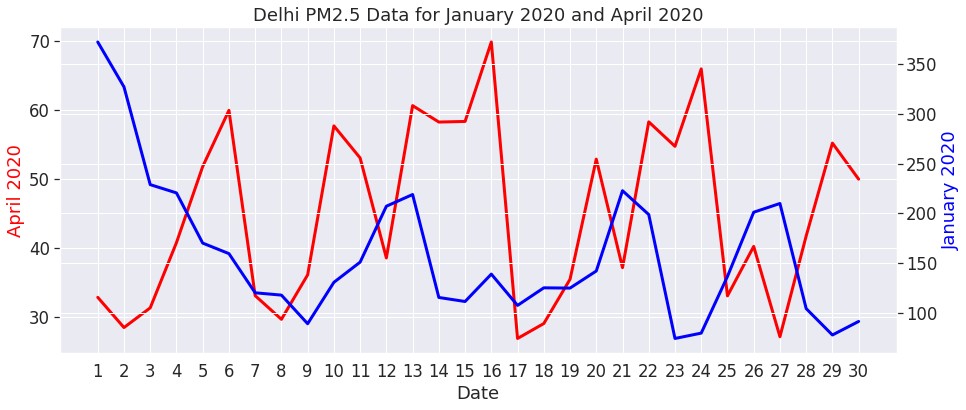

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Delhi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi PM2.5 Data for January 2020 and April 2020');

Gurugram PM2.5 Data

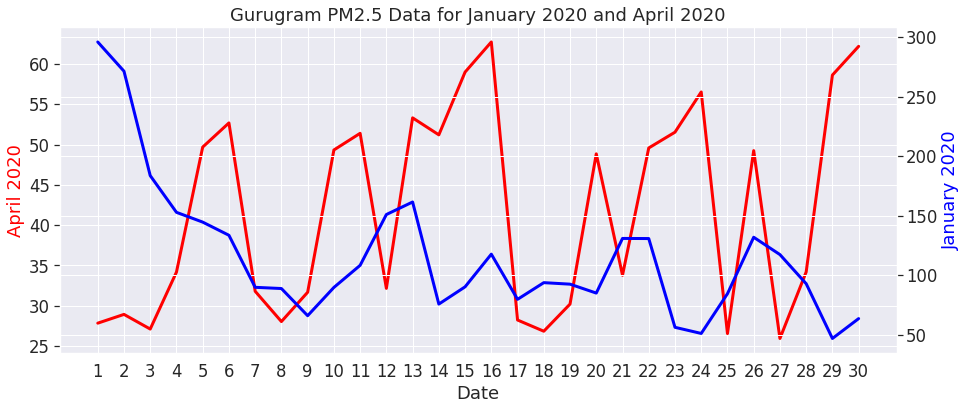

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Gurugram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram PM2.5 Data for January 2020 and April 2020');

Guwahati PM2.5 Data

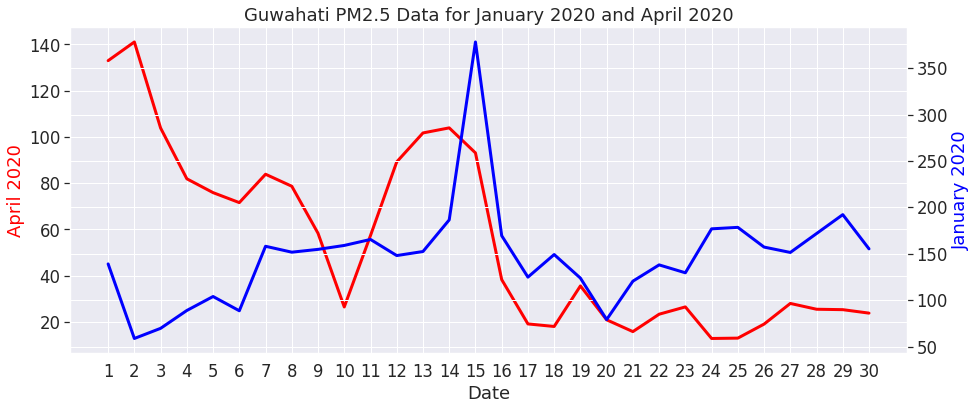

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati PM2.5 Data for January 2020 and April 2020');

Hyderabad PM2.5 Data

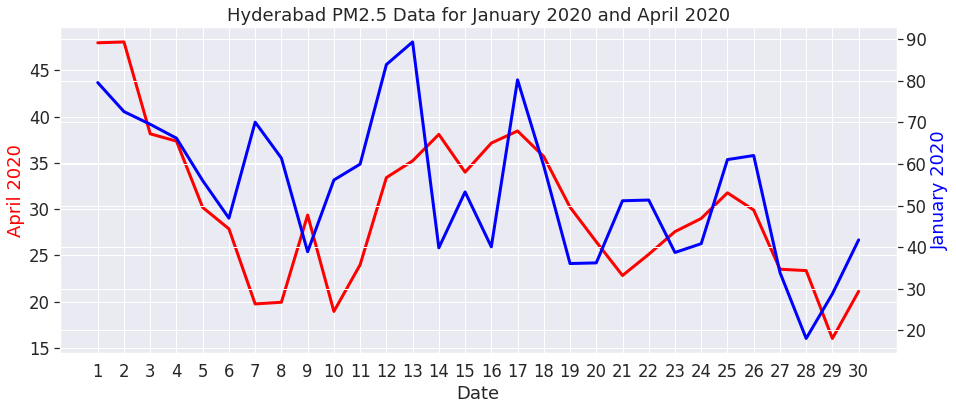

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Hyderabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad PM2.5 Data for January 2020 and April 2020');

Jaipur PM2.5 Data

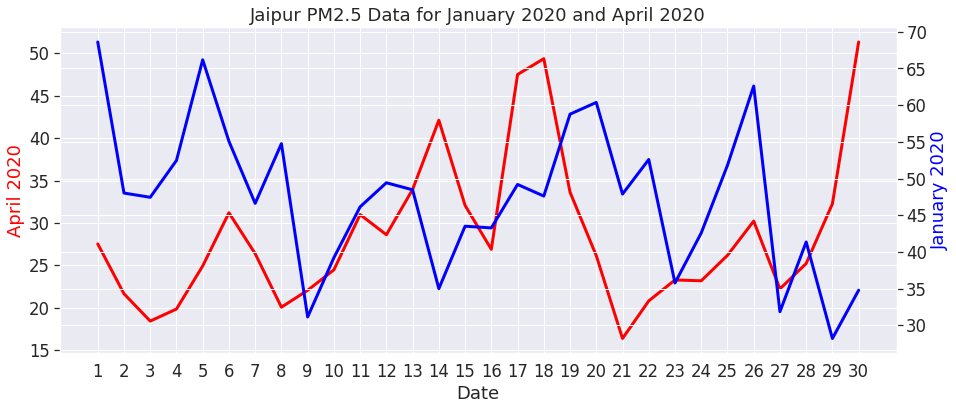

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Jaipur'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur PM2.5 Data for January 2020 and April 2020');

Kochi PM2.5 Data

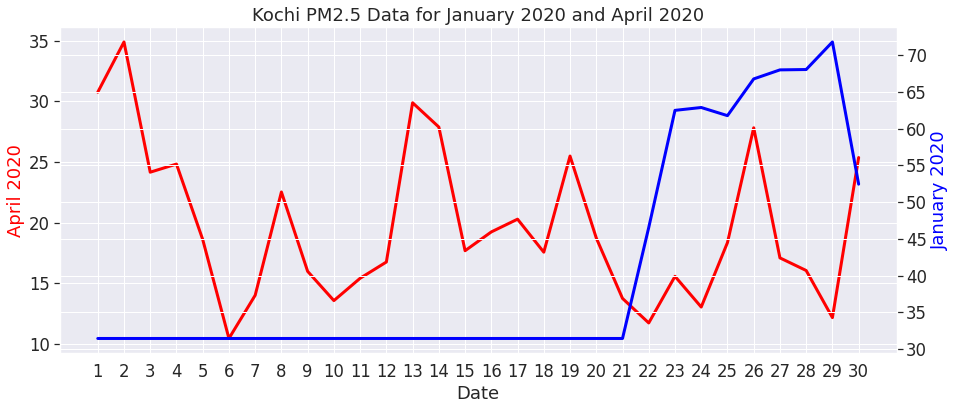

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Kochi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Kochi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kochi PM2.5 Data for January 2020 and April 2020');

Kolkata PM2.5 Data

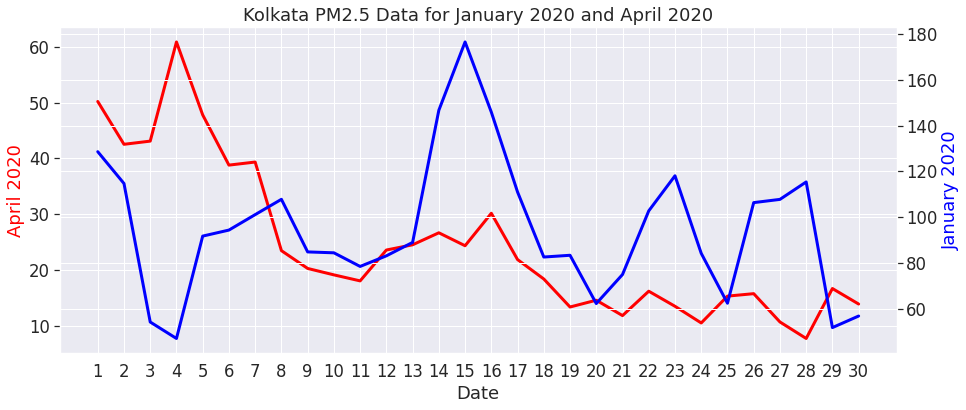

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Kolkata'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata PM2.5 Data for January 2020 and April 2020');

Lucknow PM2.5 Data

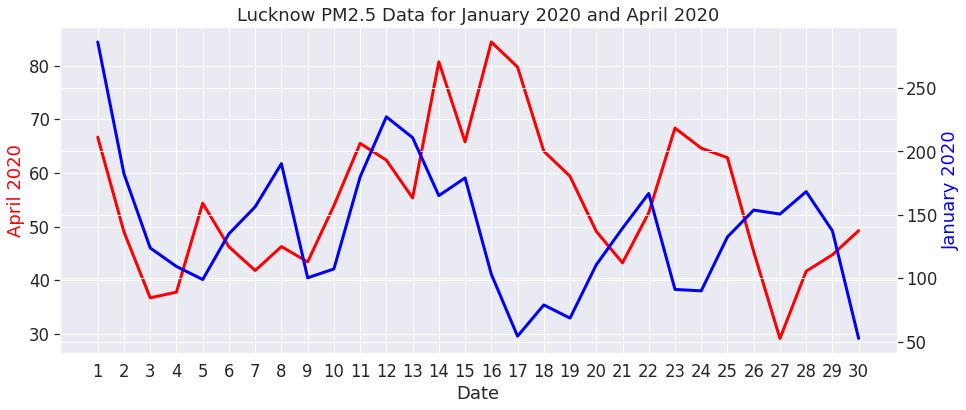

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Lucknow'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow PM2.5 Data for January 2020 and April 2020');

Mumbai PM2.5 Data

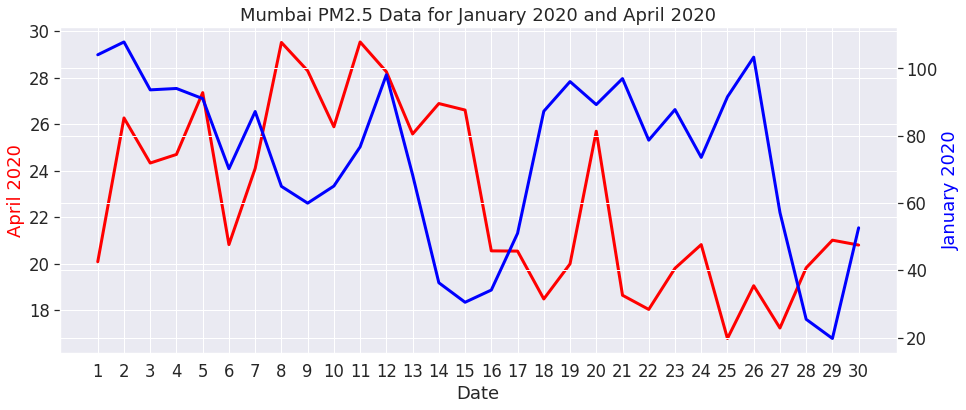

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Mumbai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai PM2.5 Data for January 2020 and April 2020');

Patna PM2.5 Data

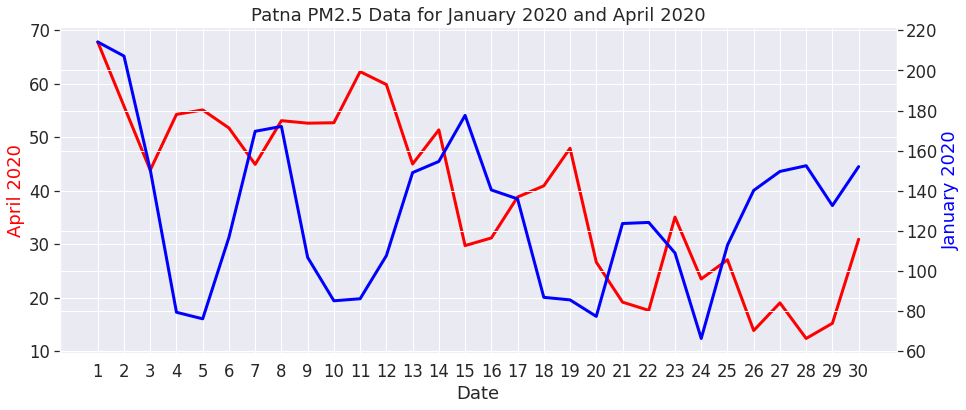

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna PM2.5 Data for January 2020 and April 2020');

Shillong PM2.5 Data

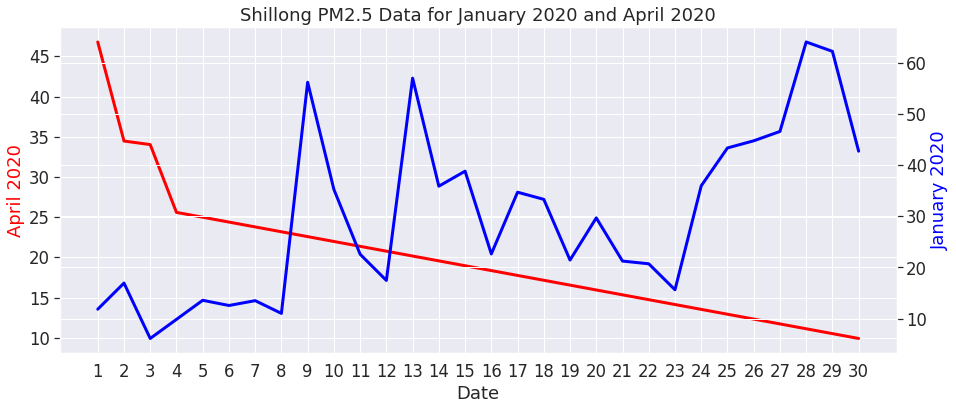

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Shillong'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong PM2.5 Data for January 2020 and April 2020');

Talcher PM2.5 Data

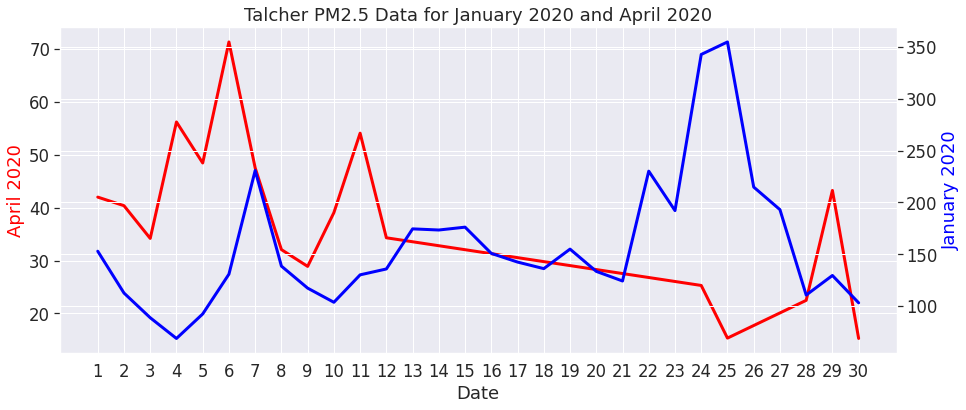

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Talcher'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Talcher'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Talcher PM2.5 Data for January 2020 and April 2020');

Thiruvananthapuram PM2.5 Data

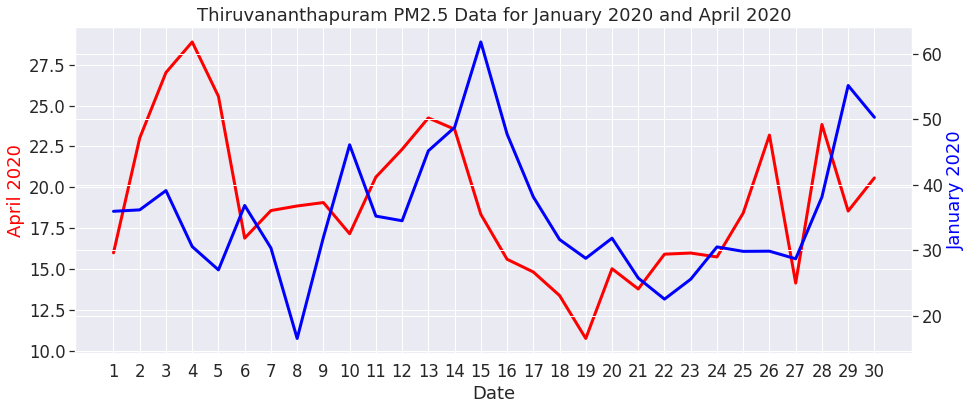

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Thiruvananthapuram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Thiruvananthapuram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Thiruvananthapuram PM2.5 Data for January 2020 and April 2020');

Visakhapatnam PM2.5 Data

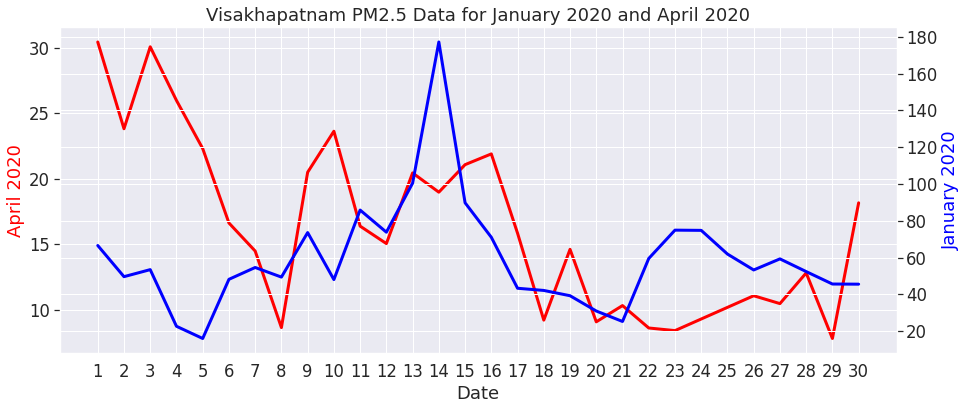

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM25_Apr2020.index,dfPM25_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM25_Jan2020.index,dfPM25_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam PM2.5 Data for January 2020 and April 2020');

### January 2020 and April 2020 'NO2' Data Check

In [ ]:
df_NO2 = dfcity_day.pivot(index='Date', columns='City', values='NO2')
df_NO2 = df_NO2.fillna(df_NO2.mean())
dfNO2_Apr2020 = df_NO2.loc['2020-04-01':'2020-04-30']
dfNO2_Jan2020 = df_NO2.loc['2020-01-01':'2020-01-30']

Ahmedabad NO2 data

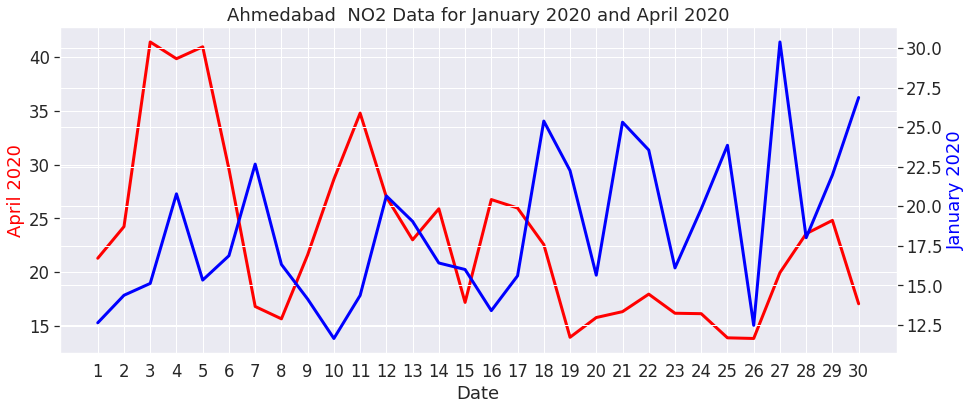

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad  NO2 Data for January 2020 and April 2020');

Aizawl NO2 data

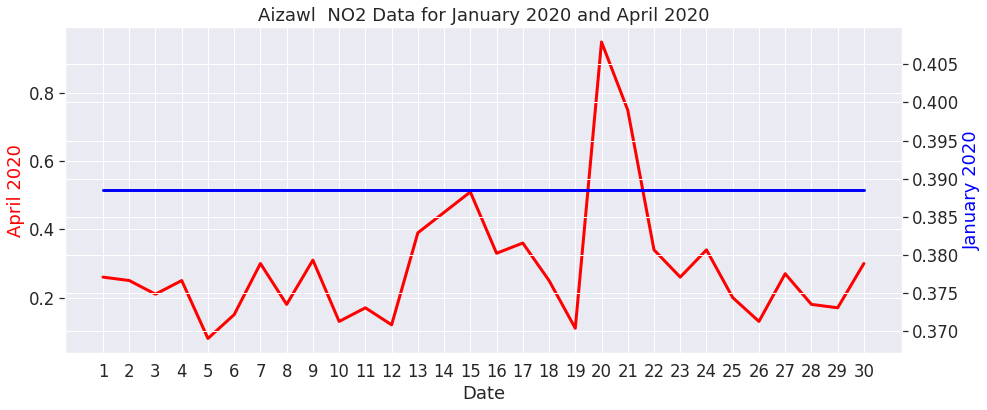

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Aizawl'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl  NO2 Data for January 2020 and April 2020');

Amaravati NO2 data

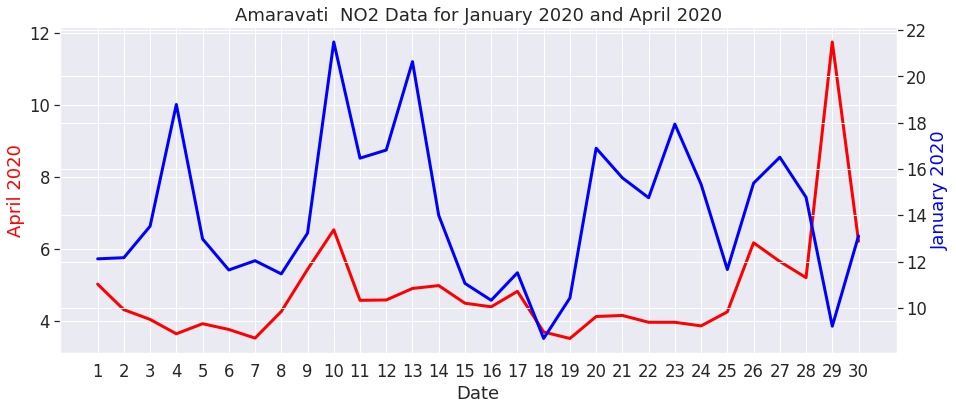

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Amaravati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati  NO2 Data for January 2020 and April 2020');

Amritsar NO2 data

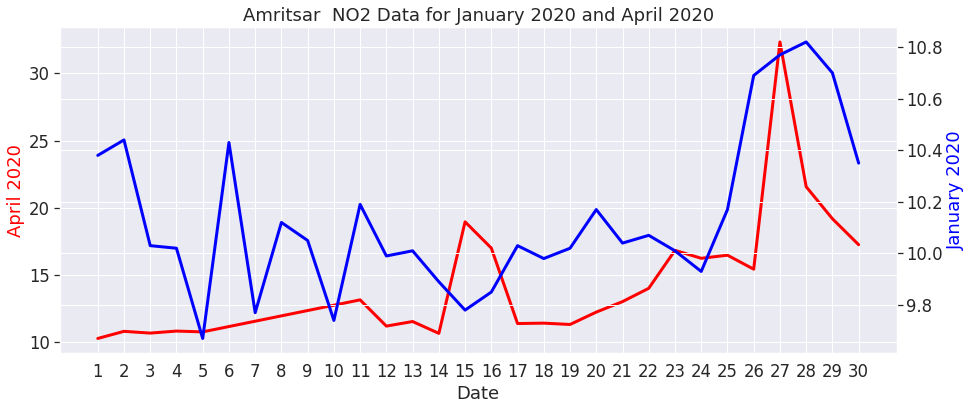

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar  NO2 Data for January 2020 and April 2020');

Bengaluru NO2 data

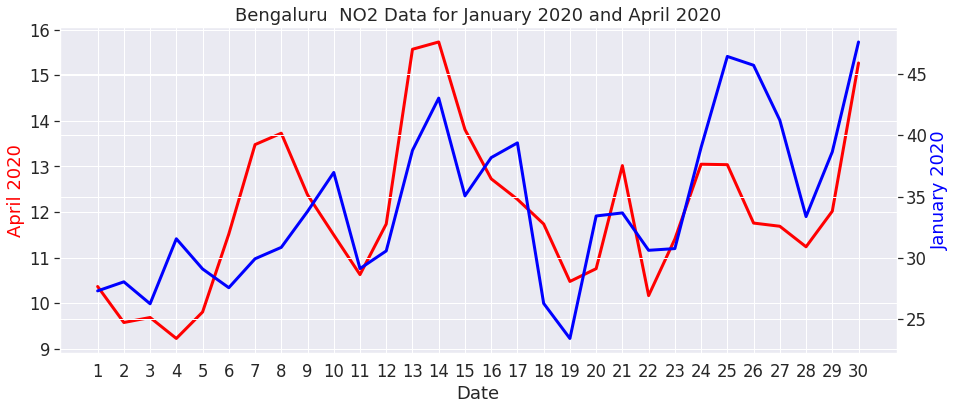

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru  NO2 Data for January 2020 and April 2020');

Bhopal NO2 data

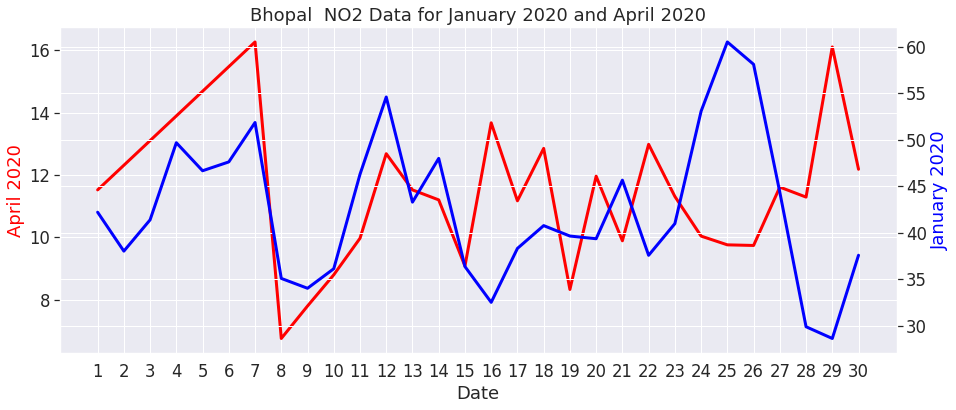

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal  NO2 Data for January 2020 and April 2020');

Chandigarh NO2 data

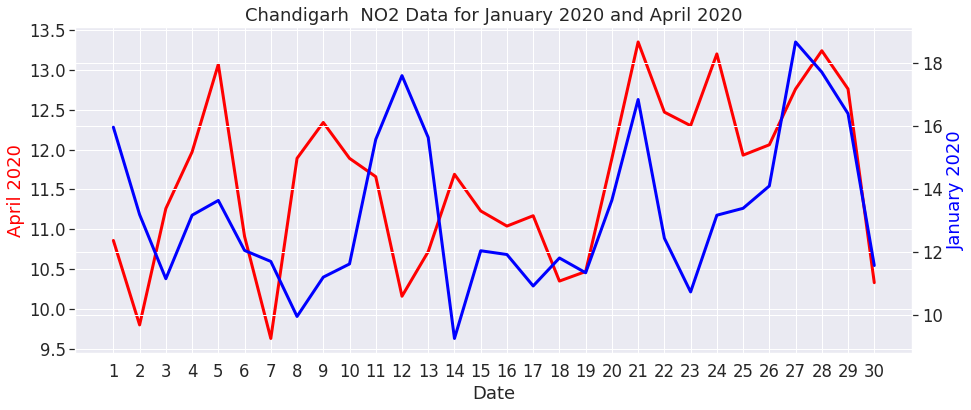

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Chandigarh'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh  NO2 Data for January 2020 and April 2020');

Chennai NO2 data

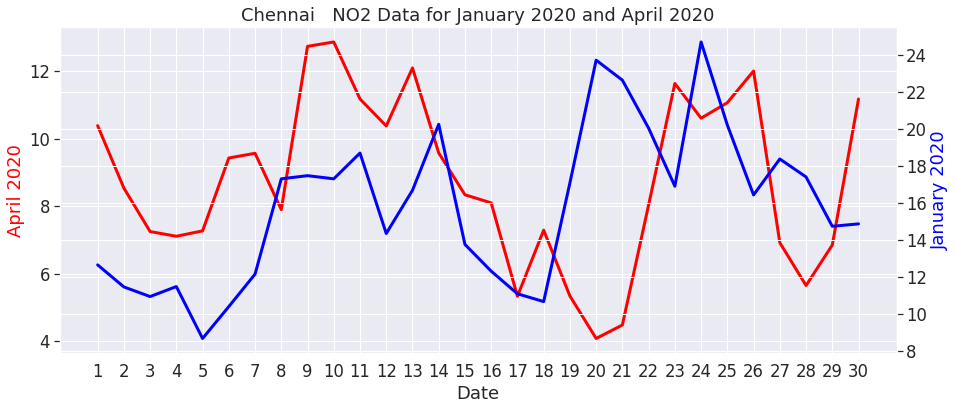

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Chennai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai   NO2 Data for January 2020 and April 2020');

Coimbatore NO2 data

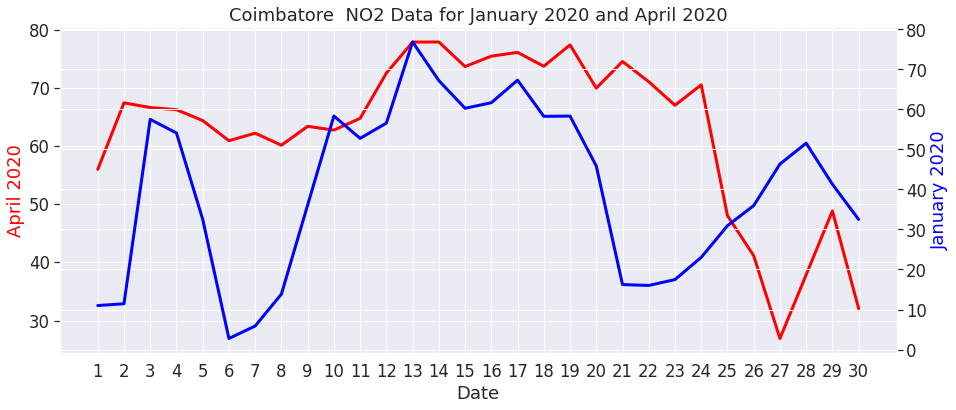

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Coimbatore'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore  NO2 Data for January 2020 and April 2020');

Delhi NO2 data

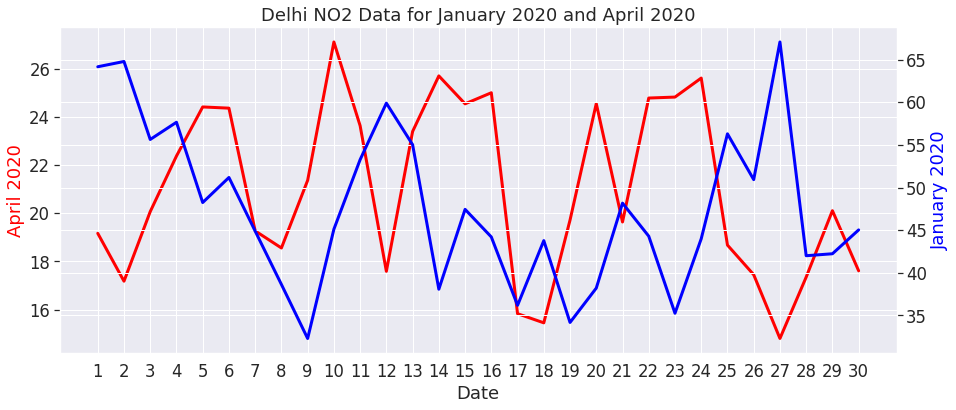

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Delhi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi NO2 Data for January 2020 and April 2020');

Ernakulam NO2 data

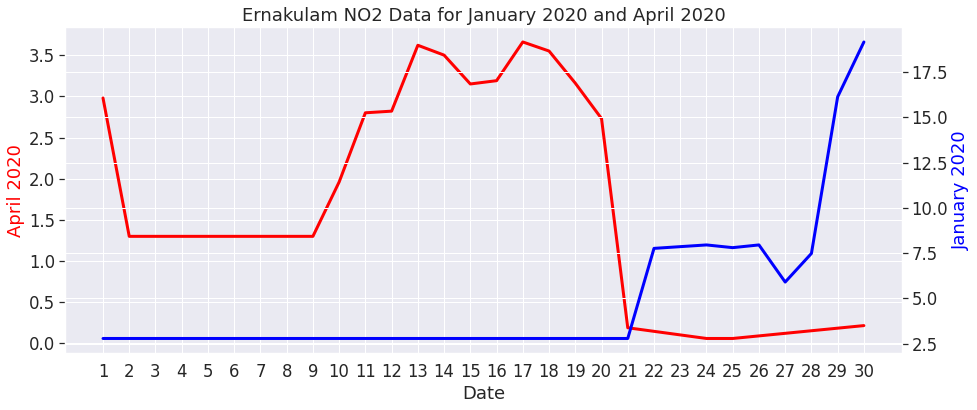

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Ernakulam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Ernakulam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ernakulam NO2 Data for January 2020 and April 2020');

Gurugram NO2 data

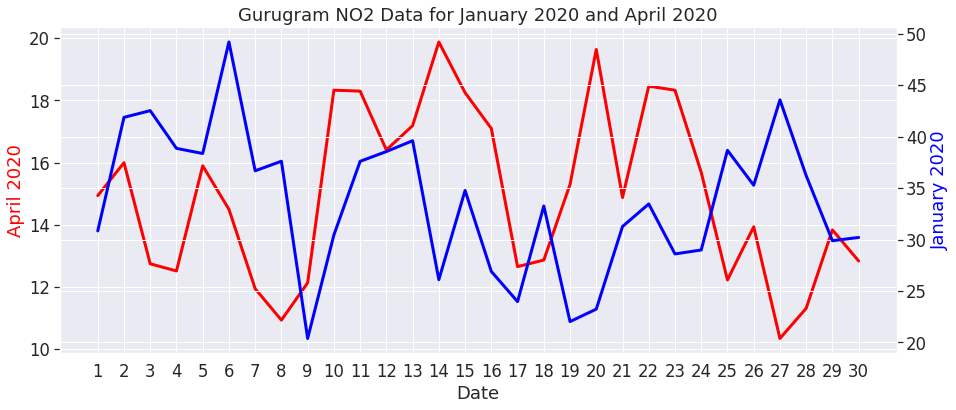

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Gurugram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram NO2 Data for January 2020 and April 2020');

Guwahati NO2 data

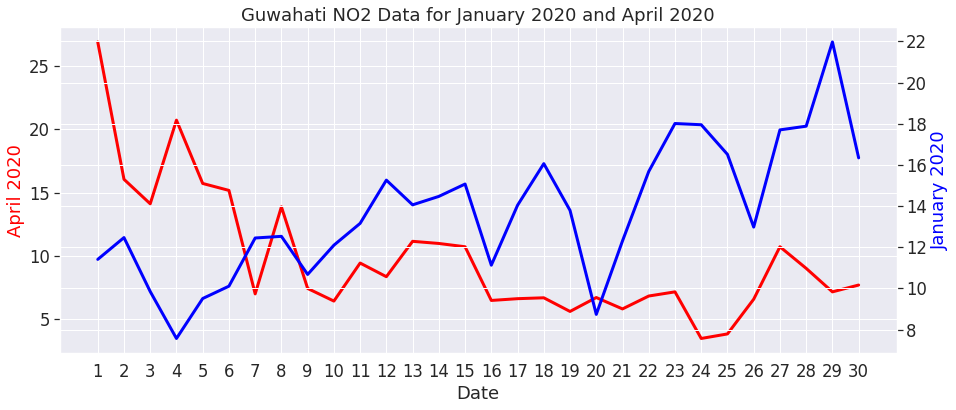

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati NO2 Data for January 2020 and April 2020');

Hyderabad NO2 data

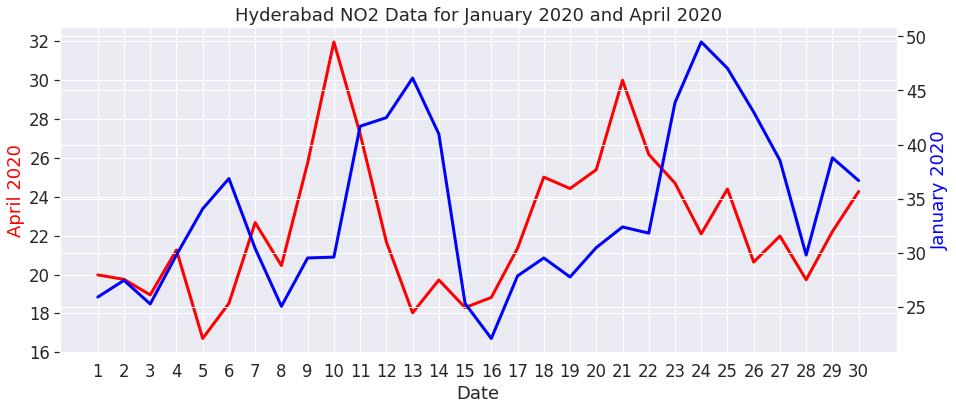

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Hyderabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Hyderabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad NO2 Data for January 2020 and April 2020');

Jaipur NO2 data

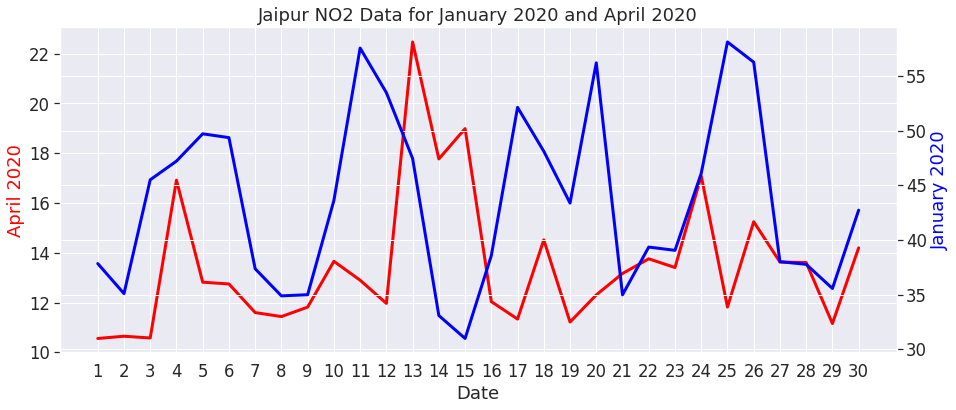

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Jaipur'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur NO2 Data for January 2020 and April 2020');

Kochi NO2 data

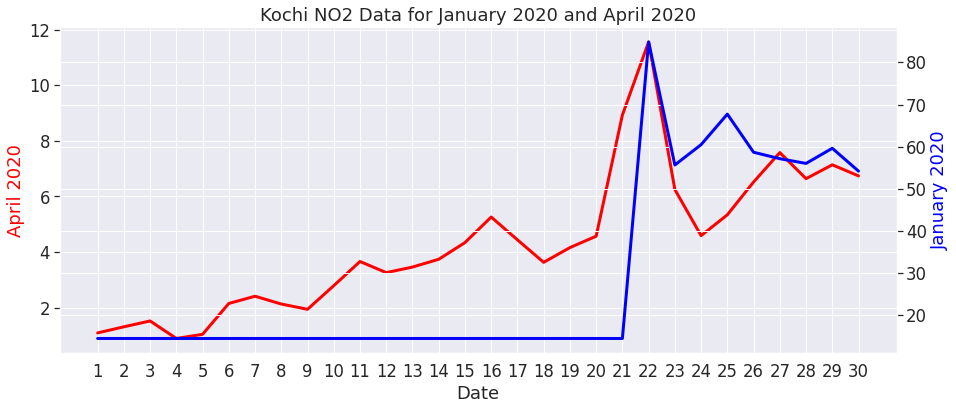

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Kochi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Kochi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kochi NO2 Data for January 2020 and April 2020');

Kolkata NO2 data

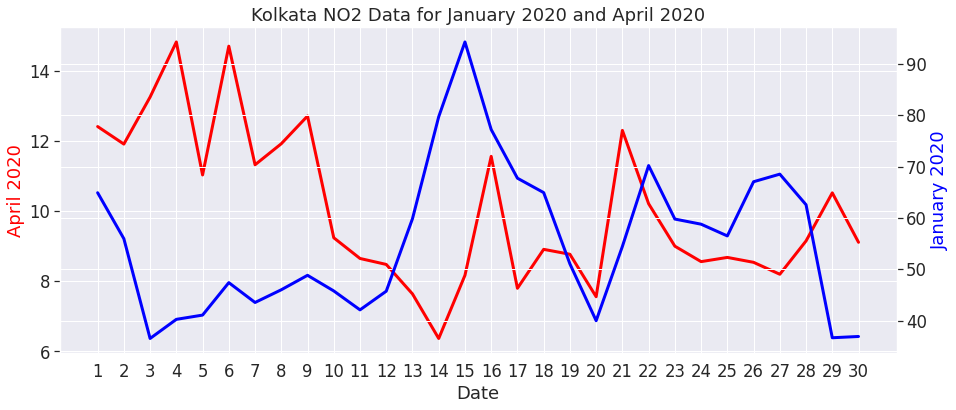

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Kolkata'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata NO2 Data for January 2020 and April 2020');

Lucknow NO2 data

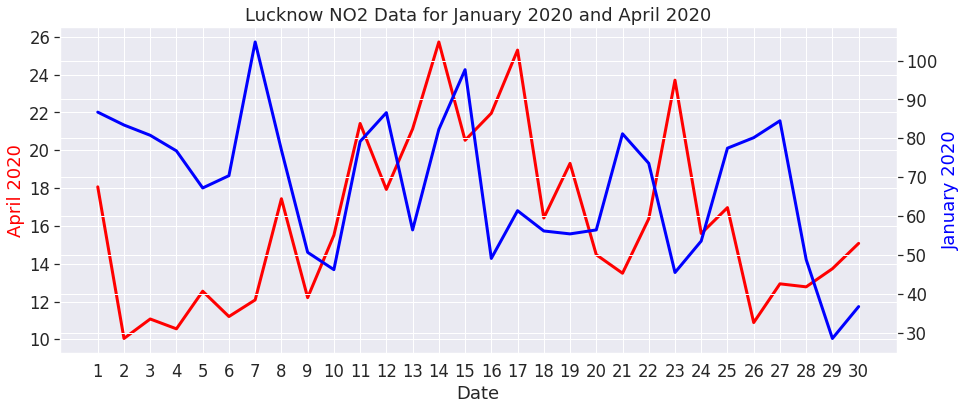

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Lucknow'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow NO2 Data for January 2020 and April 2020');

Mumbai NO2 data

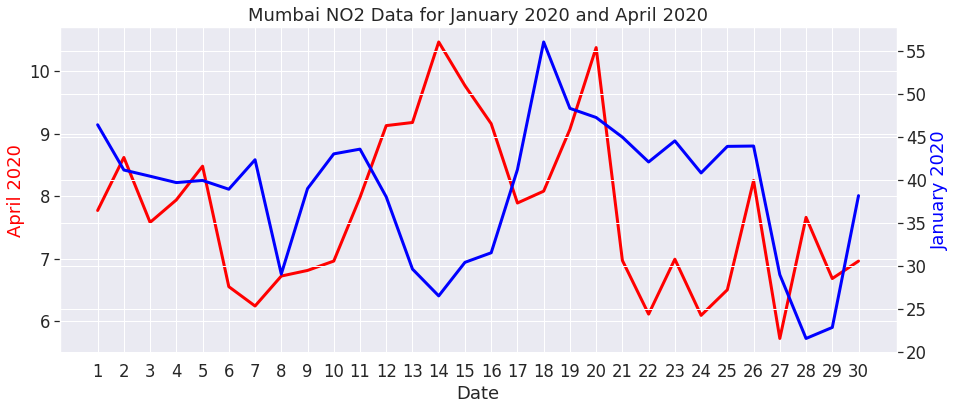

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Mumbai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai NO2 Data for January 2020 and April 2020');

Patna NO2 data

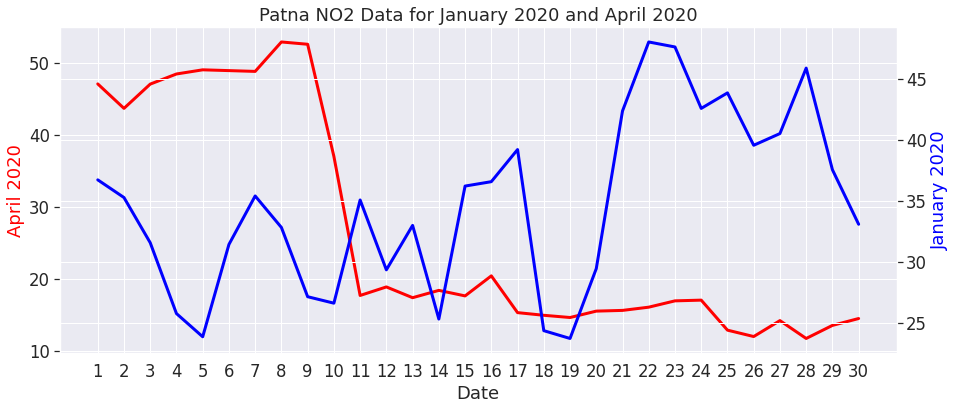

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna NO2 Data for January 2020 and April 2020');

Shillong NO2 data

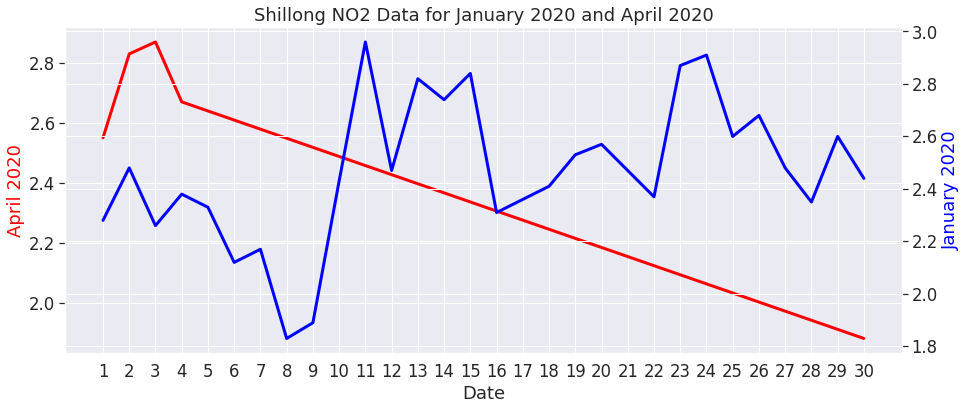

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Shillong'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong NO2 Data for January 2020 and April 2020');

Talcher NO2 data

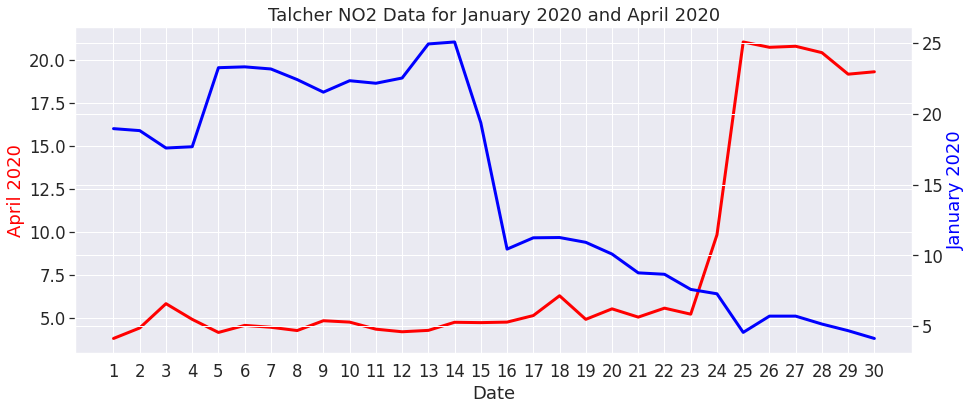

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Talcher'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Talcher'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Talcher NO2 Data for January 2020 and April 2020');

Thiruvananthapuram NO2 data

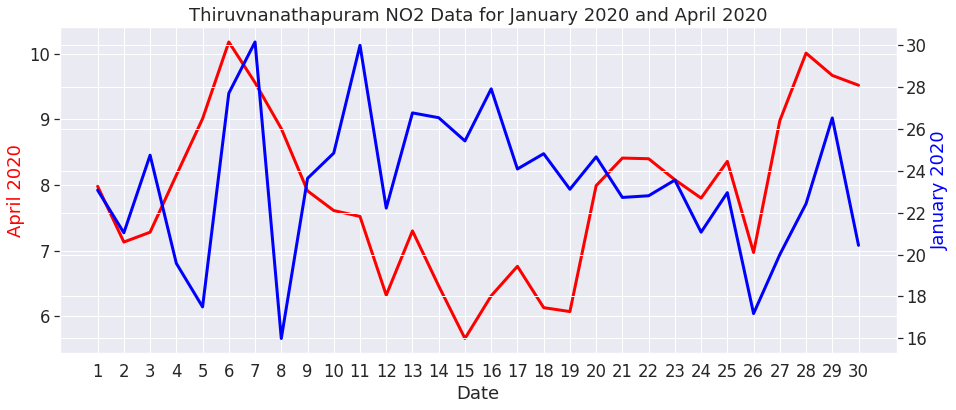

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Thiruvananthapuram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Thiruvananthapuram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Thiruvnanathapuram NO2 Data for January 2020 and April 2020');

Visakhapatnam NO2 data

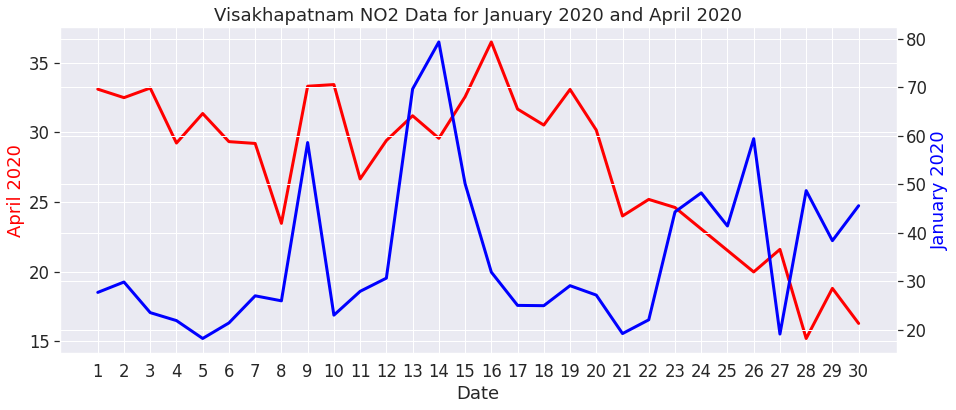

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam NO2 Data for January 2020 and April 2020');

### January 2020 and April 2020 'NH3' Data Check

In [ ]:
df_NH3 = dfcity_day.pivot(index='Date', columns='City', values='NH3')
df_NH3 = df_NH3.fillna(df_NH3.mean())
dfNH3_Apr2020 = df_NH3.loc['2020-04-01':'2020-04-30']
dfNH3_Jan2020 = df_NH3.loc['2020-01-01':'2020-01-30']

Ahmedabad NH3 data

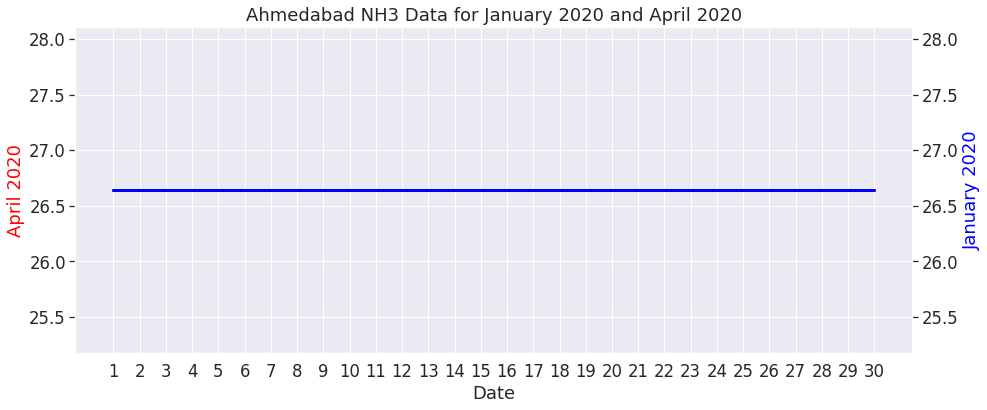

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad NH3 Data for January 2020 and April 2020');

Aizawl NH3 data

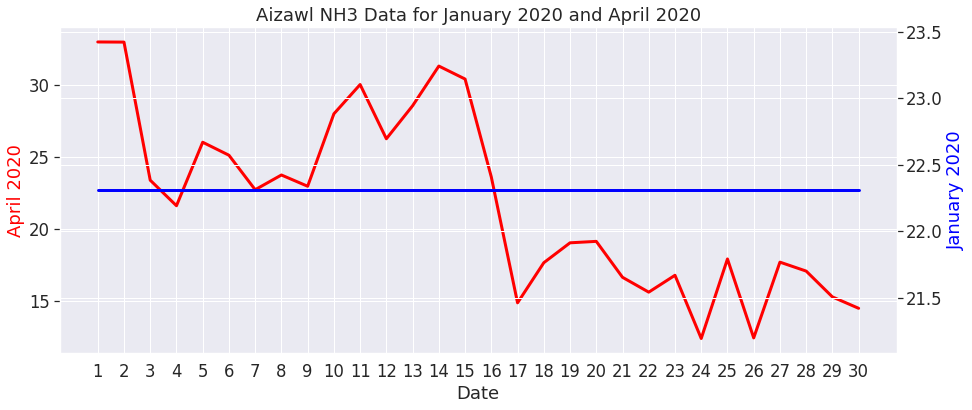

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Aizawl'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl NH3 Data for January 2020 and April 2020');

Amaravati NH3 data

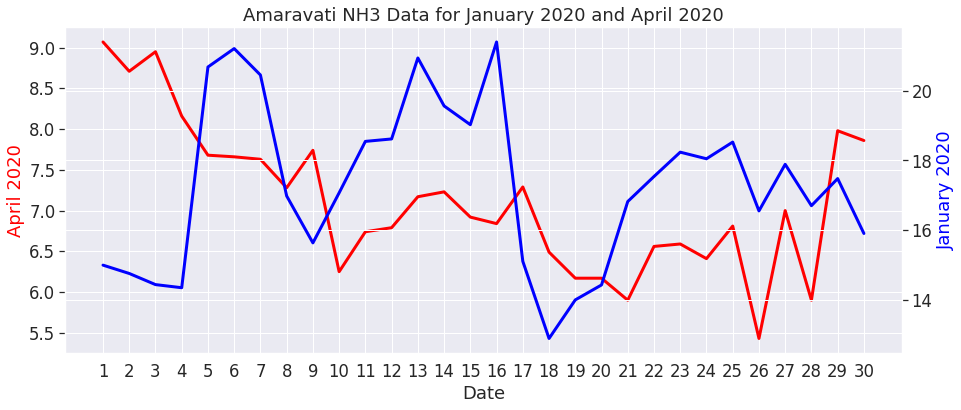

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Amaravati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati NH3 Data for January 2020 and April 2020');

Amritsar NH3 data





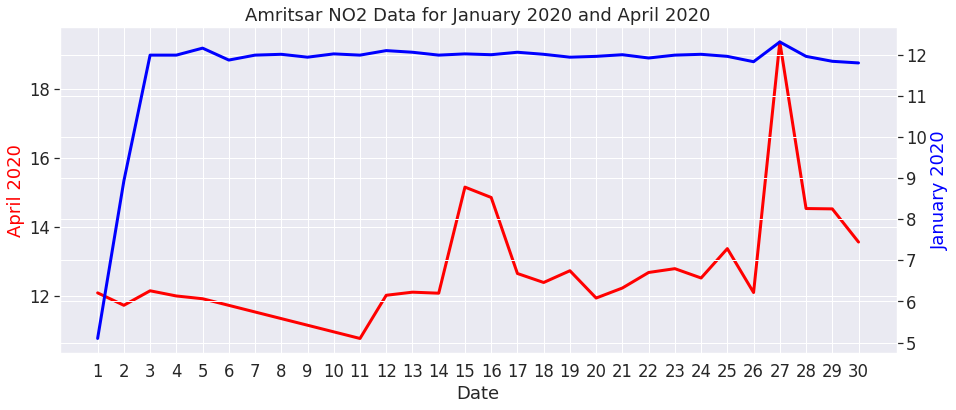

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar NO2 Data for January 2020 and April 2020');

Bengaluru NH3 data

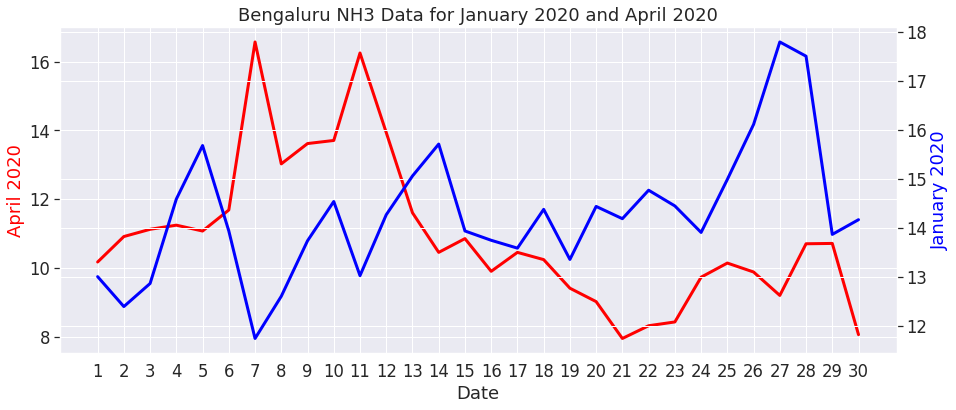

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru NH3 Data for January 2020 and April 2020');

Bhopal NH3 data

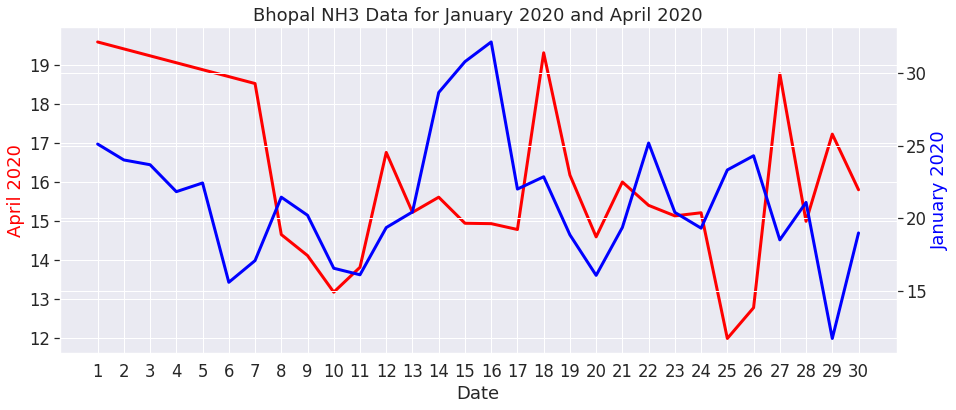

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal NH3 Data for January 2020 and April 2020');

Chandigarh NH3 data

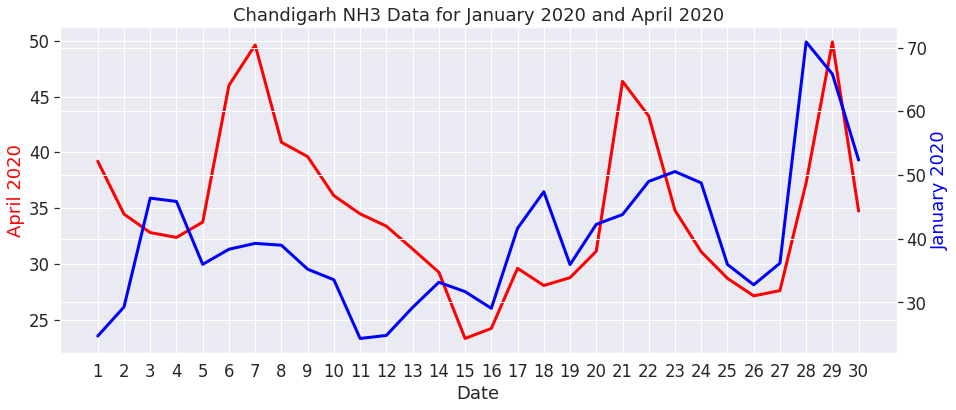

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Chandigarh'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh NH3 Data for January 2020 and April 2020');

Chennai NH3 data

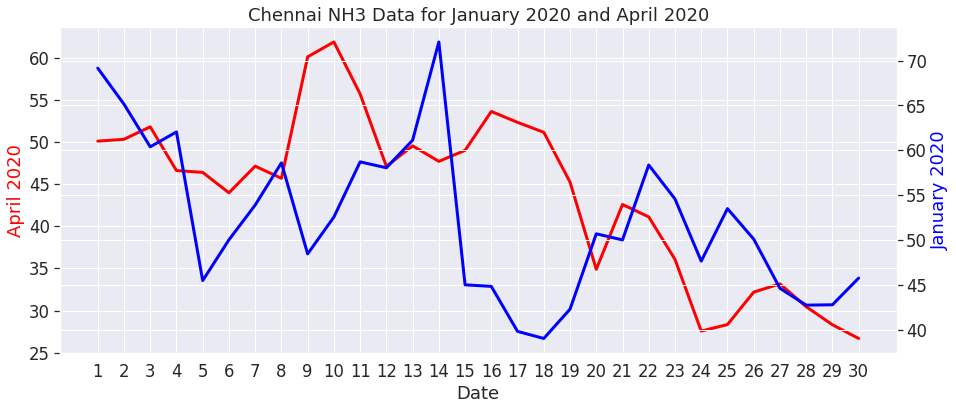

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Chennai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai NH3 Data for January 2020 and April 2020');

Coimbatore NH3 data

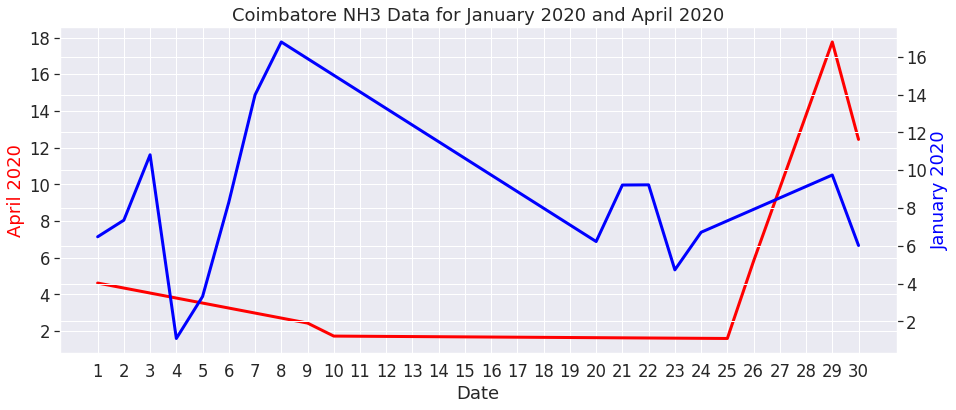

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Coimbatore'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore NH3 Data for January 2020 and April 2020');

Delhi NH3 data

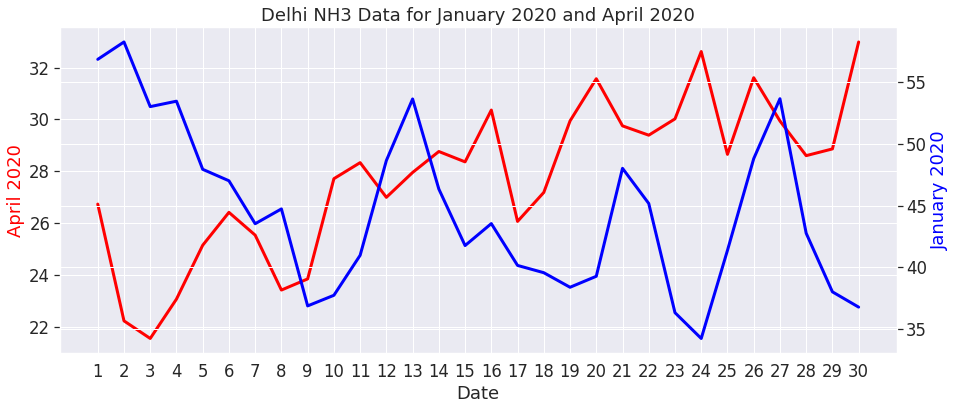

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Delhi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi NH3 Data for January 2020 and April 2020');

Ernakulam NH3 data

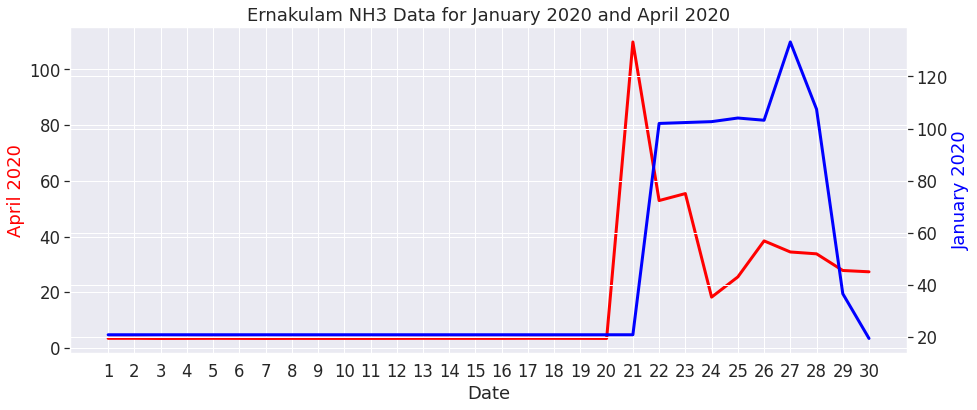

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Ernakulam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Ernakulam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ernakulam NH3 Data for January 2020 and April 2020');

Gurugram NH3 data

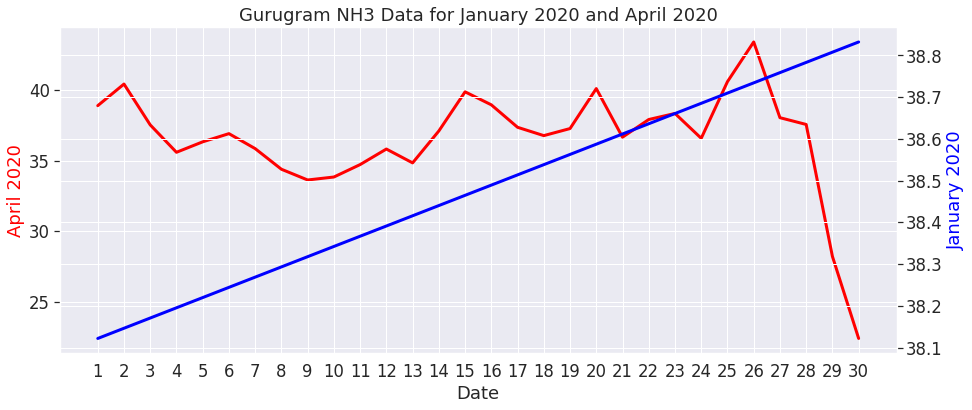

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Gurugram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram NH3 Data for January 2020 and April 2020');

Guwahati NH3 data

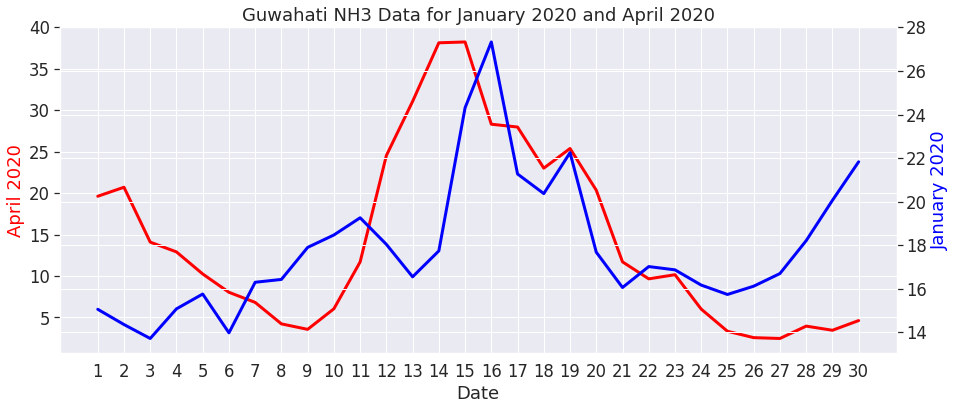

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati NH3 Data for January 2020 and April 2020');

Hyderabad NH3 data

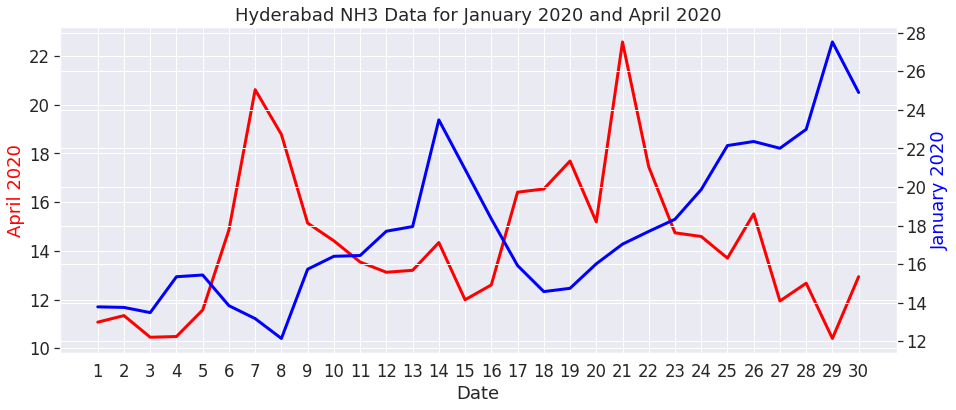

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Hyderabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Hyderabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad NH3 Data for January 2020 and April 2020');

Jaipur NH3 data

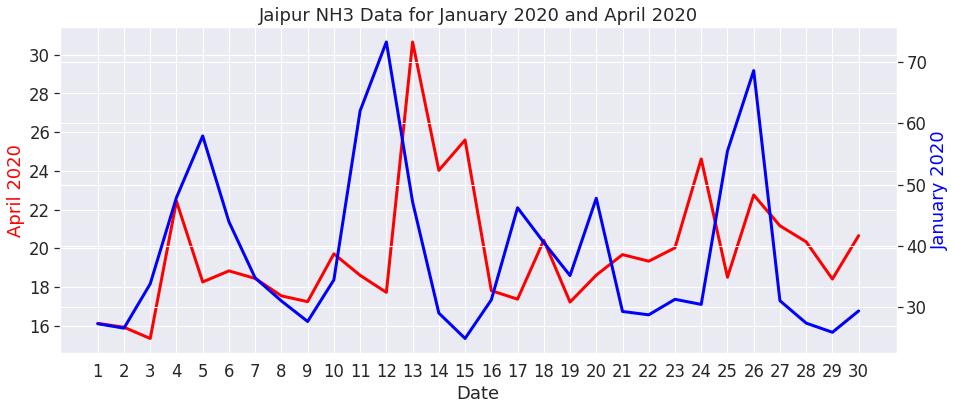

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Jaipur'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur NH3 Data for January 2020 and April 2020');

Kochi NH3 data

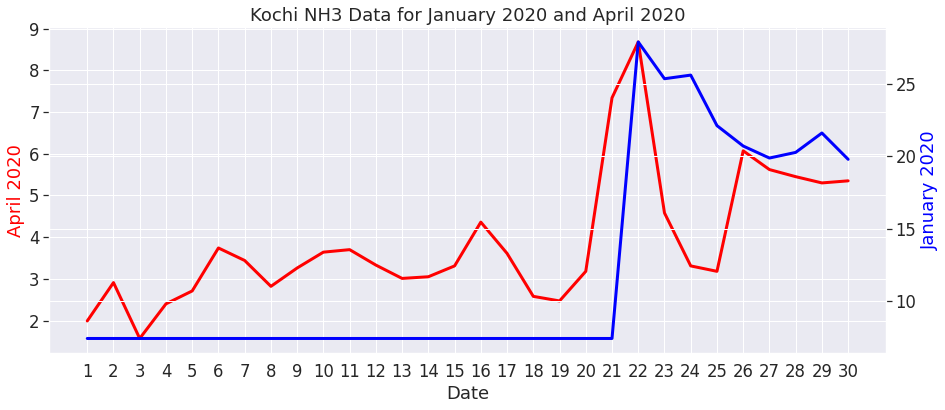

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Kochi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Kochi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kochi NH3 Data for January 2020 and April 2020');

Kolkata NH3 data

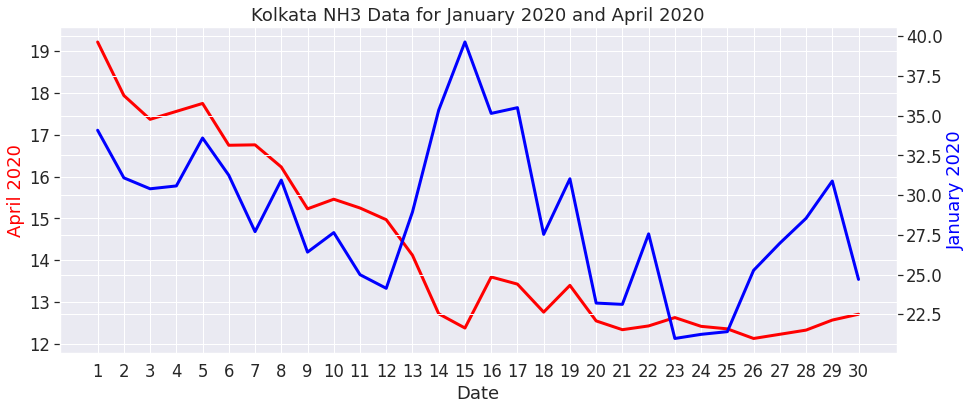

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Kolkata'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata NH3 Data for January 2020 and April 2020');

Lucknow NH3 data

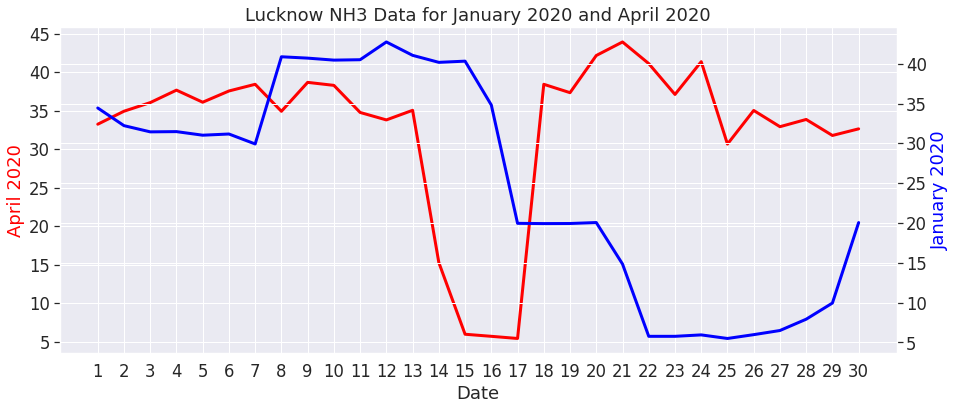

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Lucknow'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow NH3 Data for January 2020 and April 2020');

Mumbai NH3 data

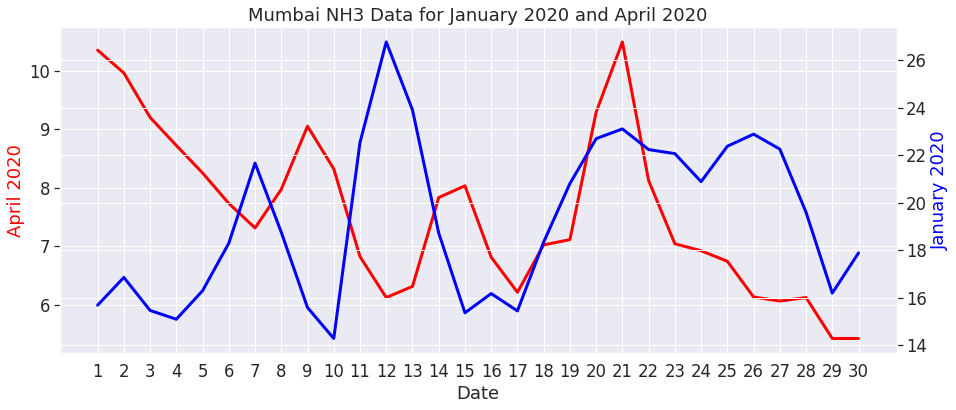

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Mumbai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai NH3 Data for January 2020 and April 2020');

Patna NH3 data

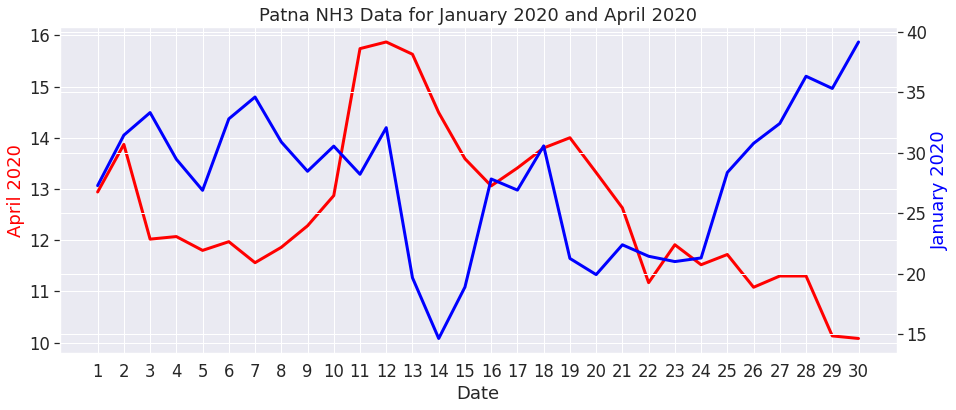

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna NH3 Data for January 2020 and April 2020');

Shillong NH3 data

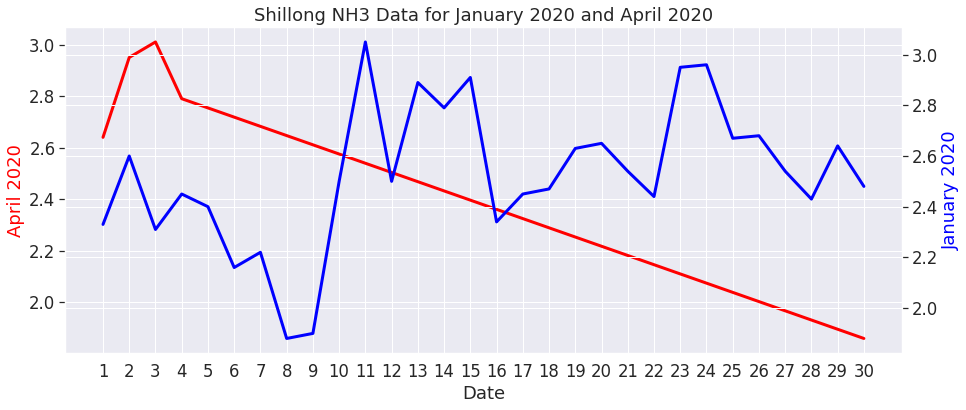

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Shillong'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong NH3 Data for January 2020 and April 2020');

Talcher NH3 data

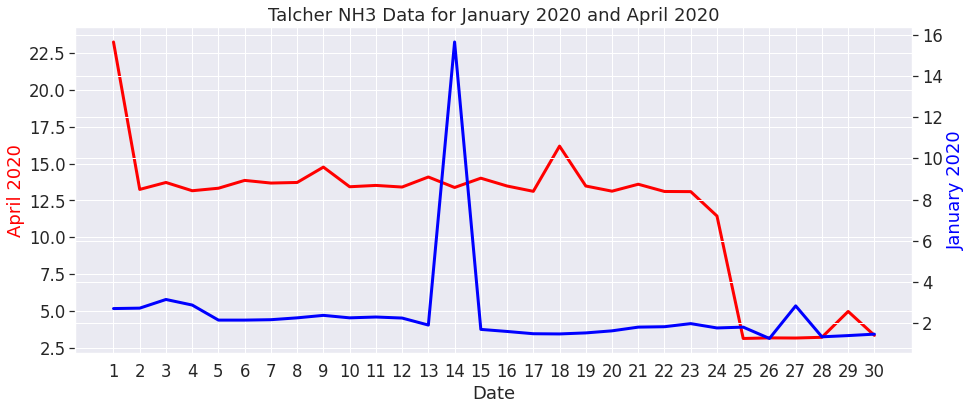

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Talcher'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Talcher'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Talcher NH3 Data for January 2020 and April 2020');

Thiruvanathapuram NH3 data

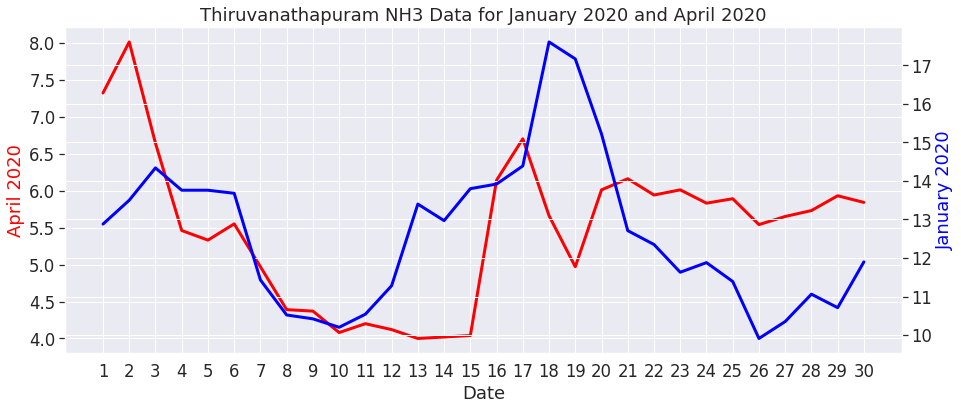

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Thiruvananthapuram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Thiruvananthapuram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Thiruvanathapuram NH3 Data for January 2020 and April 2020');

Visakhapatnam NH3 data

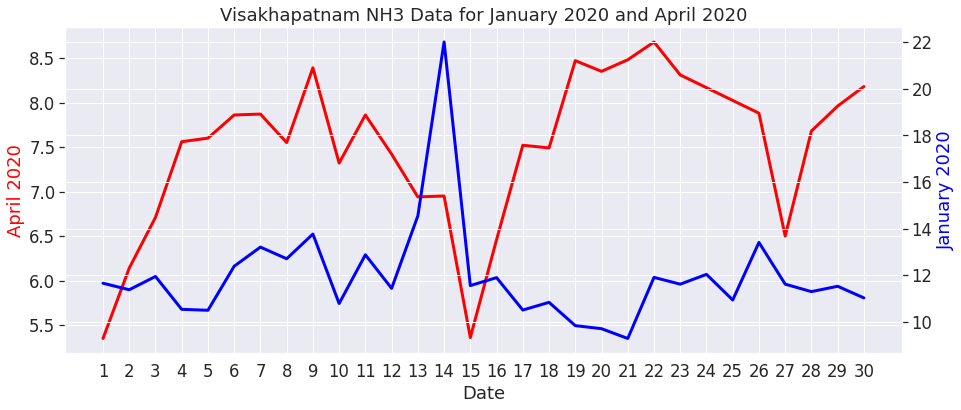

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNH3_Apr2020.index,dfNH3_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNH3_Jan2020.index,dfNH3_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam NH3 Data for January 2020 and April 2020');

### January 2020 and April 2020 'NOx' Data Check

In [ ]:
df_NOx = dfcity_day.pivot(index='Date', columns='City', values='CO')
df_NOx = df_NOx.fillna(df_NOx.mean())
dfNOx_Apr2020 = df_NOx.loc['2020-04-01':'2020-04-30']
dfNOx_Jan2020 = df_NOx.loc['2020-01-01':'2020-01-30']




Ahmedabad NOx data

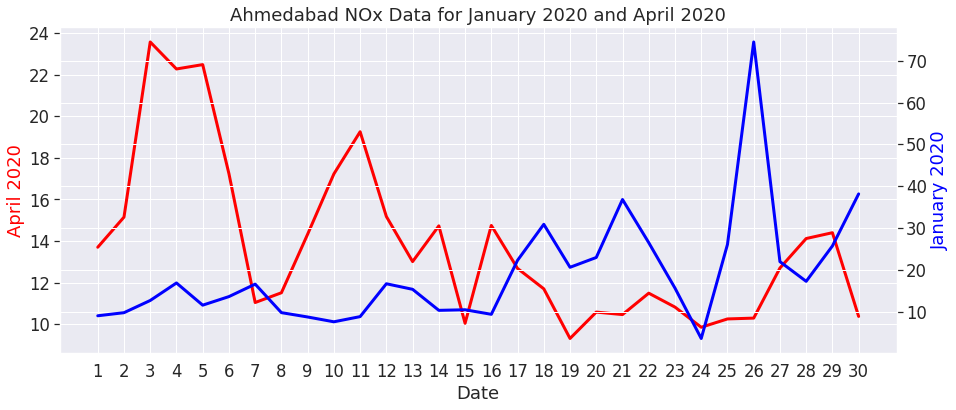

In [271]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad NOx Data for January 2020 and April 2020');

Aizawl NOx data

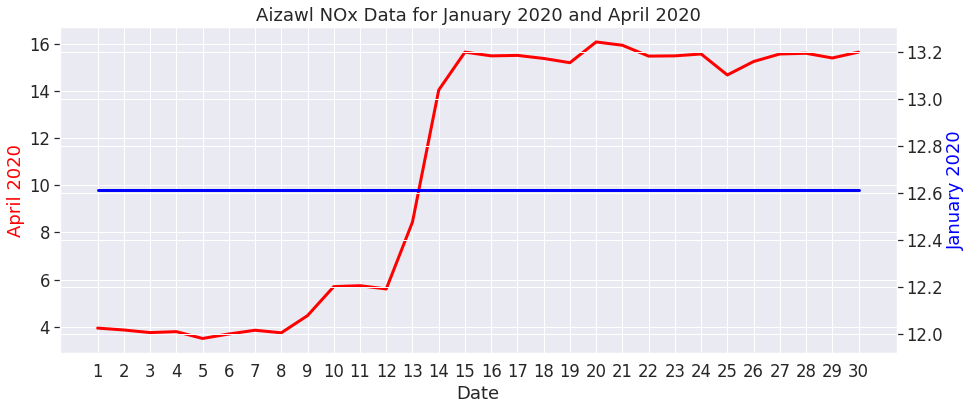

In [272]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Aizawl'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl NOx Data for January 2020 and April 2020');

Amaravati NOx data

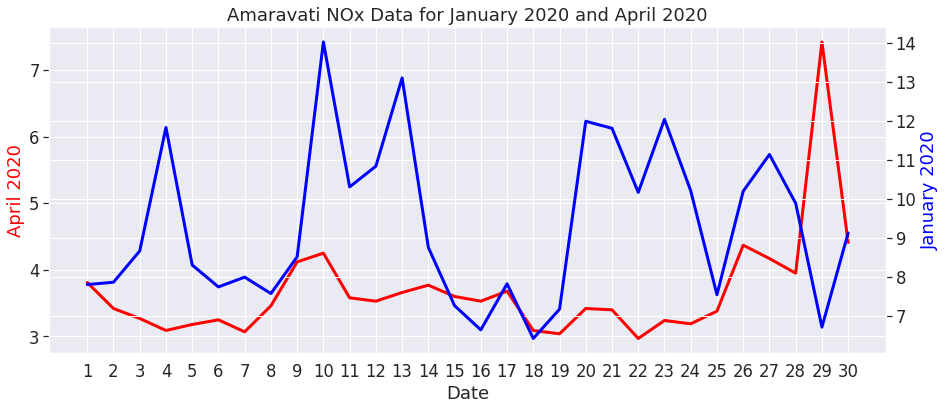

In [273]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Amaravati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati NOx Data for January 2020 and April 2020');

Amritsar NOx data

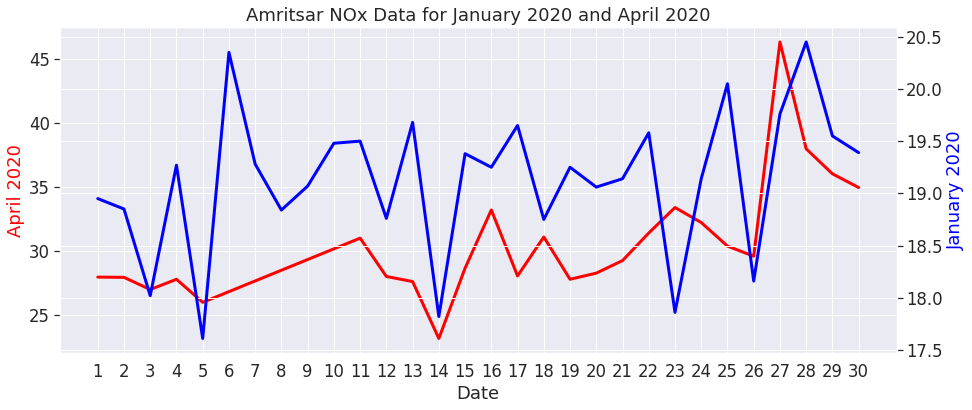

In [274]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar NOx Data for January 2020 and April 2020');

Bengaluru NOx data

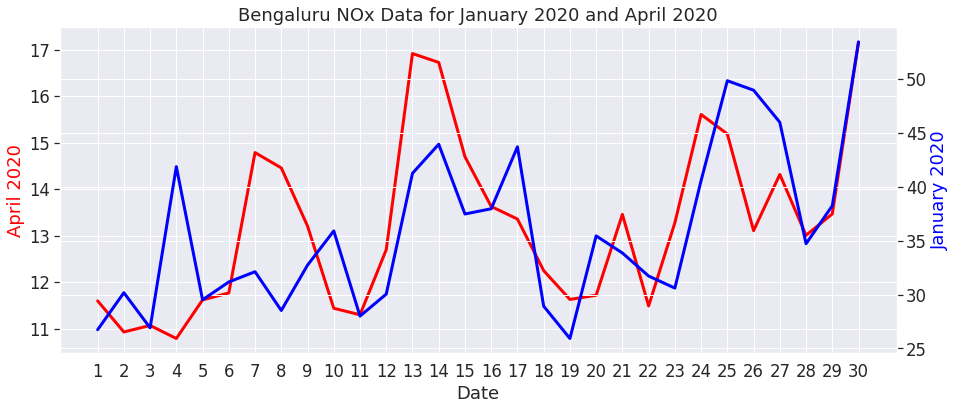

In [275]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru NOx Data for January 2020 and April 2020');

Bhopal NOx data

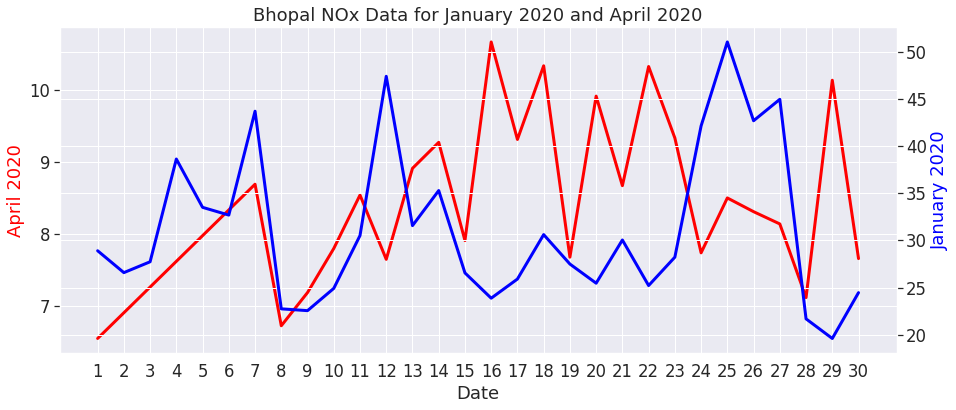

In [276]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal NOx Data for January 2020 and April 2020');

Chandigarh NOx data

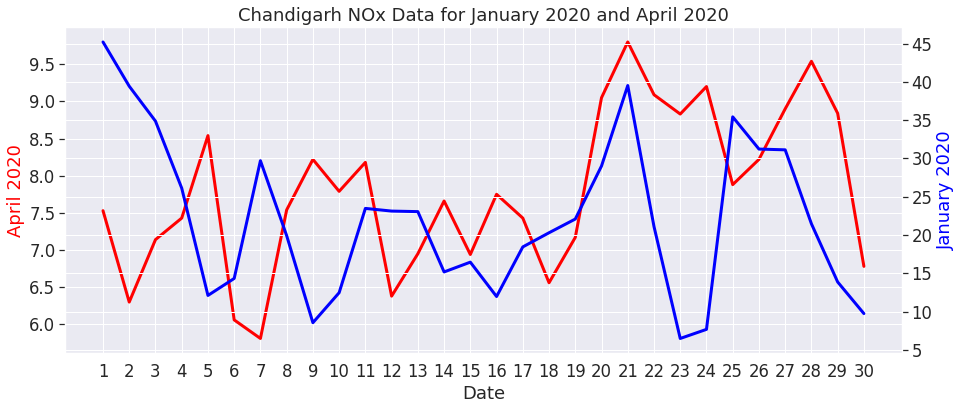

In [277]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Chandigarh'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh NOx Data for January 2020 and April 2020');

Chennai NOx data

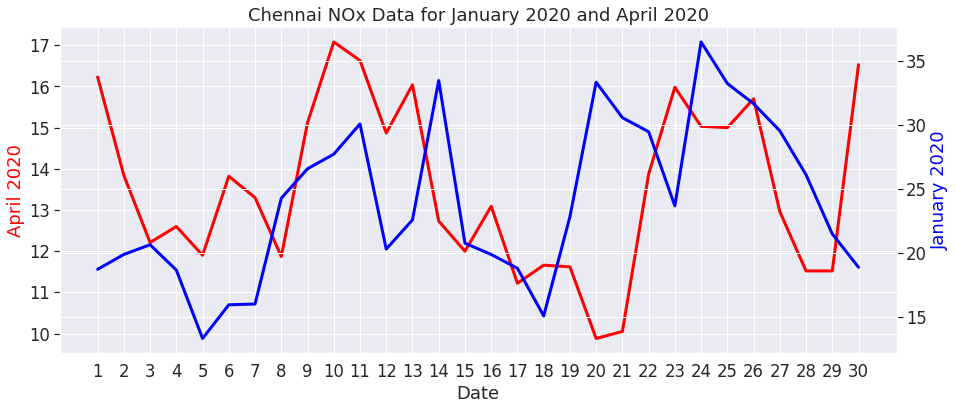

In [278]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Chennai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai NOx Data for January 2020 and April 2020');

Coimbatore NOx data

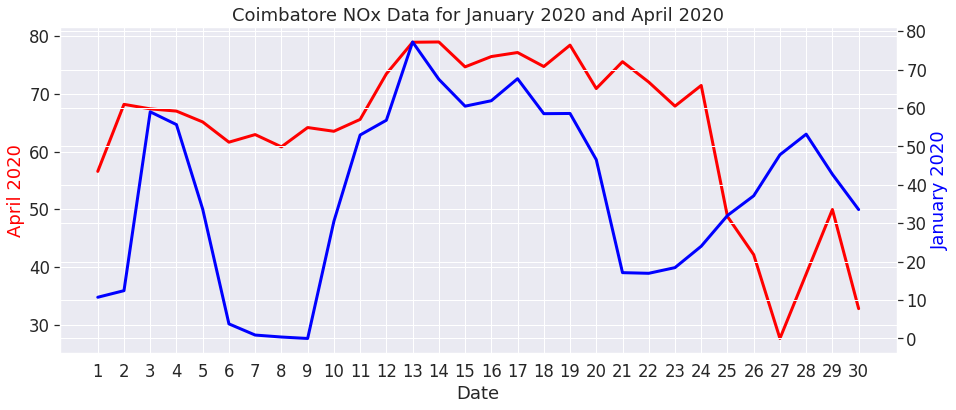

In [279]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Coimbatore'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore NOx Data for January 2020 and April 2020');

Delhi NOx data

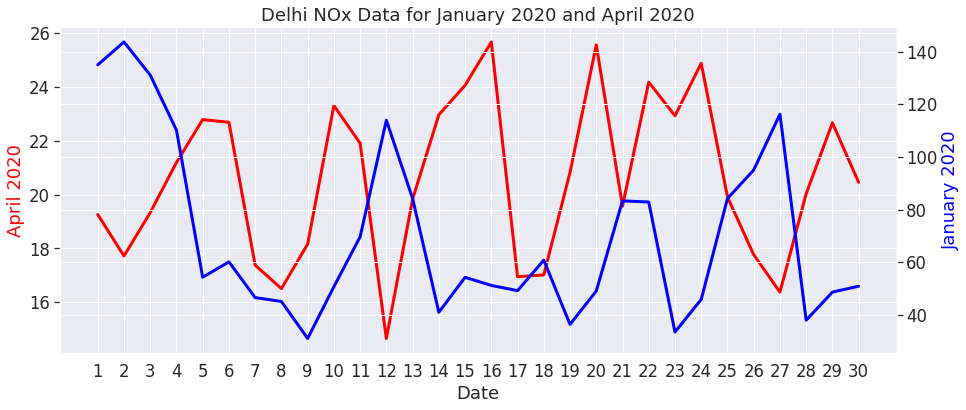

In [280]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Delhi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi NOx Data for January 2020 and April 2020');

Gurugram NOx data

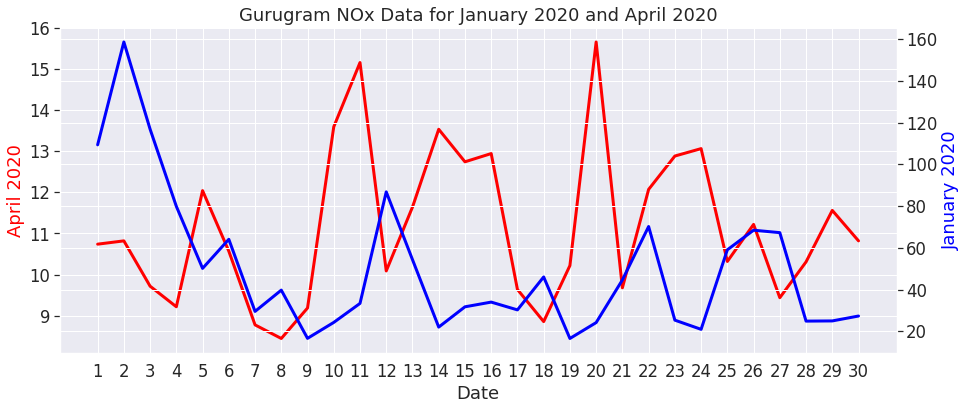

In [281]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Gurugram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram NOx Data for January 2020 and April 2020');

Guwahati NOx data

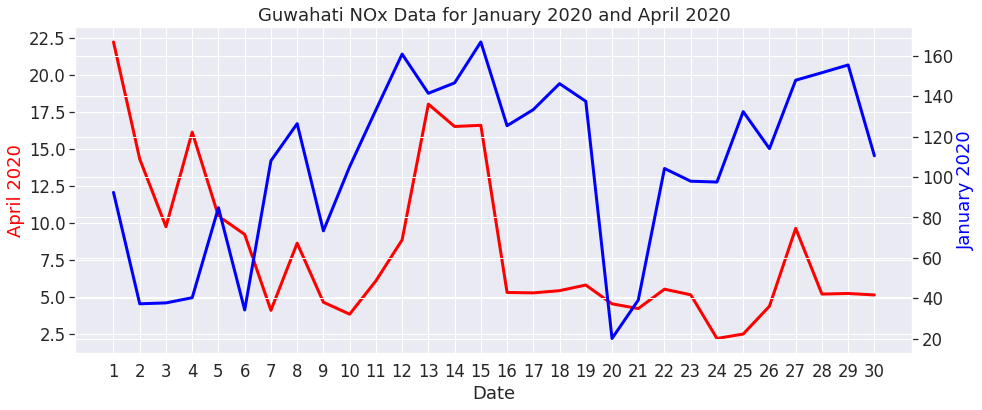

In [282]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati NOx Data for January 2020 and April 2020');

Hyderabad NOx data

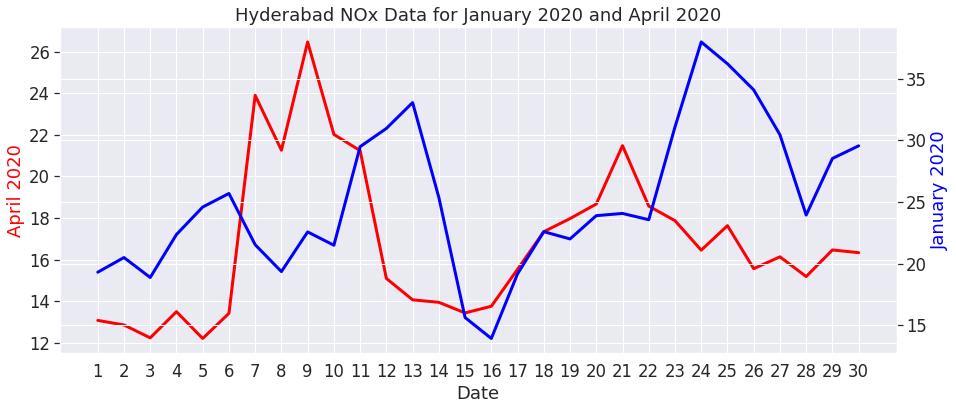

In [283]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Hyderabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Hyderabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad NOx Data for January 2020 and April 2020');

Jaipur NOx data

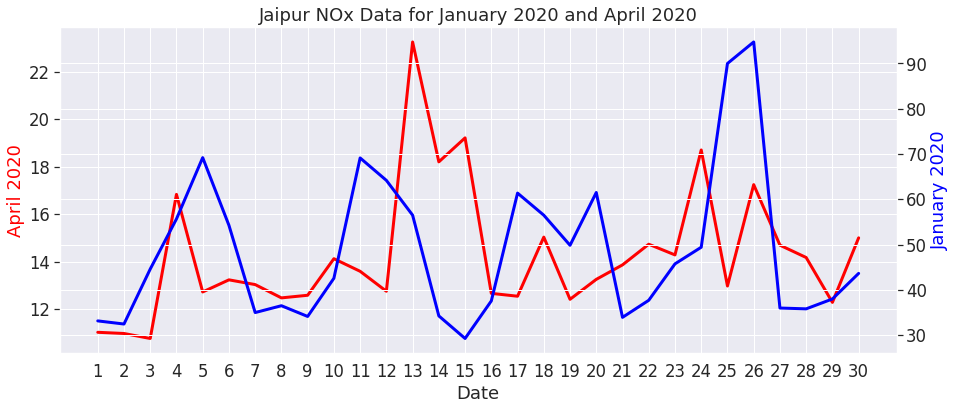

In [284]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Jaipur'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur NOx Data for January 2020 and April 2020');

Kochi NOx data

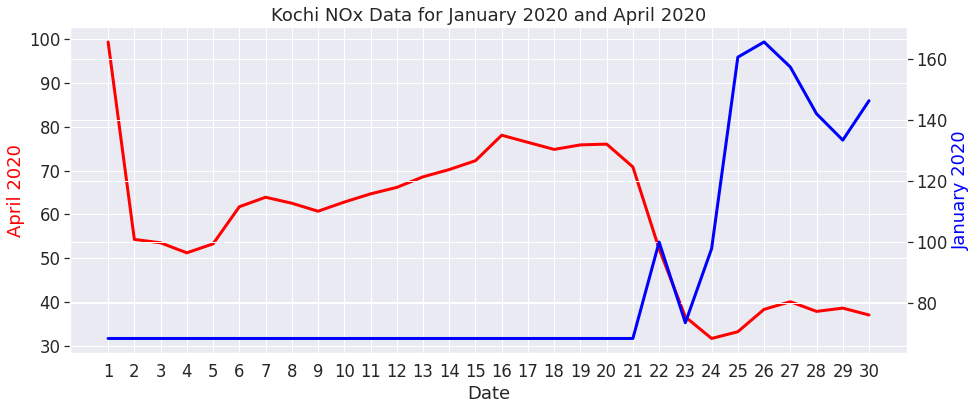

In [285]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Kochi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Kochi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kochi NOx Data for January 2020 and April 2020');

Kolkata NOx data

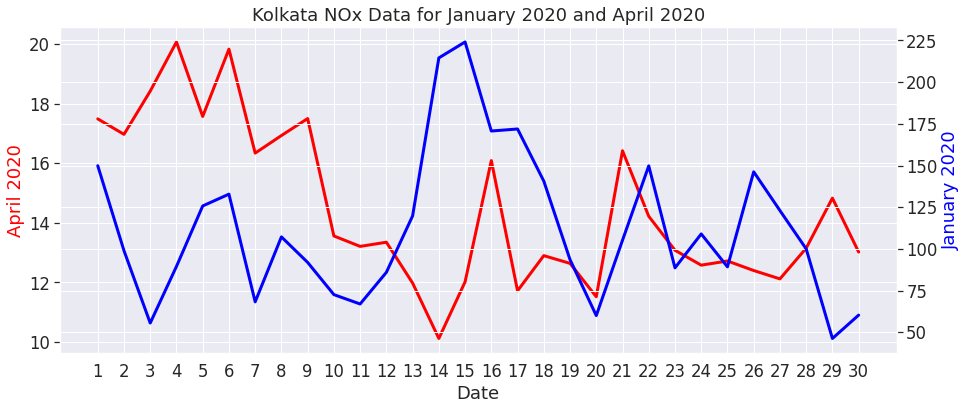

In [286]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Kolkata'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata NOx Data for January 2020 and April 2020');

Lucknow NOx data

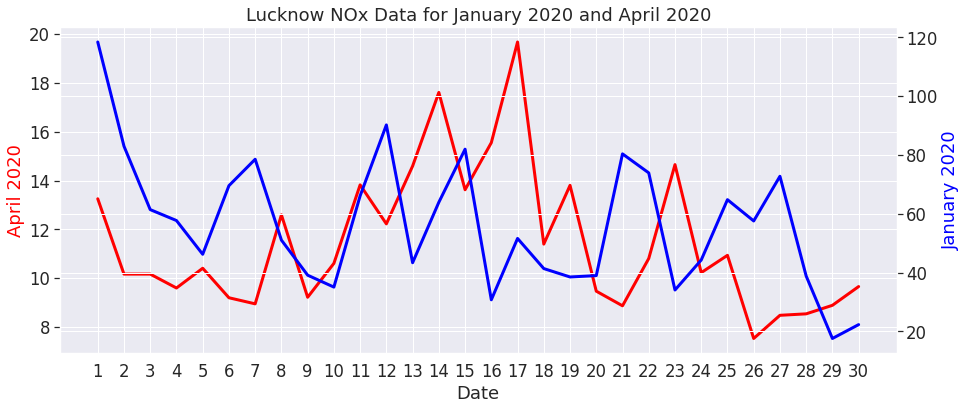

In [287]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Lucknow'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow NOx Data for January 2020 and April 2020');

Mumbai NOx data

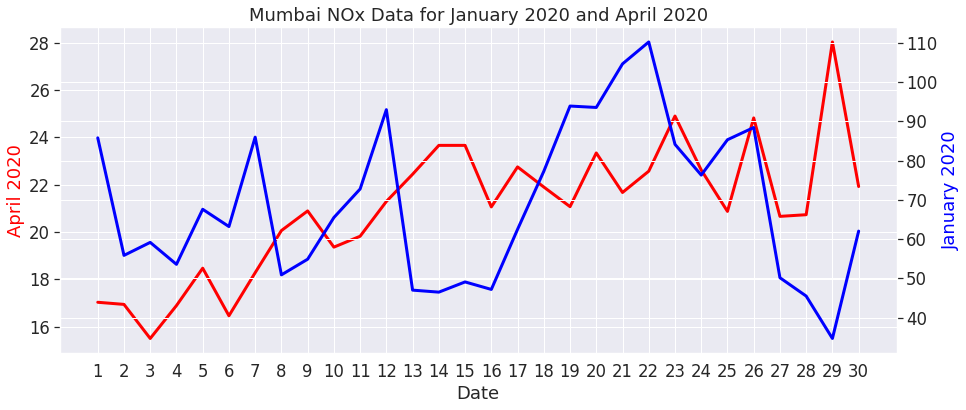

In [288]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Mumbai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai NOx Data for January 2020 and April 2020');

Patna NOx data

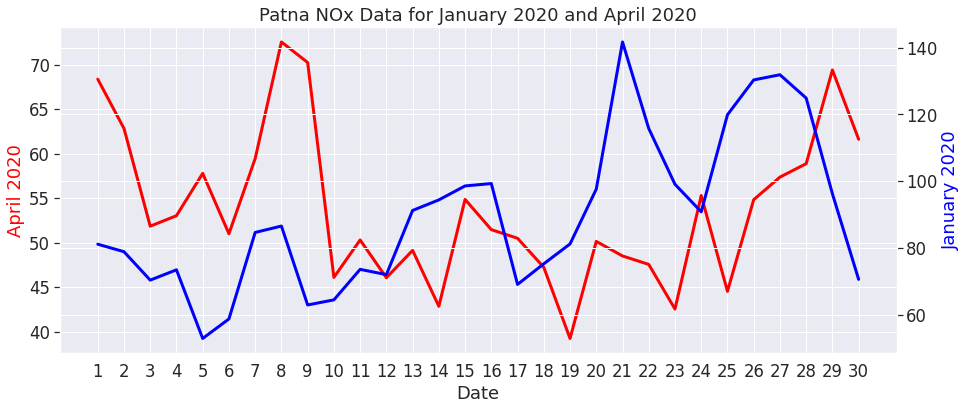

In [289]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna NOx Data for January 2020 and April 2020');

Shillong NOx data

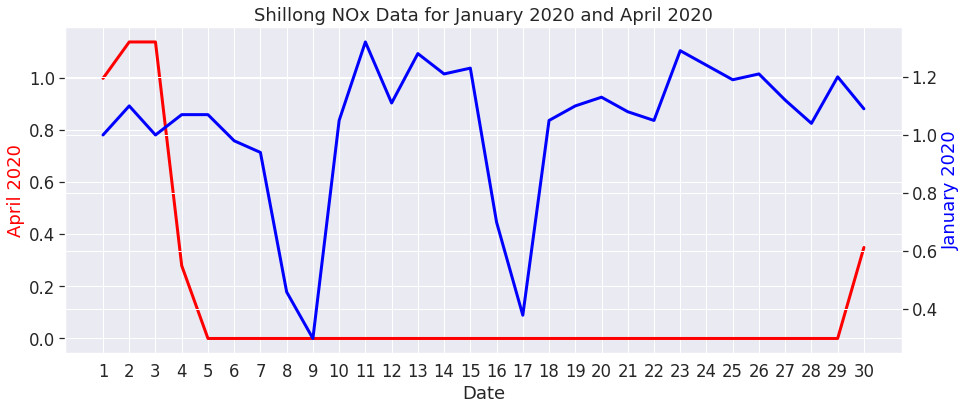

In [290]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Shillong'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong NOx Data for January 2020 and April 2020');

Talcher NOx data

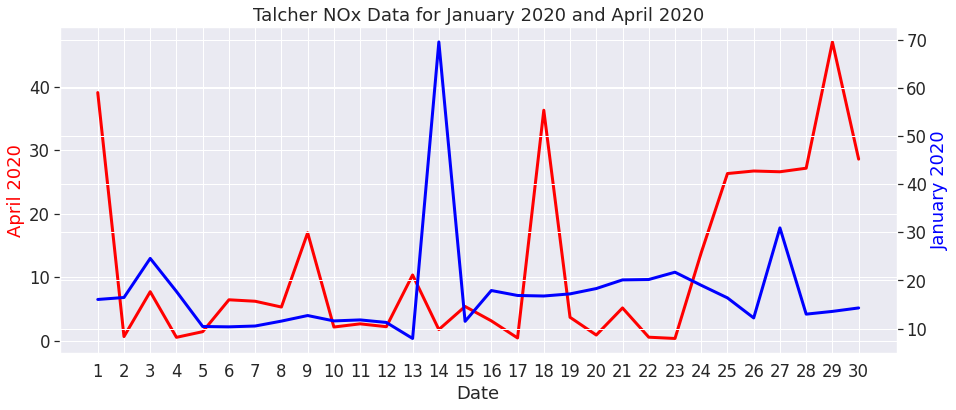

In [291]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Talcher'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Talcher'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Talcher NOx Data for January 2020 and April 2020');

Thiruvanathapuram NOx data

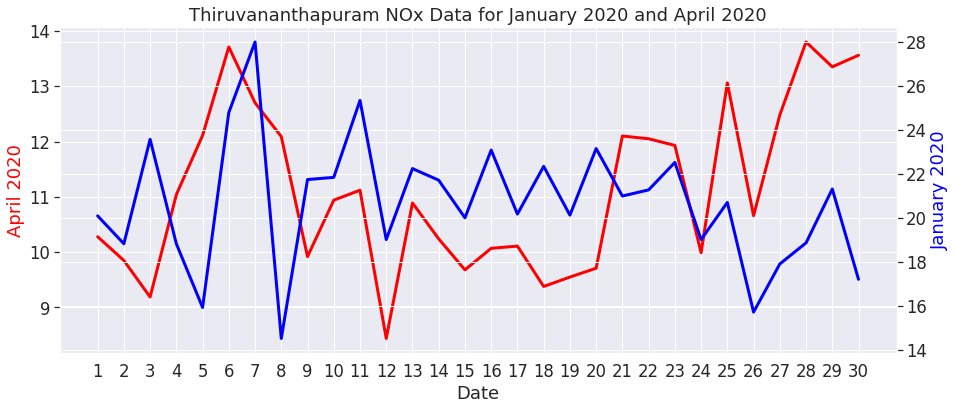

In [293]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Thiruvananthapuram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Thiruvananthapuram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Thiruvananthapuram NOx Data for January 2020 and April 2020');

Visakhapatnam NOx data

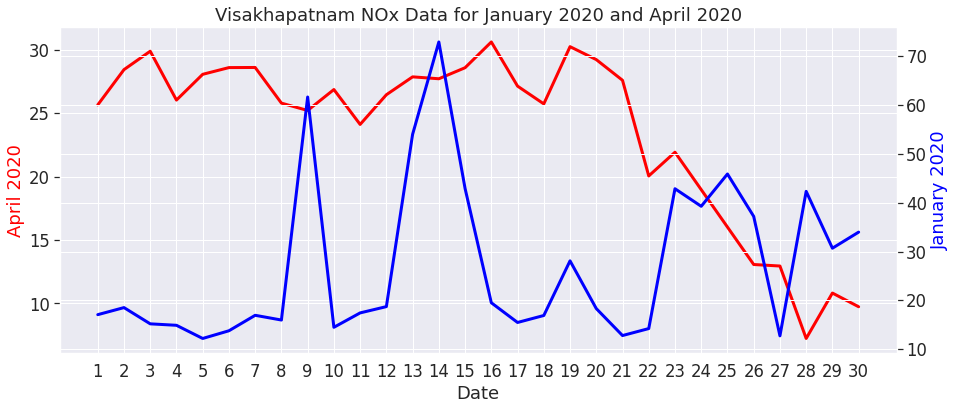

In [294]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNOx_Apr2020.index,dfNOx_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNOx_Jan2020.index,dfNOx_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam NOx Data for January 2020 and April 2020');

### January 2020 and April 2020 'Xylene' Data Check

In [ ]:
df_Xylene = dfcity_day.pivot(index='Date', columns='City', values='Xylene')
df_Xylene = df_NO2.fillna(df_Xylene.mean())
dfXylene_Apr2020 = df_Xylene.loc['2020-04-01':'2020-04-30']
dfXylene_Jan2020 = df_Xylene.loc['2020-01-01':'2020-01-30']

Ahmedabad Xylene data

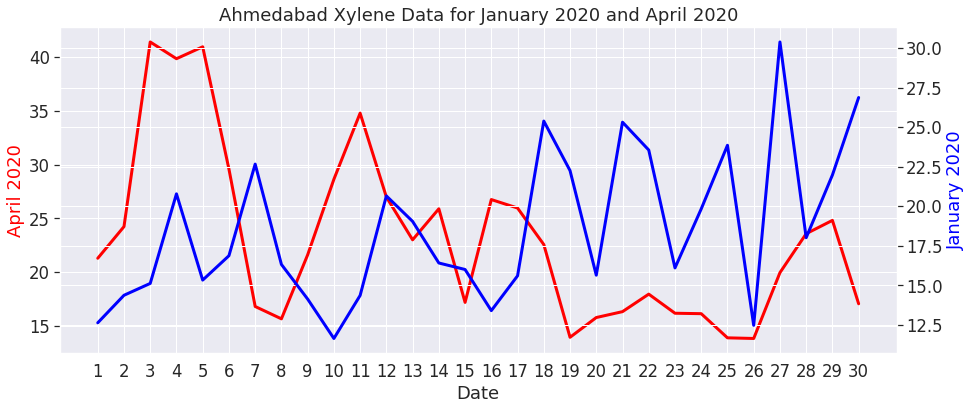

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfXylene_Apr2020.index,dfXylene_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfXylene_Jan2020.index,dfXylene_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad Xylene Data for January 2020 and April 2020');

Aizawl Xylene data

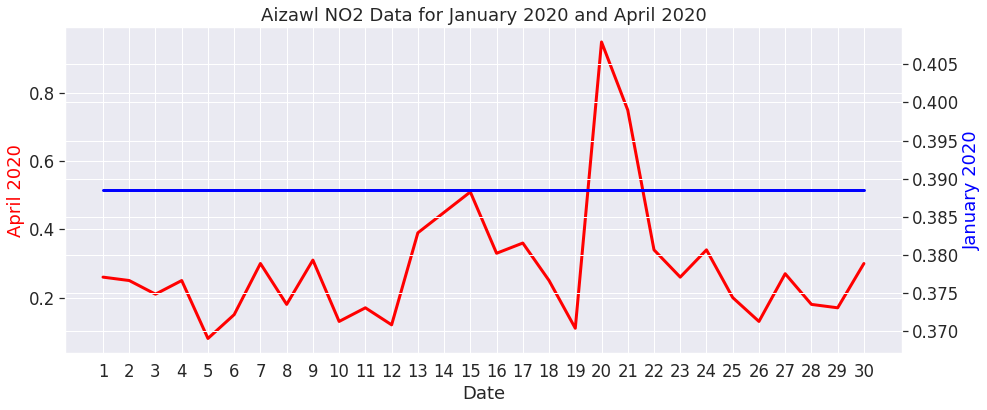

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfXylene_Apr2020.index,dfNO2_Apr2020['Aizawl'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl NO2 Data for January 2020 and April 2020');

Amaravati NO2 data

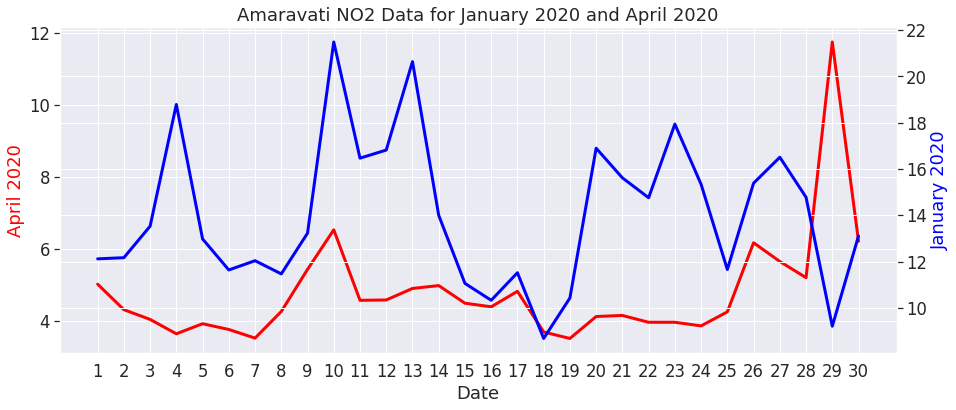

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Amaravati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati NO2 Data for January 2020 and April 2020');

Amritsar NO2 data

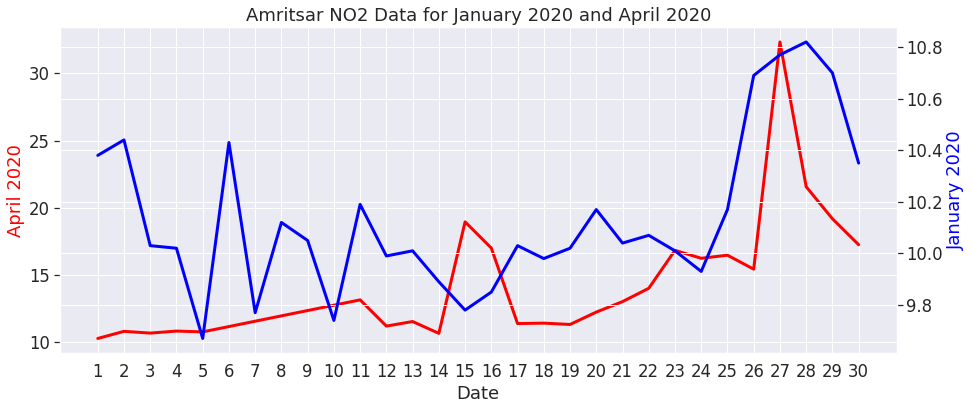

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar NO2 Data for January 2020 and April 2020');

Bengaluru NO2 data

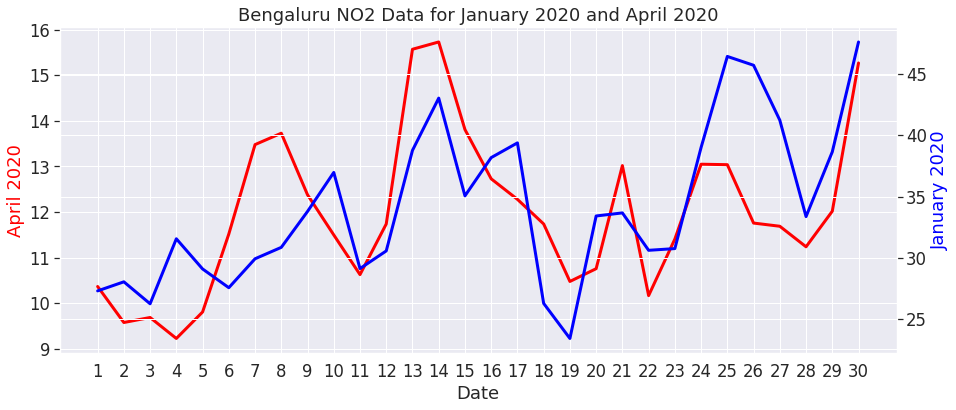

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru NO2 Data for January 2020 and April 2020');

Bhopal NO2 data

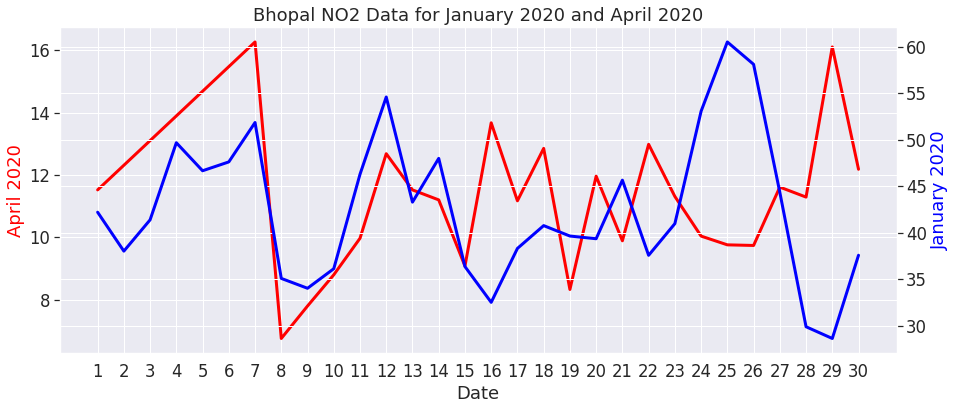

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal NO2 Data for January 2020 and April 2020');

Chandigarh NO2 data

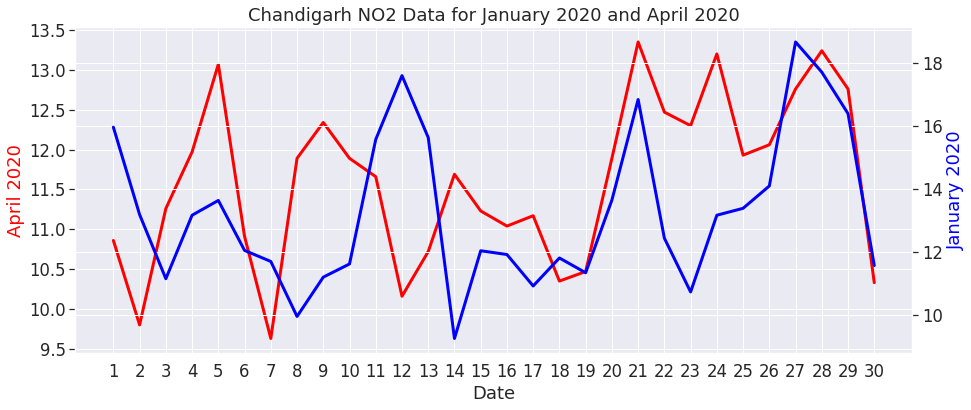

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Chandigarh'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh NO2 Data for January 2020 and April 2020');

Chennai NO2 data

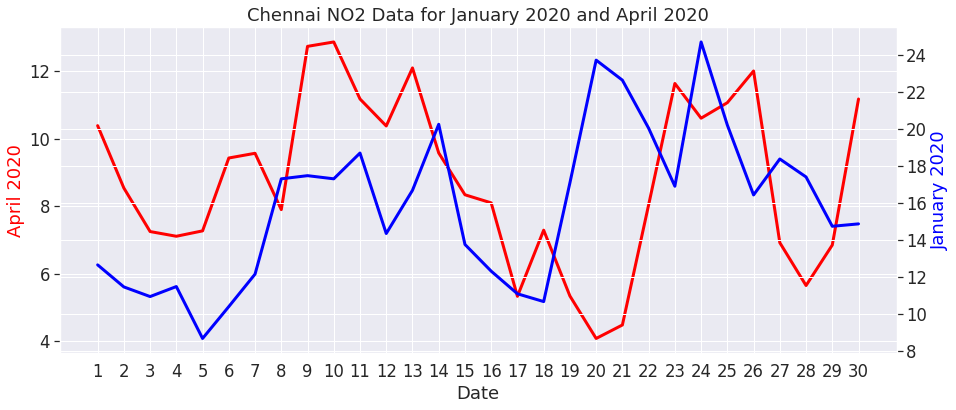

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Chennai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai NO2 Data for January 2020 and April 2020');

Coimbatore NO2 data

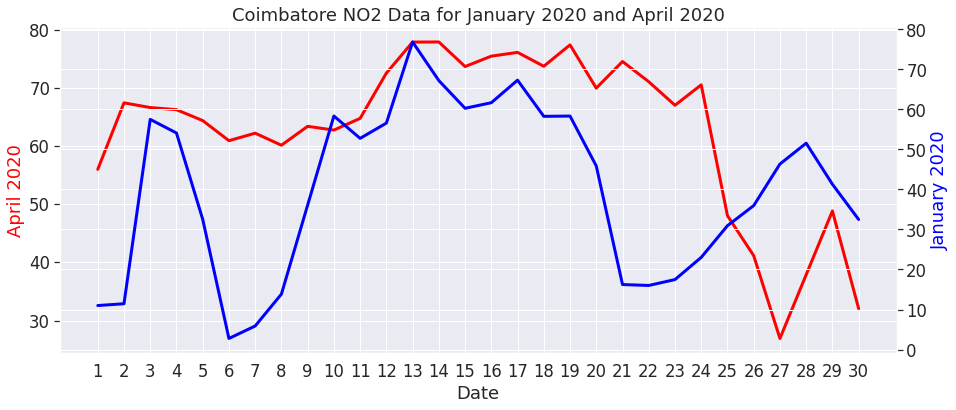

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Coimbatore'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore NO2 Data for January 2020 and April 2020');

Delhi NO2 data

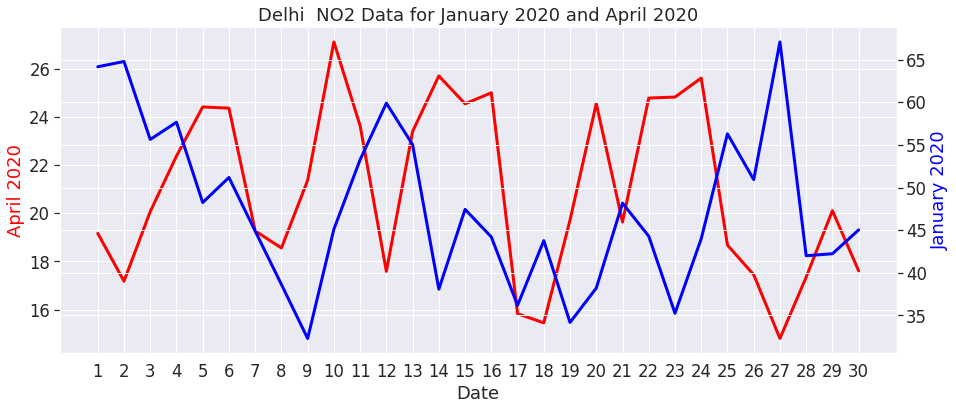

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Delhi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi  NO2 Data for January 2020 and April 2020');

Ernakulam NO2 data

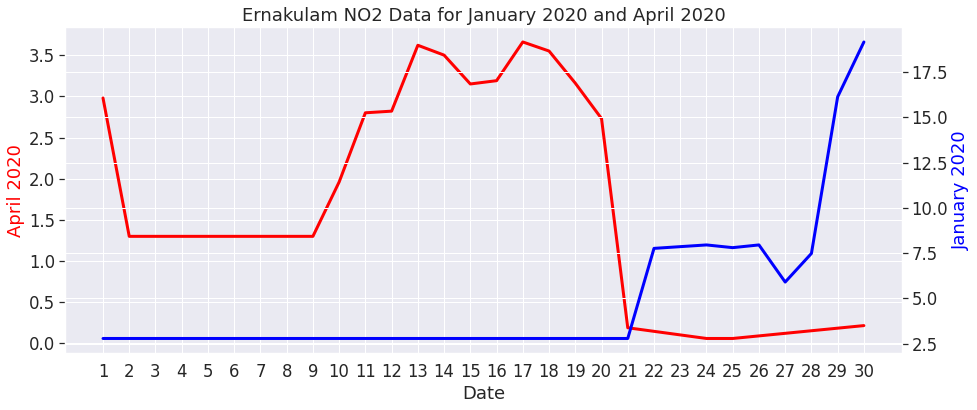

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Ernakulam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Ernakulam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ernakulam NO2 Data for January 2020 and April 2020');

Gurugram NO2 data

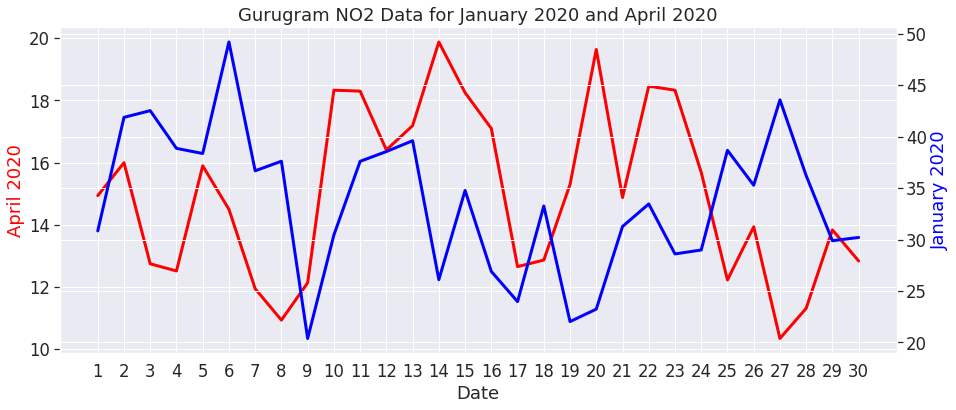

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Gurugram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram NO2 Data for January 2020 and April 2020');

Guwahati NO2 data

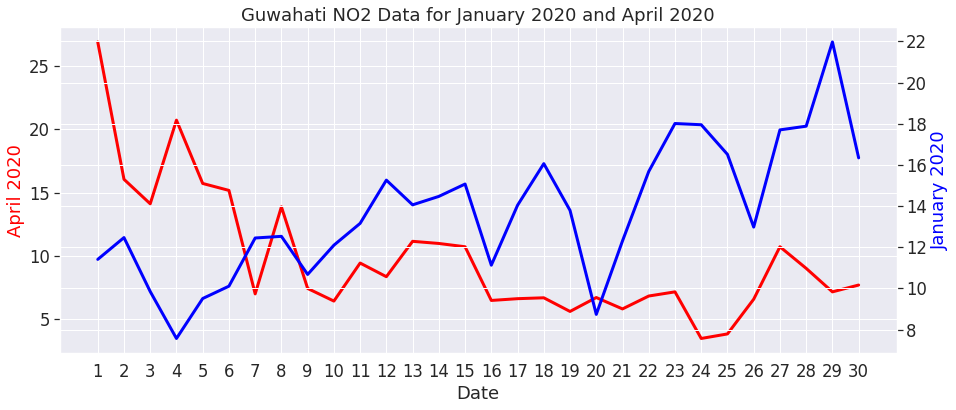

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati NO2 Data for January 2020 and April 2020');

Hyderabad NO2 data

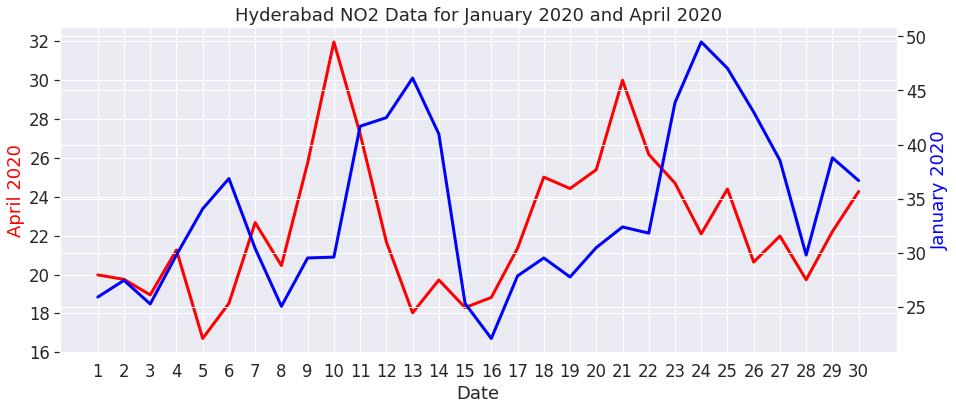

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Hyderabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Hyderabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad NO2 Data for January 2020 and April 2020');

Jaipur NO2 data

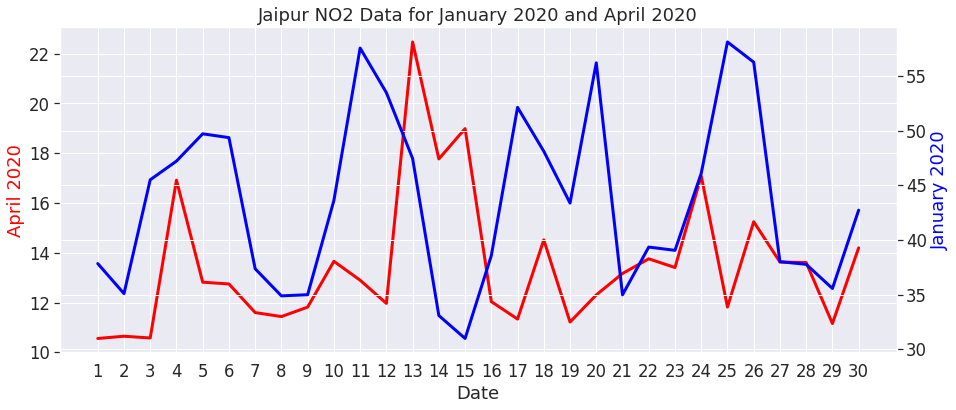

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Jaipur'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur NO2 Data for January 2020 and April 2020');

Kolkata NO2 data

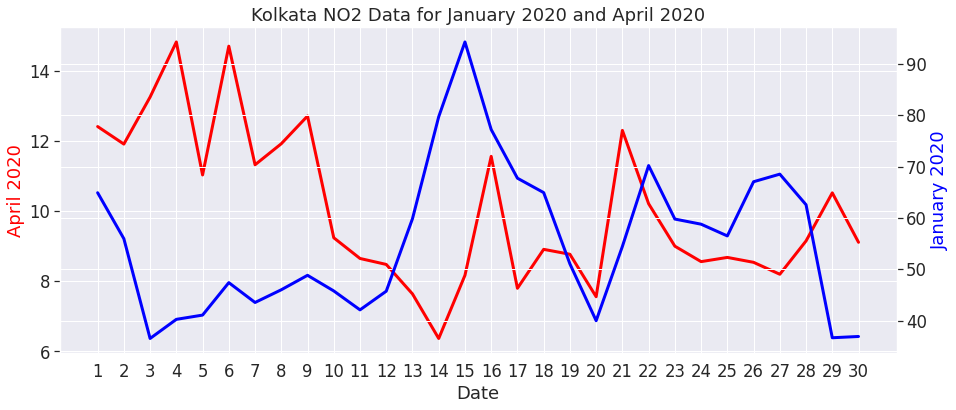

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Kolkata'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata NO2 Data for January 2020 and April 2020');

Lucknow NO2 data

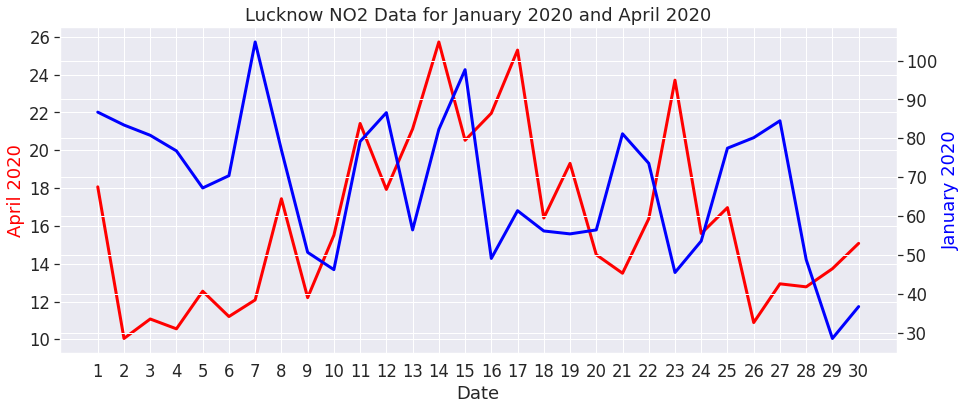

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Lucknow'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow NO2 Data for January 2020 and April 2020');

Mumbai NO2 data

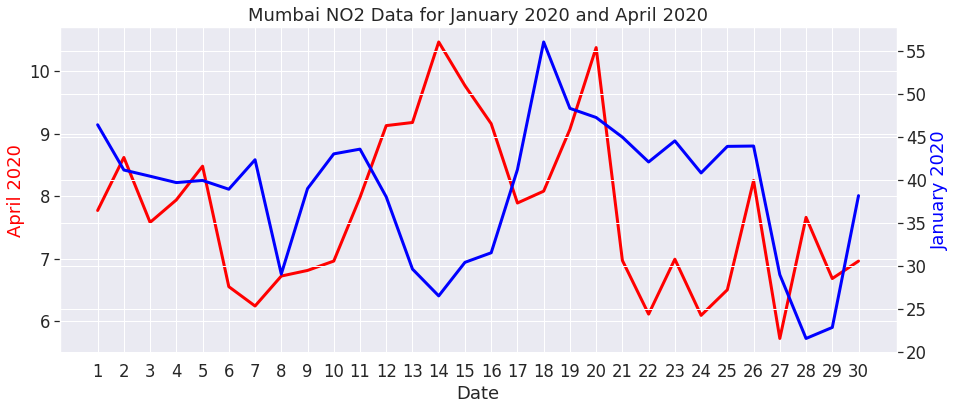

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Mumbai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai NO2 Data for January 2020 and April 2020');

Patna NO2 data

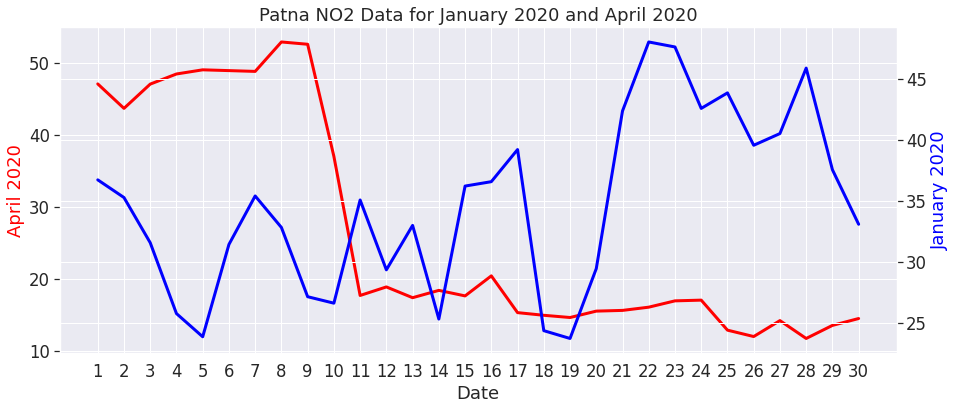

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna NO2 Data for January 2020 and April 2020');

Shillong NO2 data

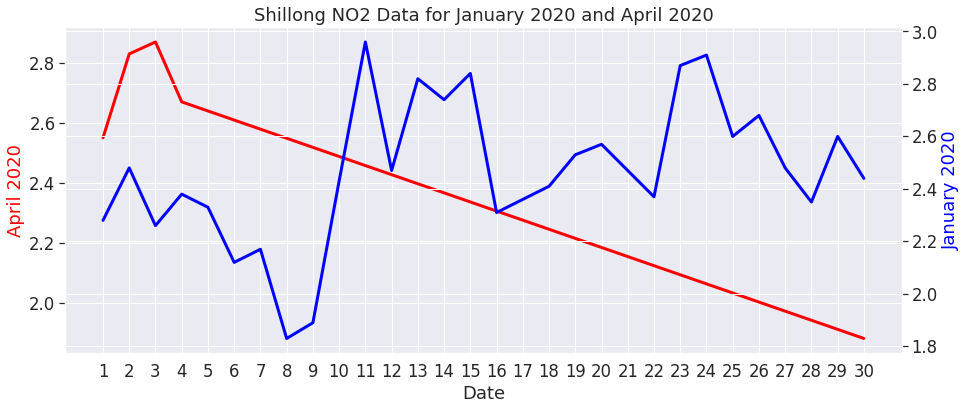

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Shillong'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong NO2 Data for January 2020 and April 2020');

Talcher NO2 data

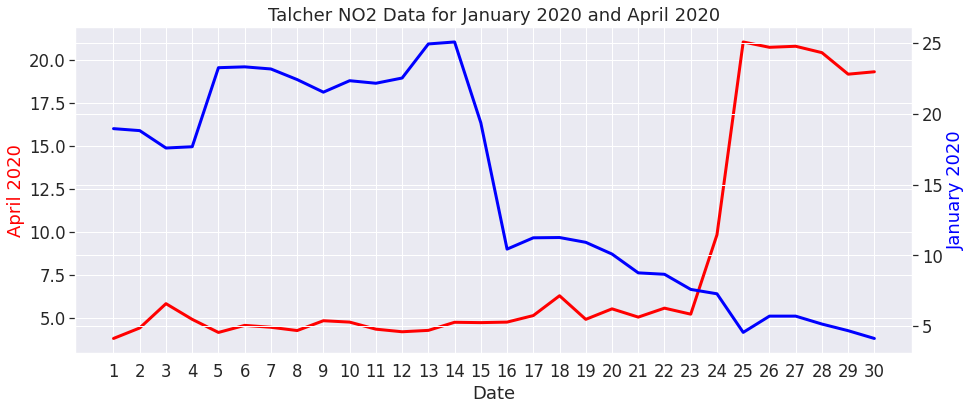

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Talcher'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Talcher'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Talcher NO2 Data for January 2020 and April 2020');

Thiruvananthapuram NO2 data

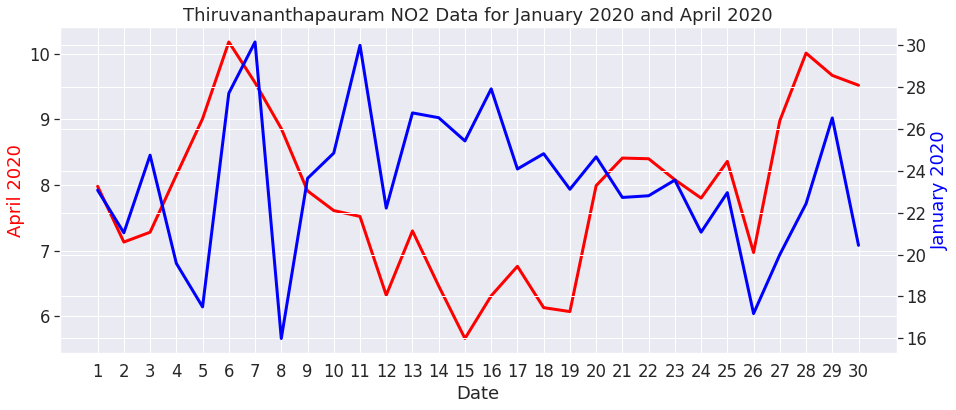

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Thiruvananthapuram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Thiruvananthapuram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Thiruvananthapauram NO2 Data for January 2020 and April 2020');

Visakhapatnam NO2 data

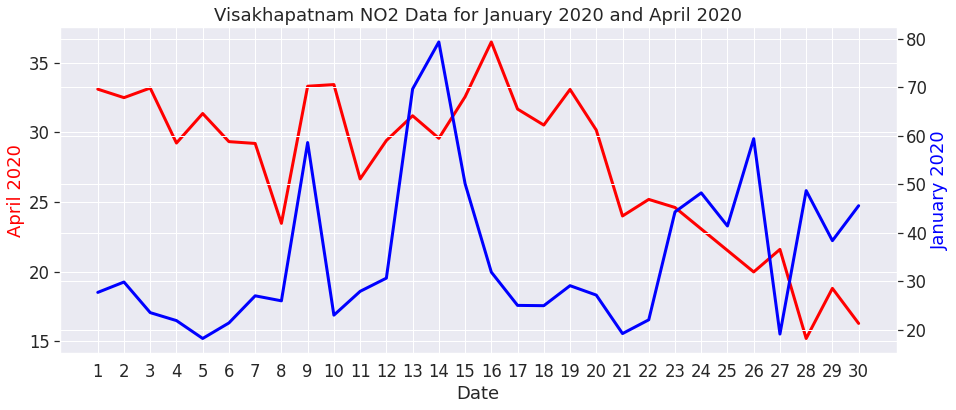

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfNO2_Apr2020.index,dfNO2_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfNO2_Jan2020.index,dfNO2_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam NO2 Data for January 2020 and April 2020');

### January 2020 and April 2020 'Benzene' Data Check

In [ ]:
df_Benzene = dfcity_day.pivot(index='Date', columns='City', values='Benzene')
df_Benzene = df_Benzene.fillna(df_Benzene.mean())
dfBenzene_Apr2020 = df_Benzene.loc['2020-04-01':'2020-04-30']
dfBenzene_Jan2020 = df_Benzene.loc['2020-01-01':'2020-01-30']

Ahmedabad Benzene data

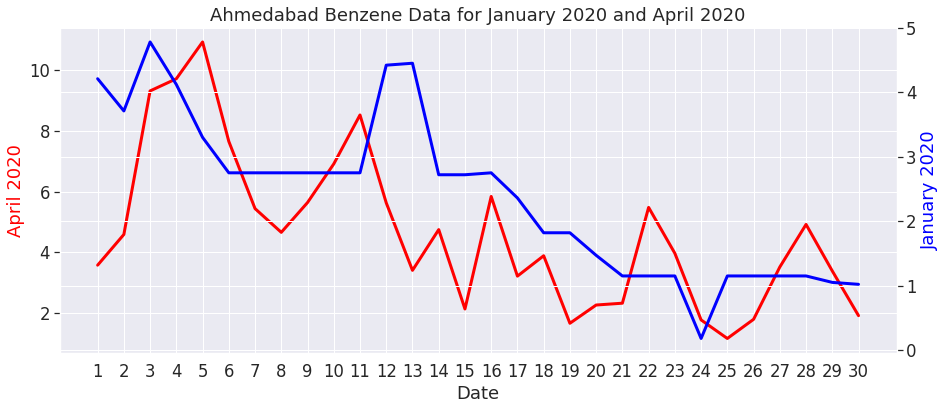

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad Benzene Data for January 2020 and April 2020');

Aizawl Benzene data

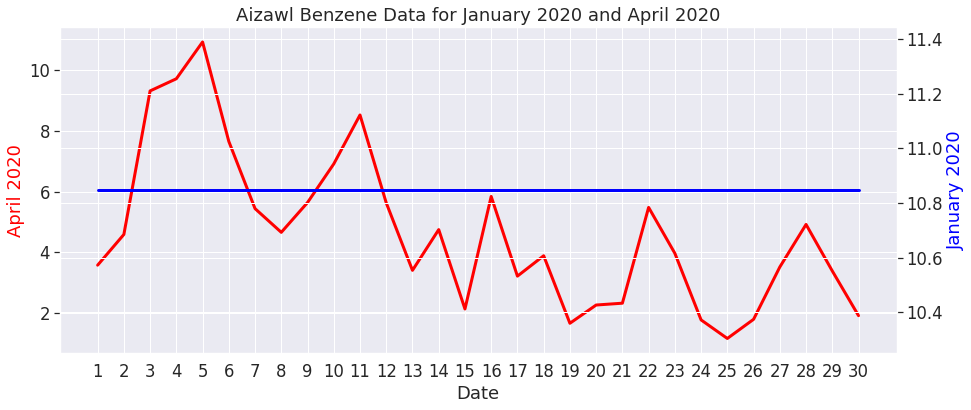

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl Benzene Data for January 2020 and April 2020');

Amritsar Benzene data

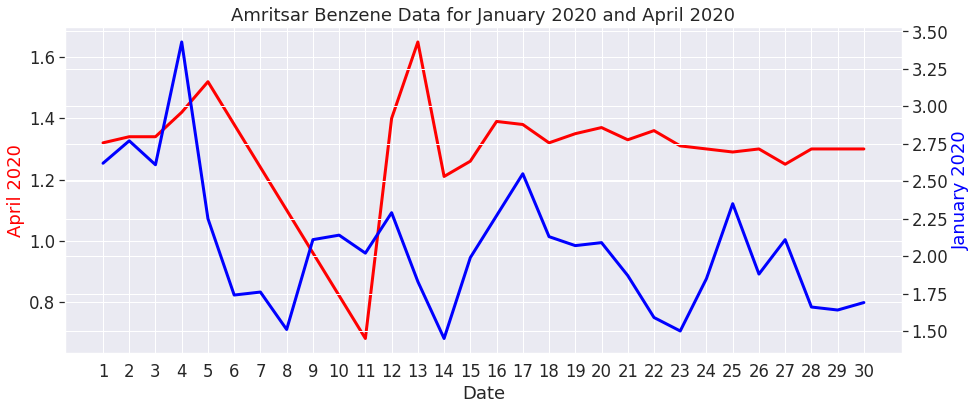

In [219]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar Benzene Data for January 2020 and April 2020');

Bengaluru Benzene data

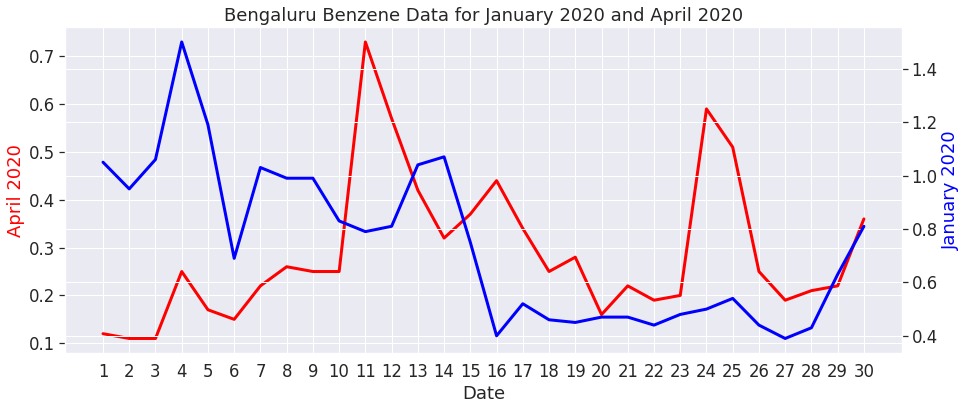

In [220]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru Benzene Data for January 2020 and April 2020');

Bhopal Benzene data

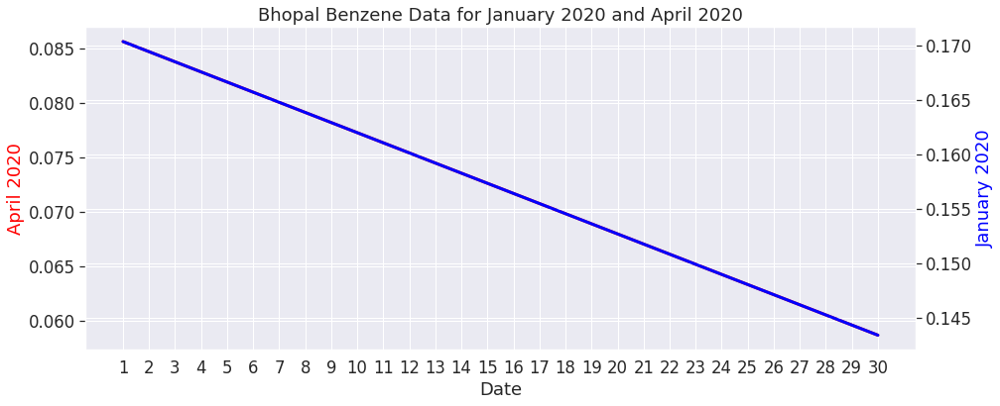

In [221]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal Benzene Data for January 2020 and April 2020');

Chandigarh Benzene data

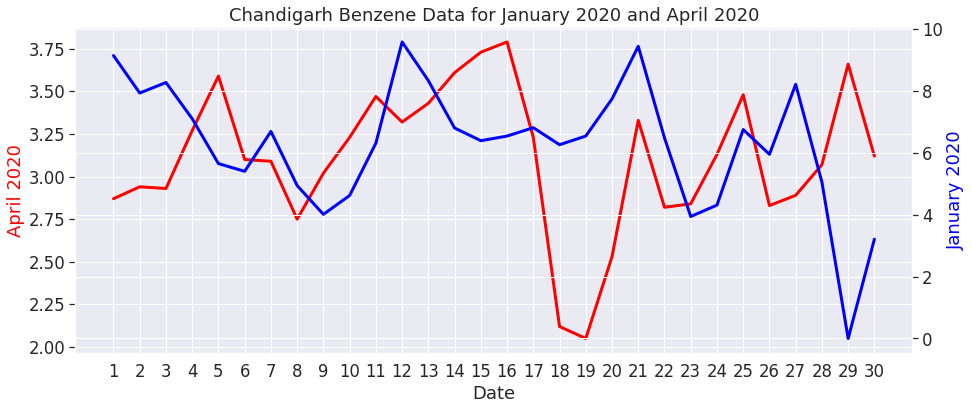

In [222]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Chandigarh'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh Benzene Data for January 2020 and April 2020');

Chennai Benzene data

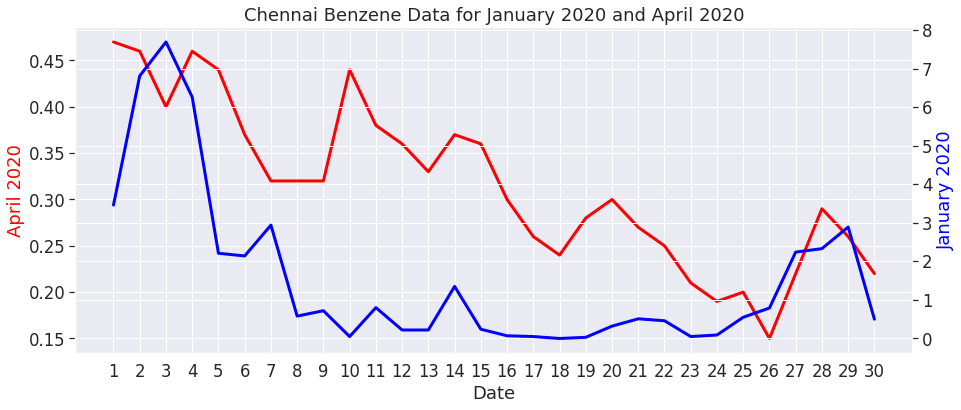

In [223]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Chennai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai Benzene Data for January 2020 and April 2020');

Coimbatore Benzene data

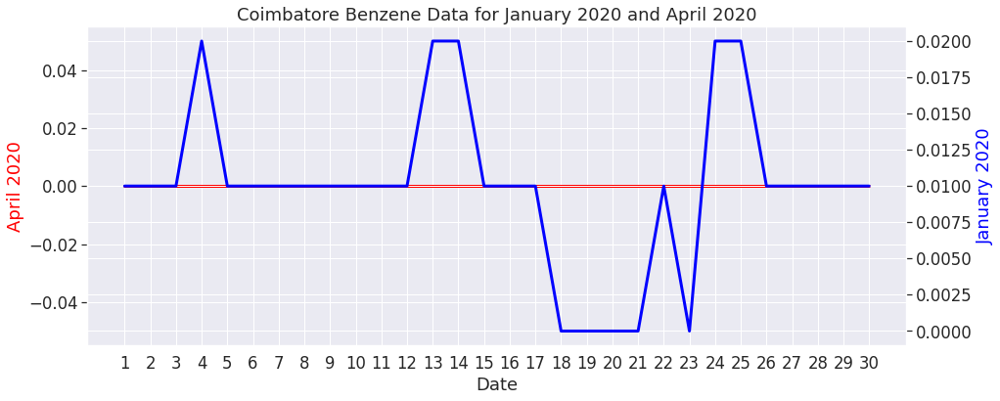

In [224]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Coimbatore'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore Benzene Data for January 2020 and April 2020');

Delhi Benzene data

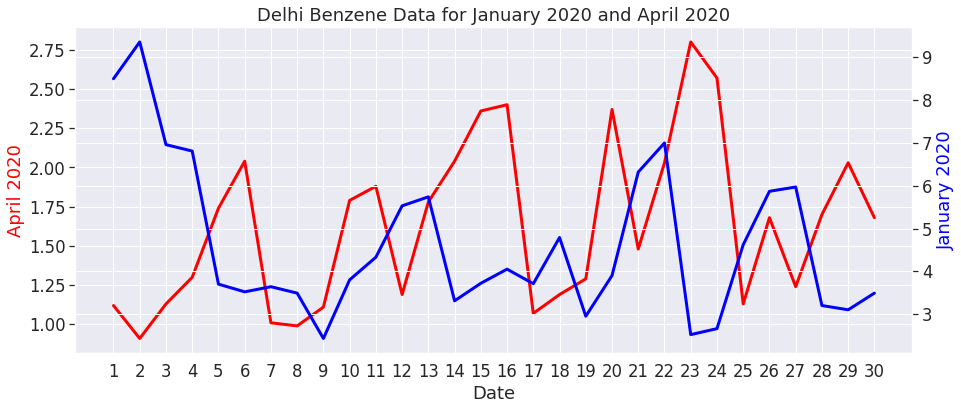

In [225]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Delhi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi Benzene Data for January 2020 and April 2020');

Ernakulam Benzene data

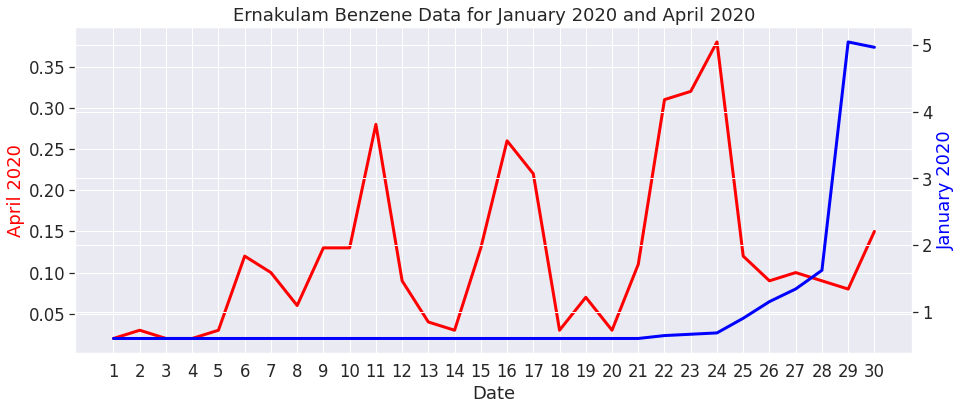

In [226]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Ernakulam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Ernakulam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ernakulam Benzene Data for January 2020 and April 2020');

Gurugram Benzene data

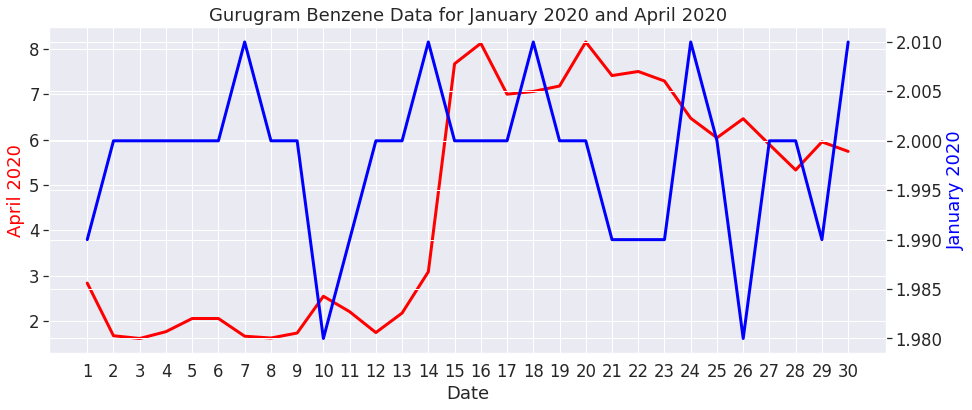

In [227]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Gurugram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram Benzene Data for January 2020 and April 2020');

Guwahati Benzene data

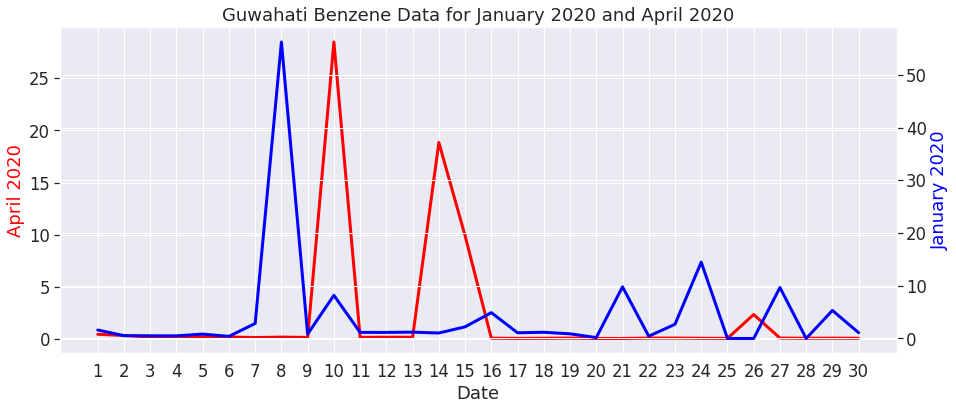

In [228]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati Benzene Data for January 2020 and April 2020');

Hyderabad Benzene data

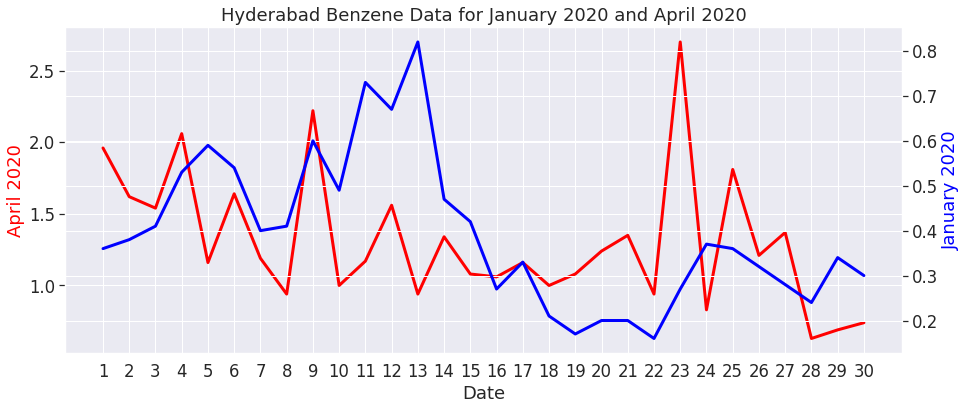

In [229]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Hyderabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Hyderabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad Benzene Data for January 2020 and April 2020');

Jaipur Benzene data

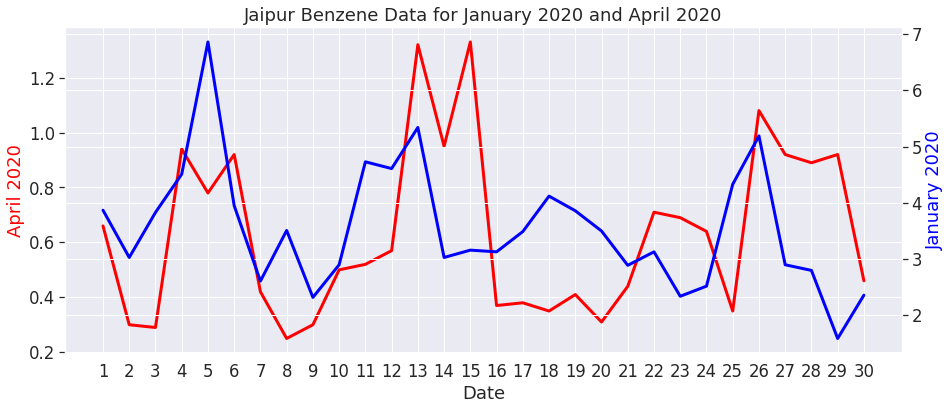

In [230]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Jaipur'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur Benzene Data for January 2020 and April 2020');

Kochi Benzene data

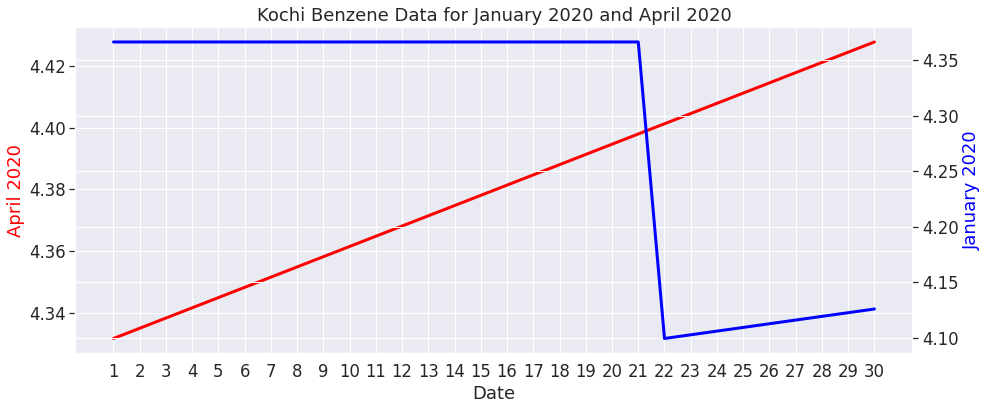

In [231]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Kochi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Kochi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kochi Benzene Data for January 2020 and April 2020');

Kolkata Benzene data

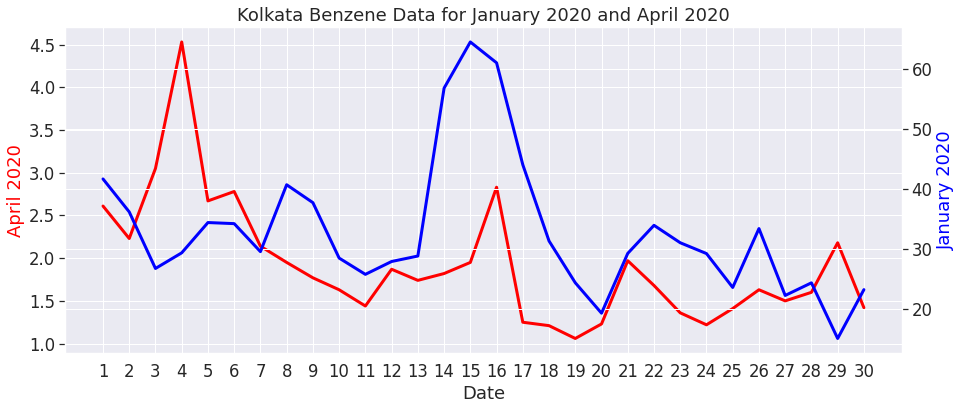

In [232]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Kolkata'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata Benzene Data for January 2020 and April 2020');

Lucknow Benzene data

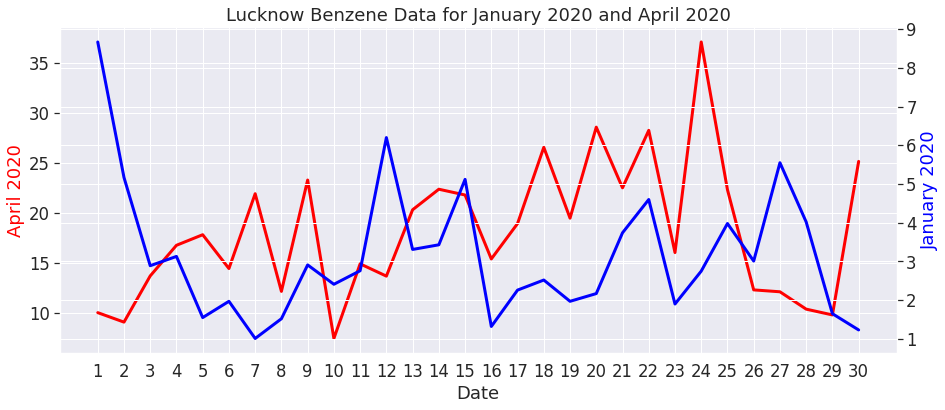

In [233]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Lucknow'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow Benzene Data for January 2020 and April 2020');

Mumbai Benzene data

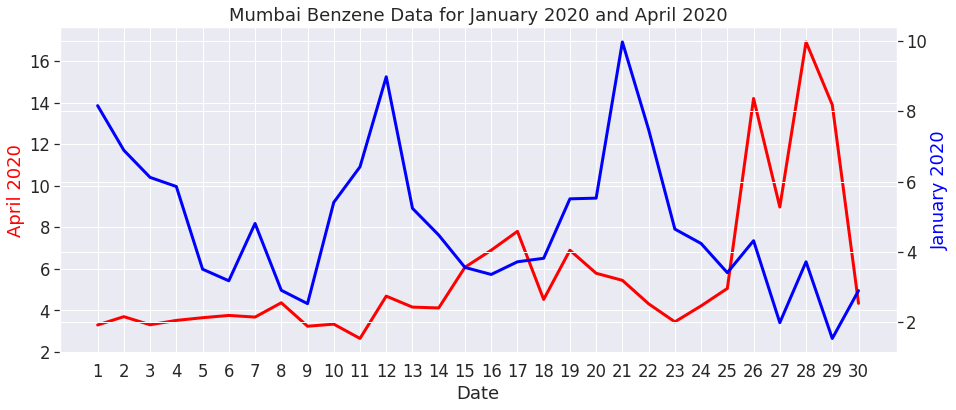

In [234]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Mumbai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai Benzene Data for January 2020 and April 2020');

Patna Benzene data

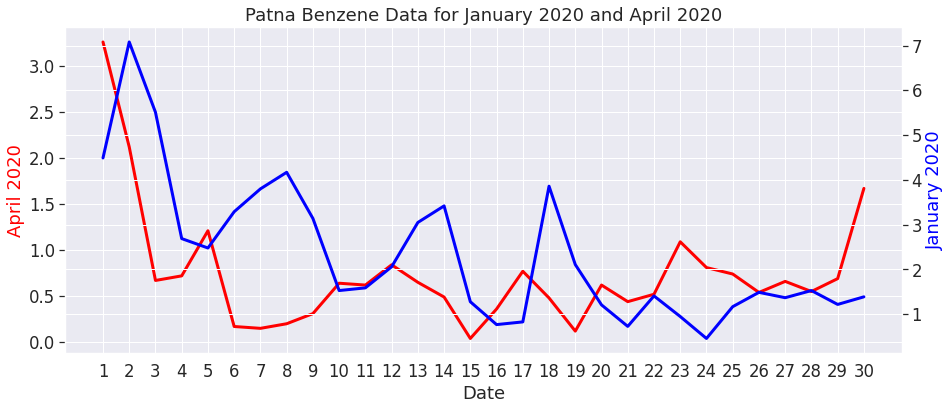

In [235]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna Benzene Data for January 2020 and April 2020');

Shillong Benzene data

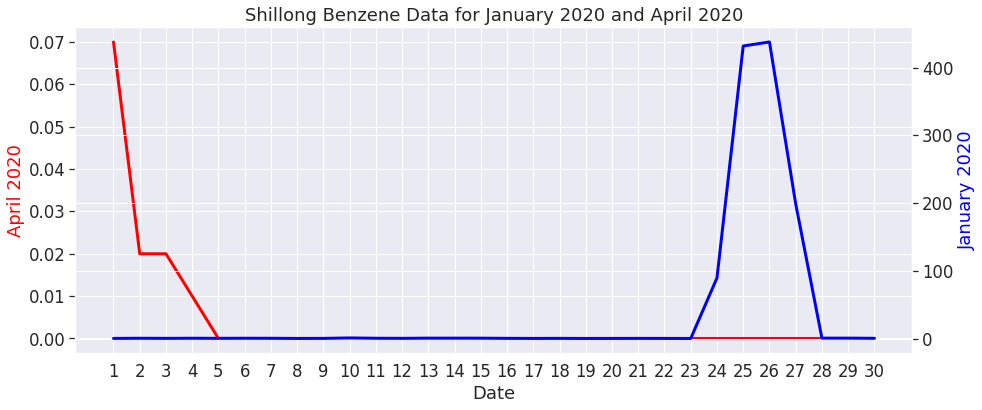

In [236]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Shillong'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong Benzene Data for January 2020 and April 2020');

Thiruvananthapuram Benzene data

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru Benzene Data for January 2020 and April 2020');

Visakhapatnam Benzene data

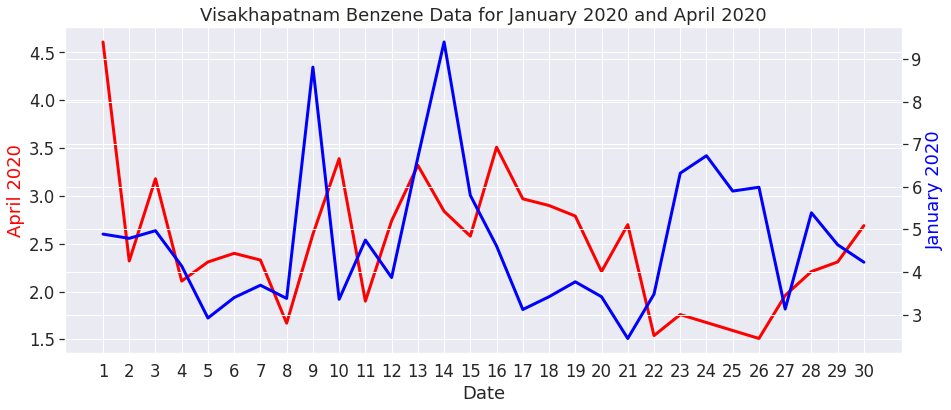

In [237]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfBenzene_Apr2020.index,dfBenzene_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfBenzene_Jan2020.index,dfBenzene_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam Benzene Data for January 2020 and April 2020');

### January 2020 and April 2020 'Toluene' Data Check

In [ ]:
df_Toluene = dfcity_day.pivot(index='Date', columns='City', values='Toluene')
df_Toluene = df_NO2.fillna(df_Toluene.mean())
dfToluene_Apr2020 = df_Toluene.loc['2020-04-01':'2020-04-30']
dfToluene_Jan2020 = df_Toluene.loc['2020-01-01':'2020-01-30']

Ahmedabad Toluene data

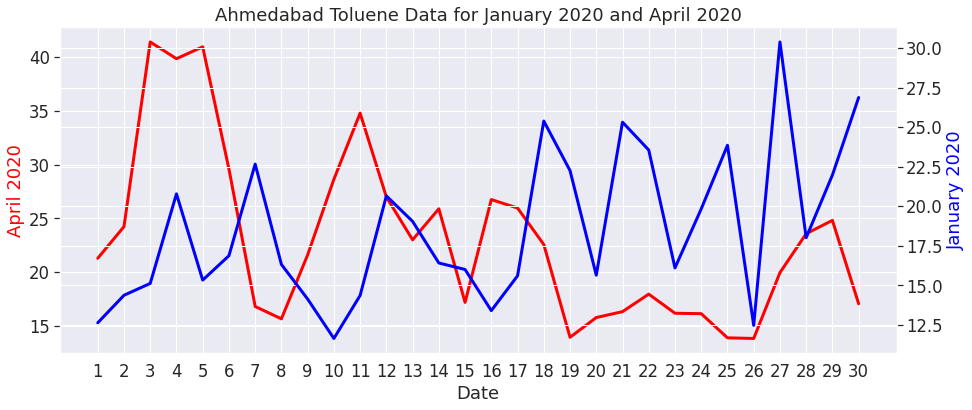

In [238]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad Toluene Data for January 2020 and April 2020');

Aizawl Toluene data

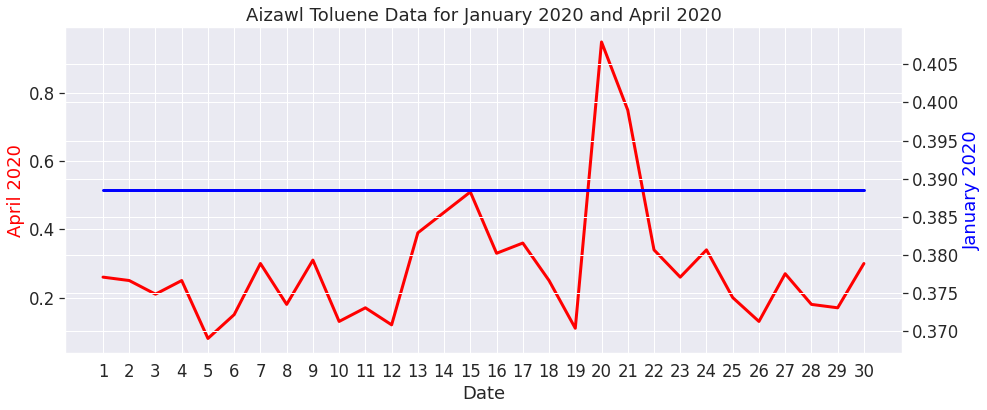

In [239]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Aizawl'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl Toluene Data for January 2020 and April 2020');

Amaravati Toluene data

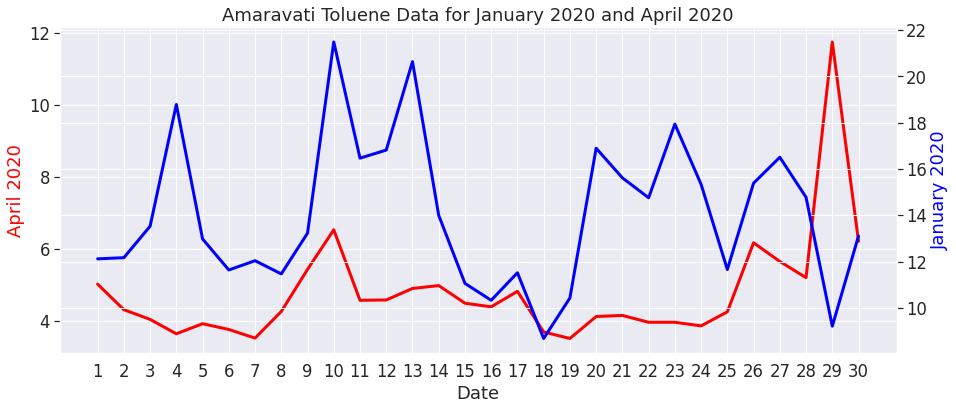

In [241]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Amaravati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati Toluene Data for January 2020 and April 2020');

Amritsar Toluene data

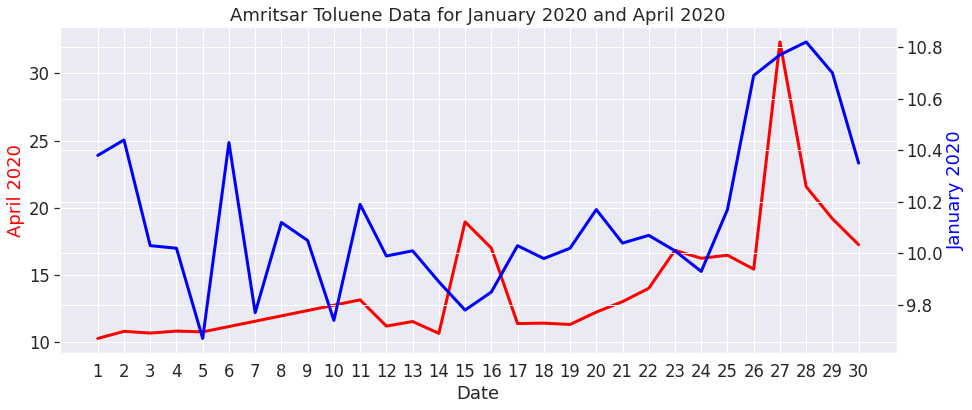

In [240]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar Toluene Data for January 2020 and April 2020');

Bengaluru Toluene data

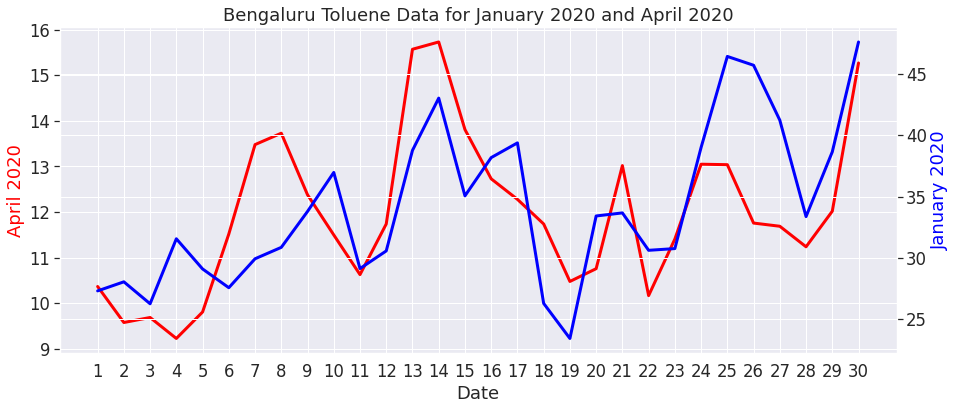

In [242]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru Toluene Data for January 2020 and April 2020');

Bhopal Toluene data

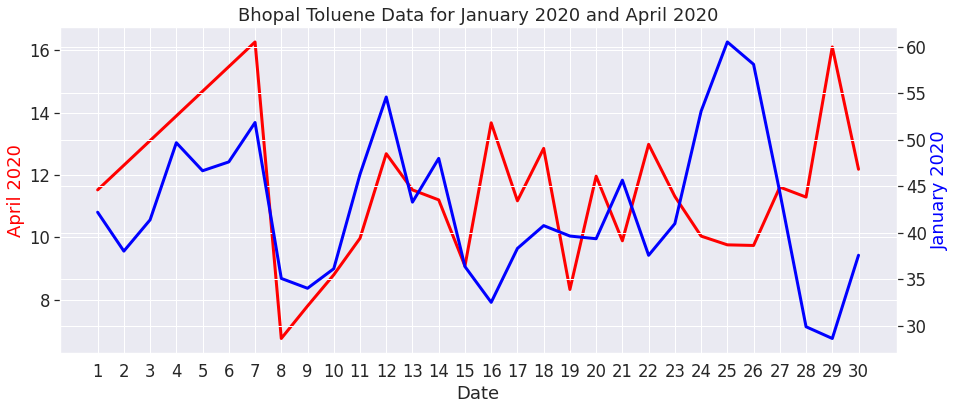

In [243]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal Toluene Data for January 2020 and April 2020');

Chandigarh Toluene data

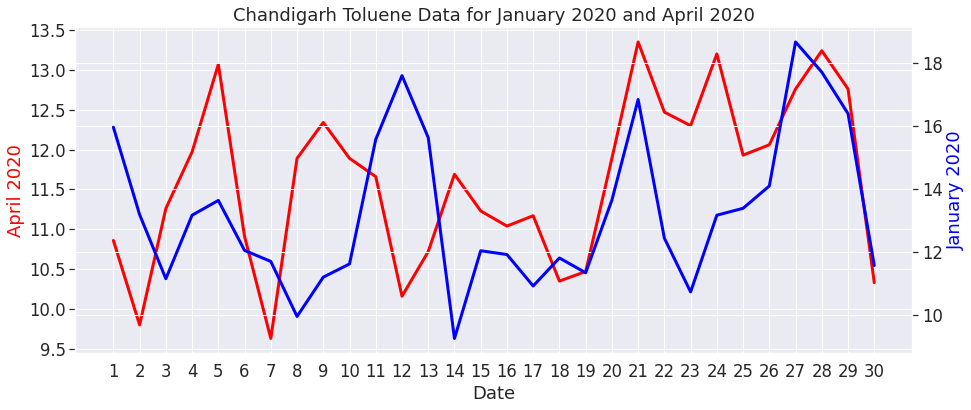

In [244]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Chandigarh'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh Toluene Data for January 2020 and April 2020');

Chennai Toluene data

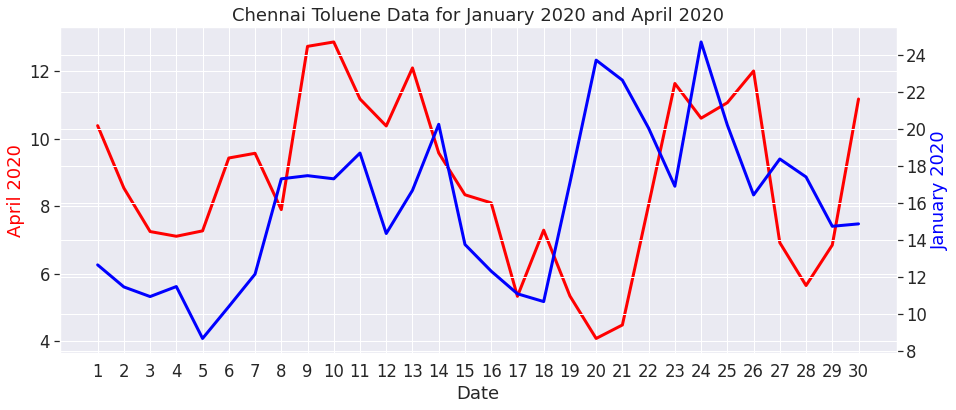

In [245]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Chennai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai Toluene Data for January 2020 and April 2020');

Coimbatore Toluene data

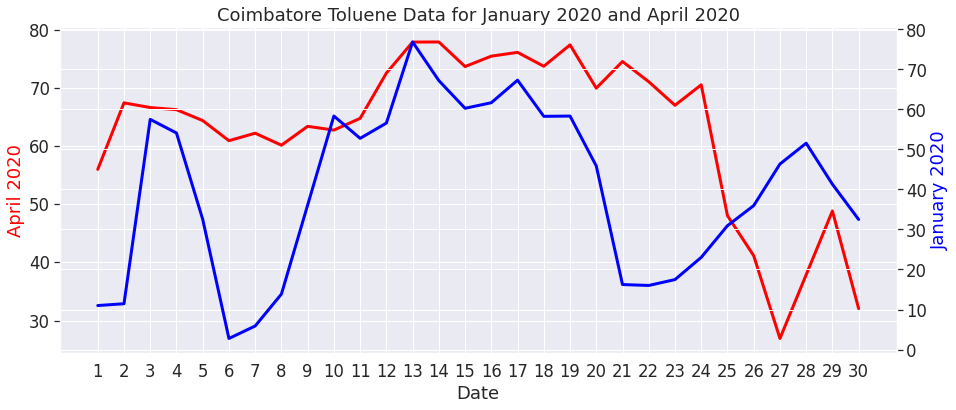

In [246]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Coimbatore'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore Toluene Data for January 2020 and April 2020');

Delhi Toluene data

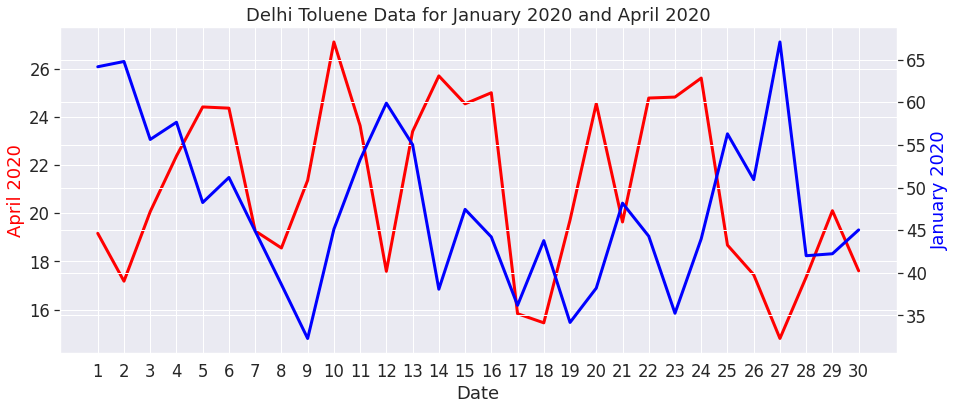

In [247]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Delhi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi Toluene Data for January 2020 and April 2020');

Ernakulam Toluene data

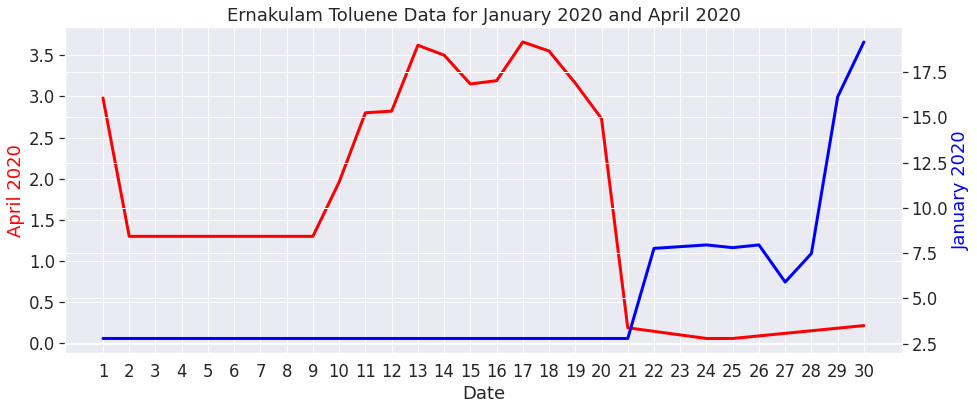

In [248]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Ernakulam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Ernakulam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ernakulam Toluene Data for January 2020 and April 2020');

Guwahati Toluene data

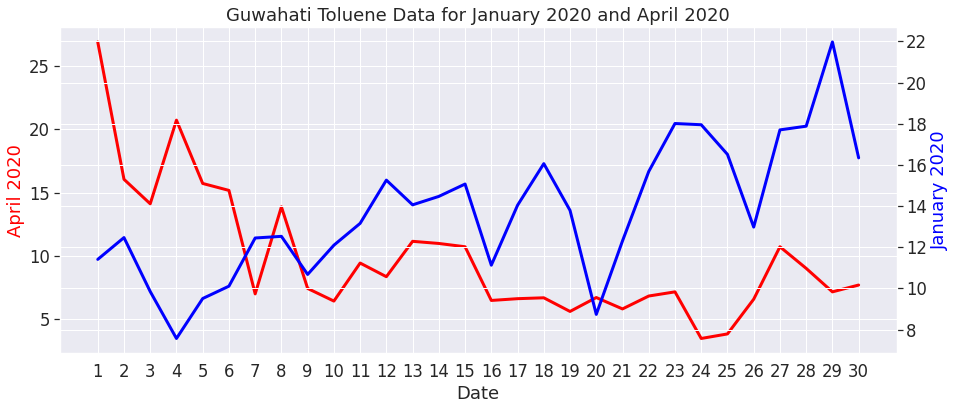

In [249]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati Toluene Data for January 2020 and April 2020');

Gurugram Toluene data

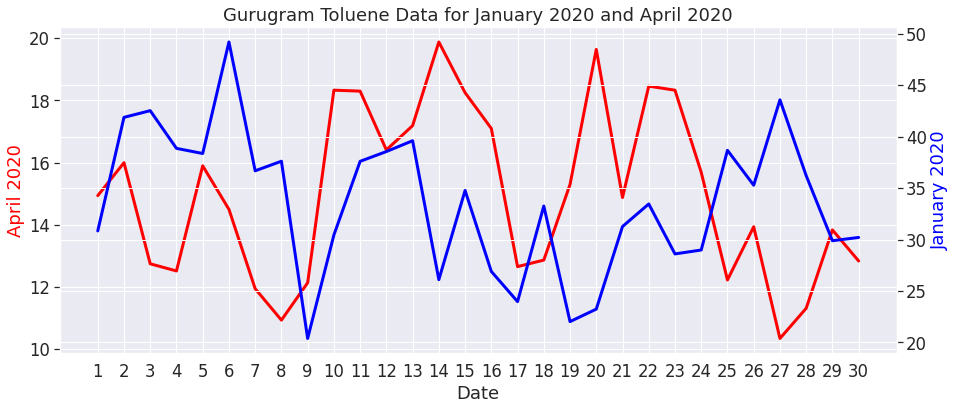

In [250]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Gurugram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram Toluene Data for January 2020 and April 2020');

Guwahati Toluene data

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati Toluene Data for January 2020 and April 2020');

Hyderabad Toluene data

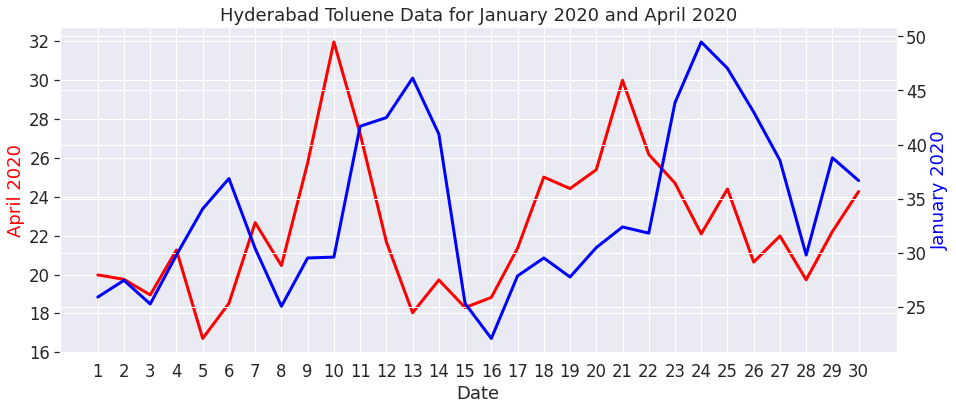

In [251]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Hyderabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Hyderabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad Toluene Data for January 2020 and April 2020');

Jaipur Toluene data

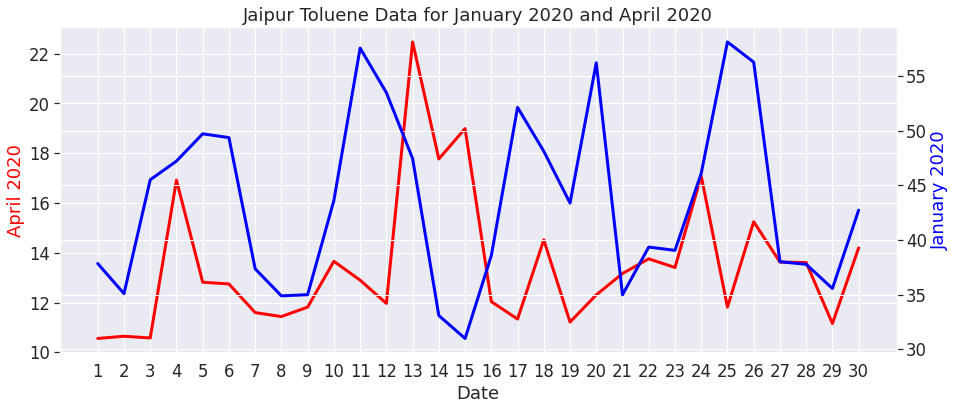

In [252]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Jaipur'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur Toluene Data for January 2020 and April 2020');

Kochi Toluene data

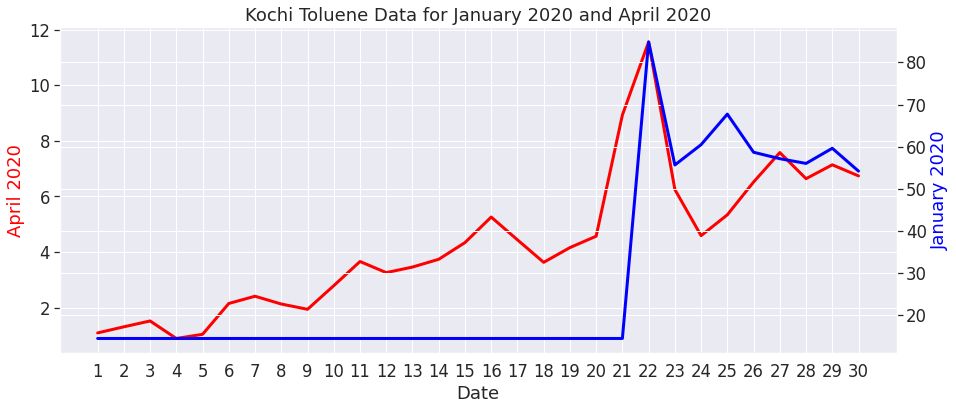

In [253]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Kochi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Kochi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kochi Toluene Data for January 2020 and April 2020');

Kolkata Toluene data

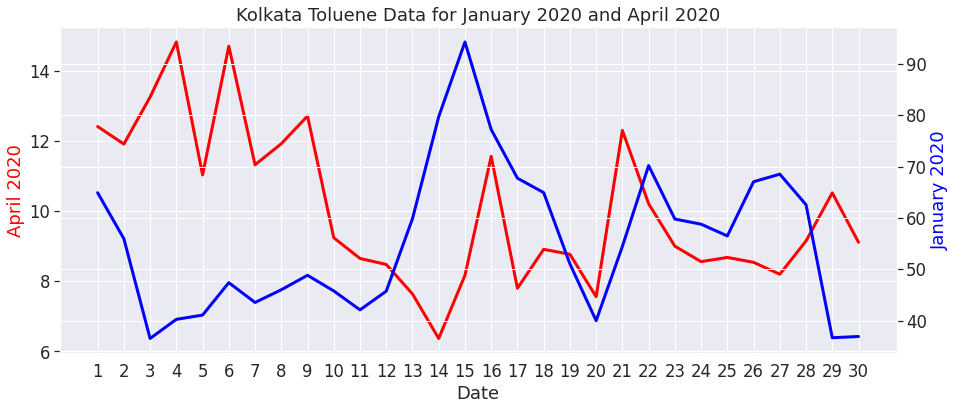

In [254]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Kolkata'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata Toluene Data for January 2020 and April 2020');

Lucknow Toluene data

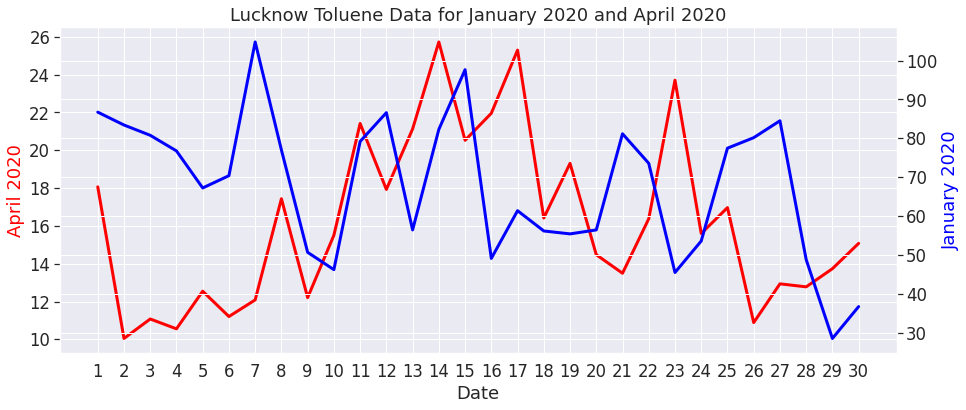

In [255]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Lucknow'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow Toluene Data for January 2020 and April 2020');

Mumbai Toluene data 

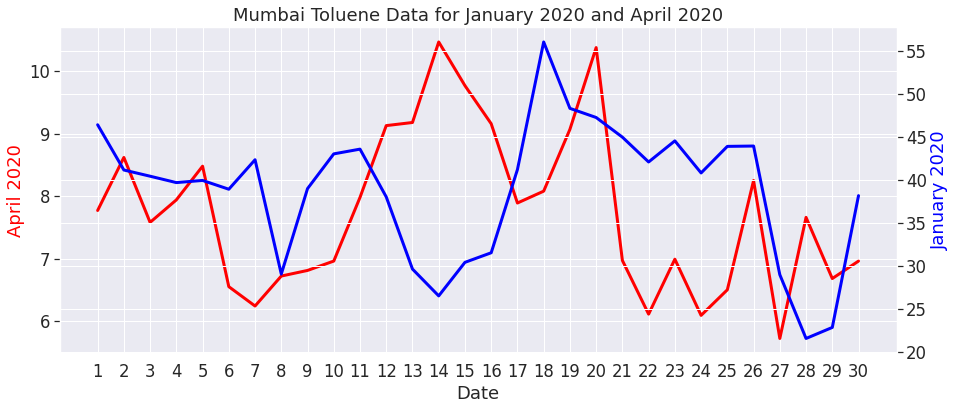

In [256]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Mumbai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai Toluene Data for January 2020 and April 2020');

Patna Toluene data

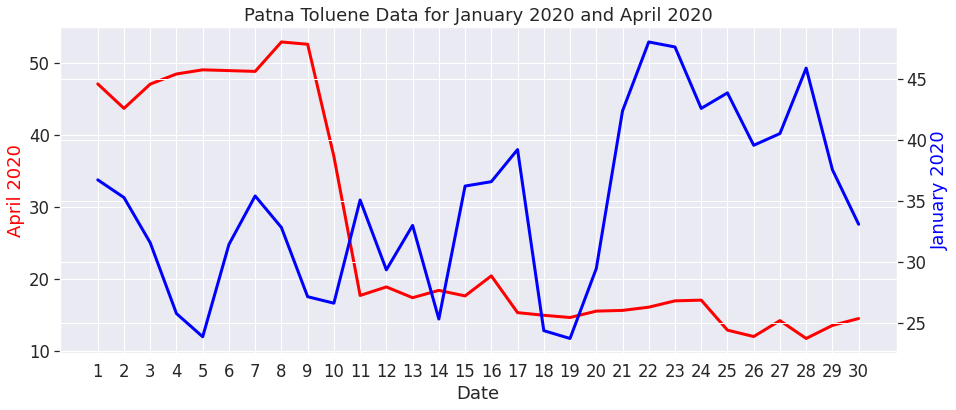

In [257]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna Toluene Data for January 2020 and April 2020');

Shillong Toluene data

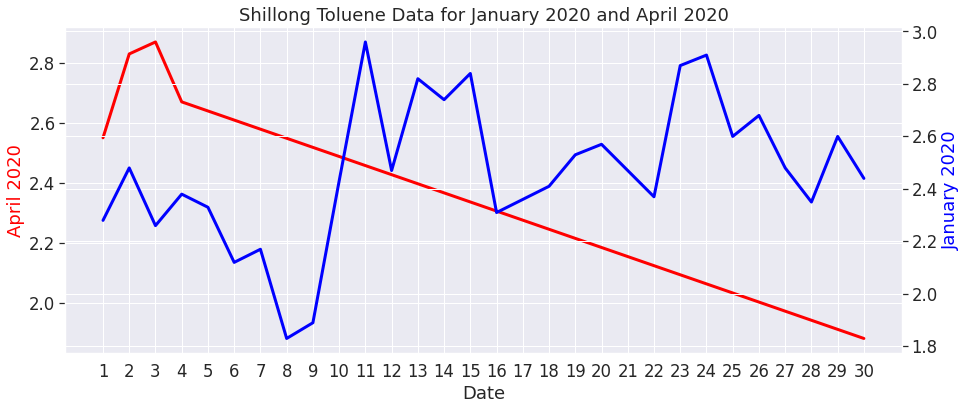

In [258]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Shillong'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong Toluene Data for January 2020 and April 2020');

Talcher Toluene data

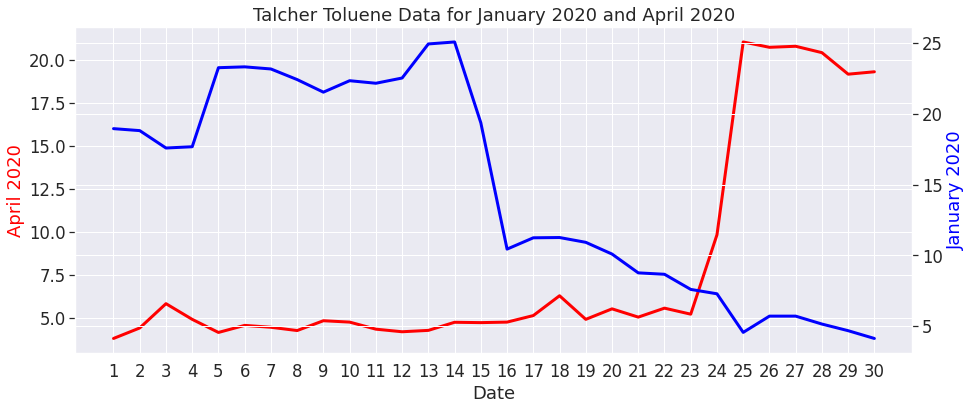

In [261]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Talcher'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Talcher'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Talcher Toluene Data for January 2020 and April 2020');

Thiruvananthapuram Toluene data

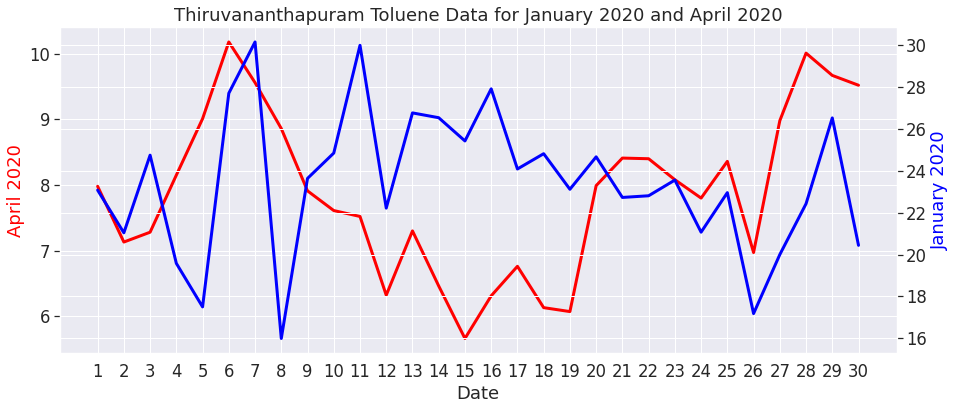

In [262]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Thiruvananthapuram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Thiruvananthapuram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Thiruvananthapuram Toluene Data for January 2020 and April 2020');

Visakhapatnam Toluene data

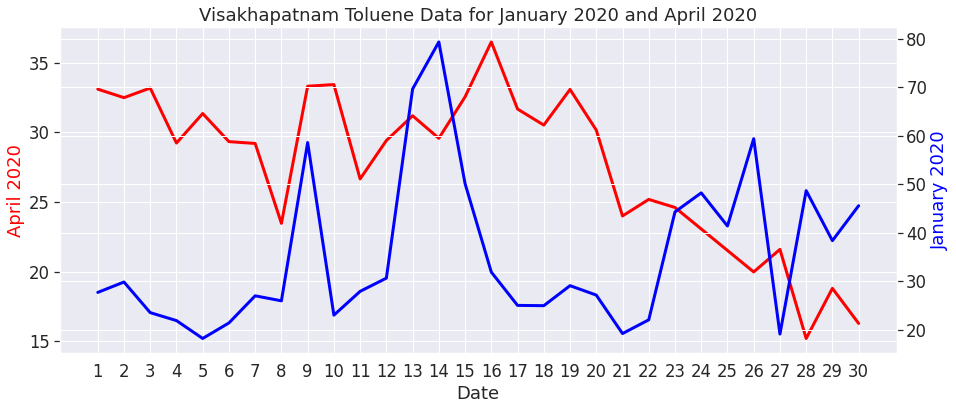

In [263]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfToluene_Apr2020.index,dfToluene_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfToluene_Jan2020.index,dfToluene_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam Toluene Data for January 2020 and April 2020');

### January 2020 and April 2020 'O3' Data Check

In [ ]:
df_O3 = dfcity_day.pivot(index='Date', columns='City', values='O3')
df_O3 = df_O3.fillna(df_O3.mean())
dfO3_Apr2020 = df_O3.loc['2020-04-01':'2020-04-30']
dfO3_Jan2020 = df_O3.loc['2020-01-01':'2020-01-30']

Ahmedabad O3 data

In [ ]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfO3_Apr2020.index,dfO3_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfO3_Jan2020.index,dfO3_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong Toluene Data for January 2020 and April 2020');

Aizawl O3 data

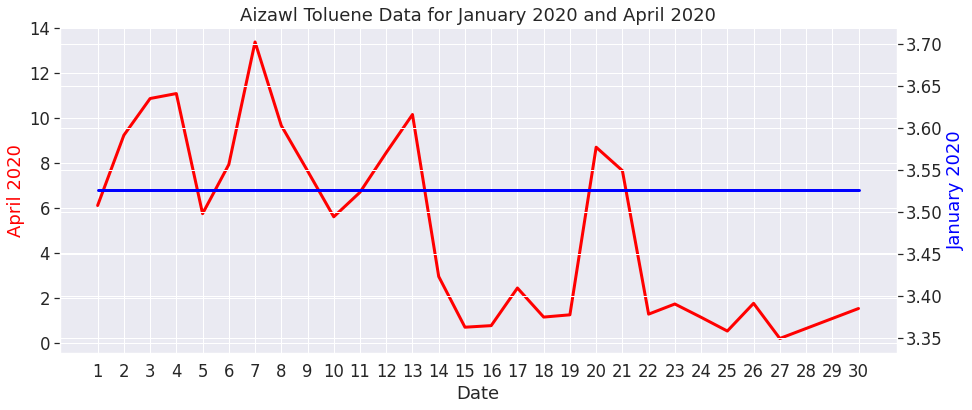

In [265]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfO3_Apr2020.index,dfO3_Apr2020['Aizawl'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfO3_Jan2020.index,dfO3_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl Toluene Data for January 2020 and April 2020');

Amaravati O3 data

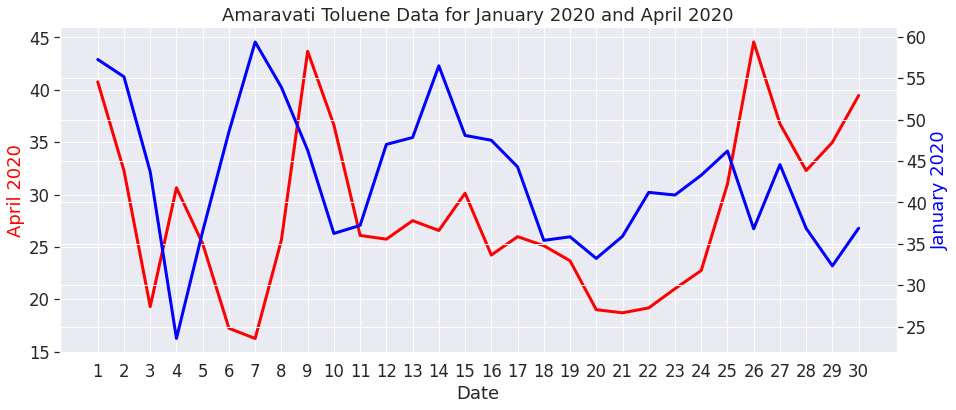

In [266]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfO3_Apr2020.index,dfO3_Apr2020['Amaravati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfO3_Jan2020.index,dfO3_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati Toluene Data for January 2020 and April 2020');

Amritsar O3 data

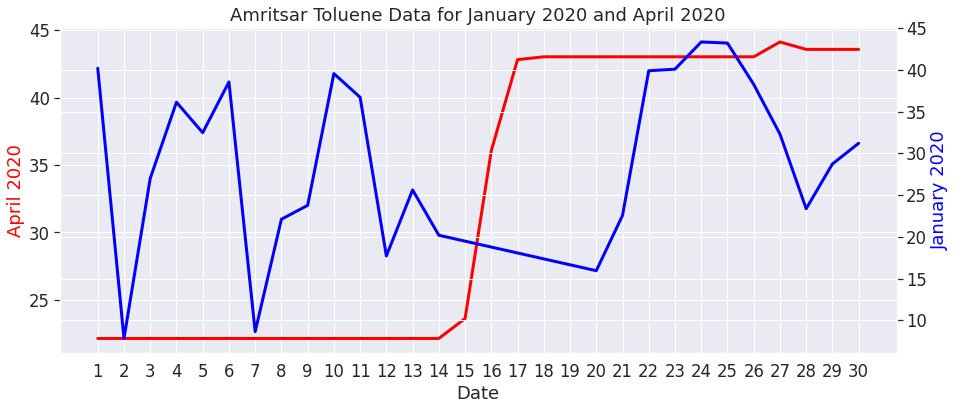

In [267]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfO3_Apr2020.index,dfO3_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfO3_Jan2020.index,dfO3_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar Toluene Data for January 2020 and April 2020');

Bengaluru O3 data

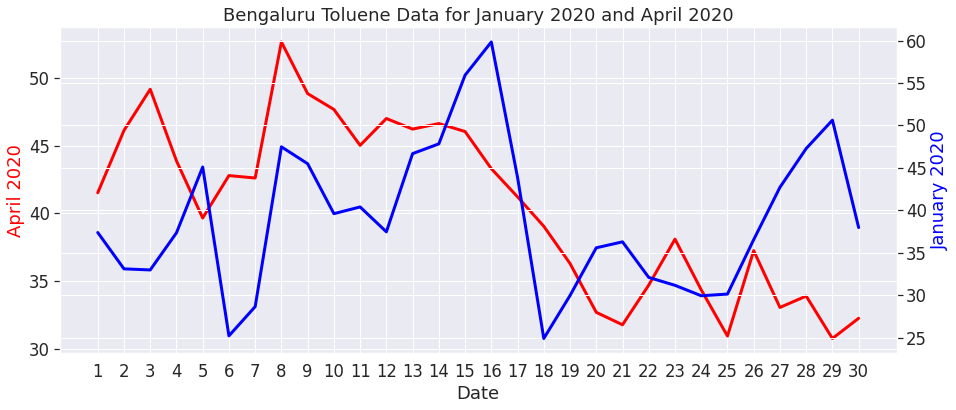

In [268]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfO3_Apr2020.index,dfO3_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfO3_Jan2020.index,dfO3_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru Toluene Data for January 2020 and April 2020');

Bhopal O3 data

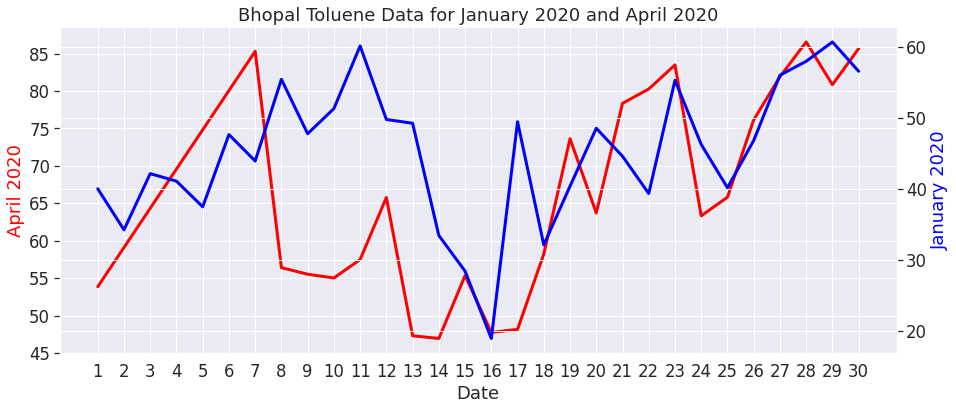

In [269]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfO3_Apr2020.index,dfO3_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfO3_Jan2020.index,dfO3_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal Toluene Data for January 2020 and April 2020');

Chandigarh O3 data

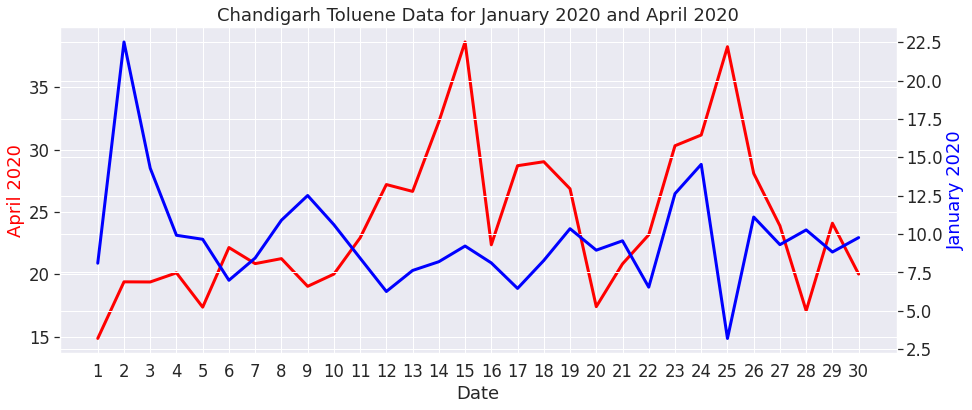

In [270]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfO3_Apr2020.index,dfO3_Apr2020['Chandigarh'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfO3_Jan2020.index,dfO3_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh Toluene Data for January 2020 and April 2020');

Gurugram

Gurugram

Gurugram

Visakhapatnam O3 Data

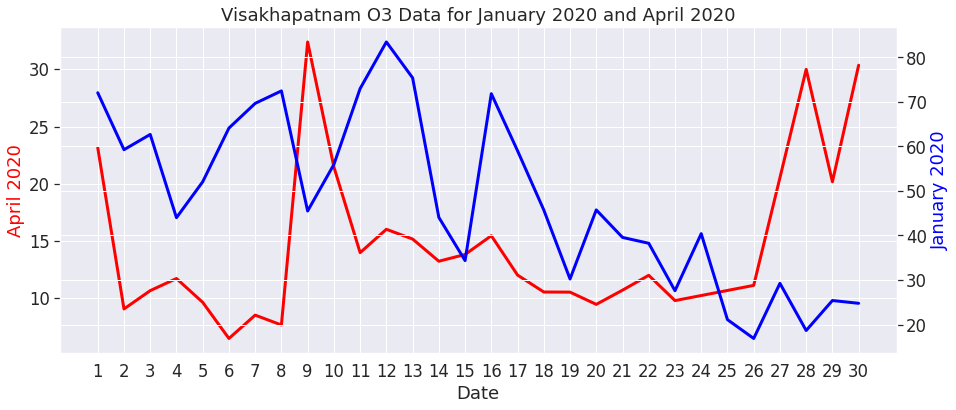

In [264]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfO3_Apr2020.index,dfO3_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfO3_Jan2020.index,dfO3_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam O3 Data for January 2020 and April 2020');

### January 2020 and April 2020 'PM10' Data Check

In [ ]:
df_PM10 = dfcity_day.pivot(index='Date', columns='City', values='NOx')
df_PM10 = df_NOx.fillna(df_NOx.mean())
dfPM10_Apr2020 = df_PM10.loc['2020-04-01':'2020-04-30']
dfPM10_Jan2020 = df_PM10.loc['2020-01-01':'2020-01-30']

Ahmedabad PM10 data

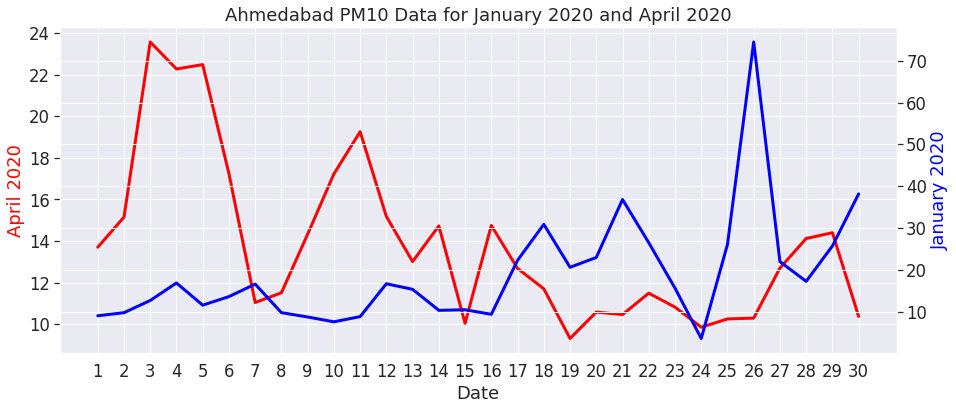

In [296]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Ahmedabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Ahmedabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ahmedabad PM10 Data for January 2020 and April 2020');

Aizawl PM10 data

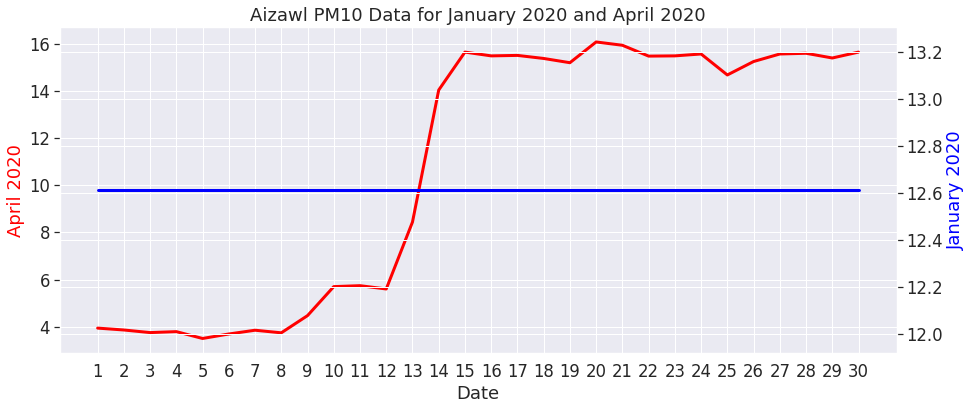

In [297]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Aizawl'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Aizawl'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Aizawl PM10 Data for January 2020 and April 2020');

Amaravati PM10 data

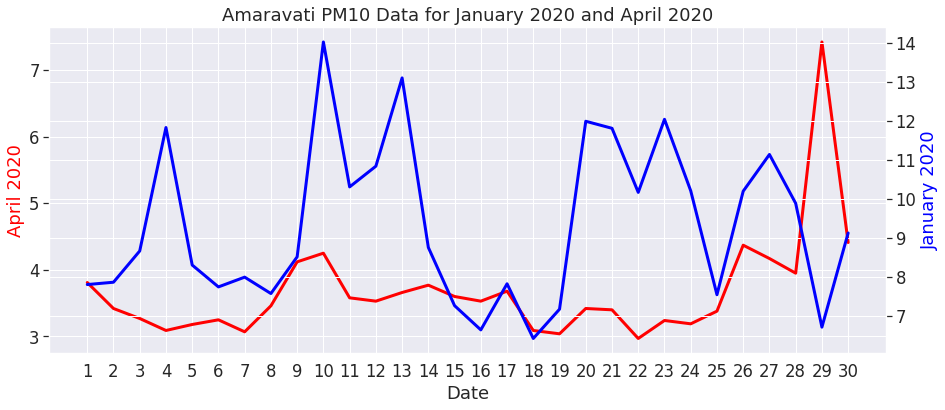

In [298]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Amaravati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Amaravati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amaravati PM10 Data for January 2020 and April 2020');

Amritsar PM10 data

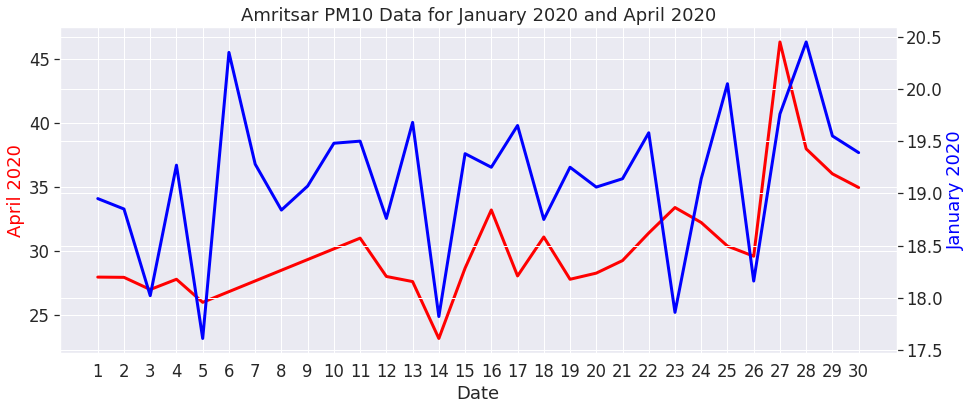

In [299]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Amritsar'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Amritsar'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Amritsar PM10 Data for January 2020 and April 2020');

Bengaluru PM10 data

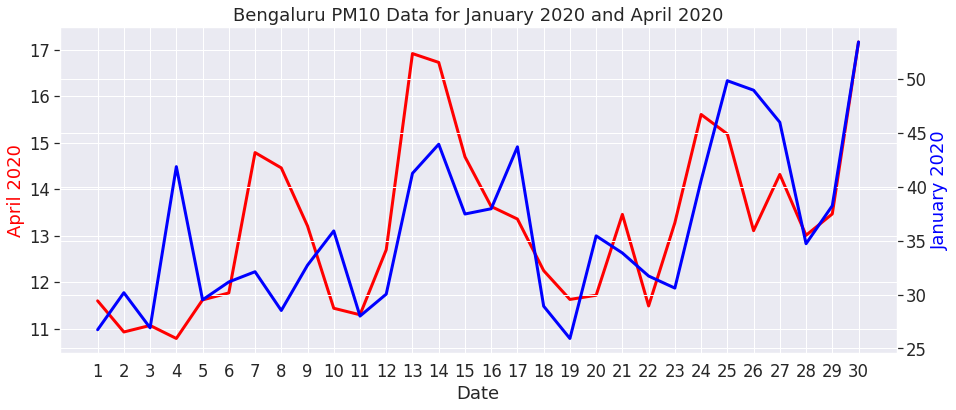

In [301]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Bengaluru'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Bengaluru'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bengaluru PM10 Data for January 2020 and April 2020');

Bhopal PM10 data

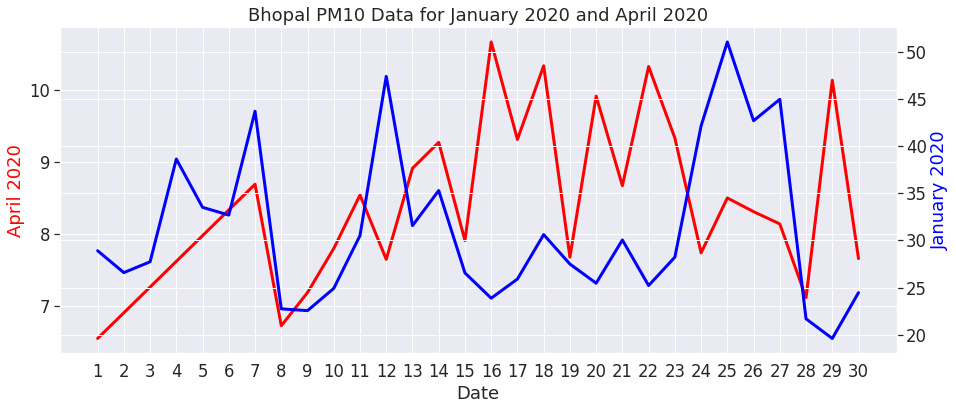

In [302]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Bhopal'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Bhopal'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Bhopal PM10 Data for January 2020 and April 2020');

Chandigarh PM10 data

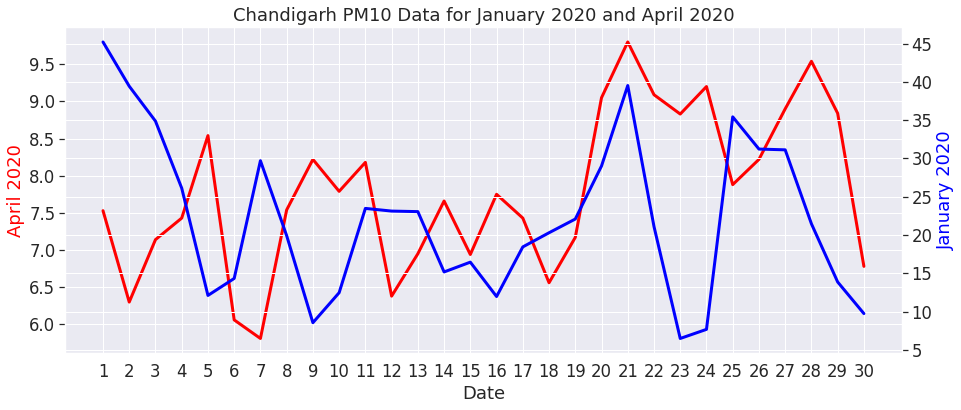

In [303]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Chandigarh'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Chandigarh'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chandigarh PM10 Data for January 2020 and April 2020');

Chennai PM10 data

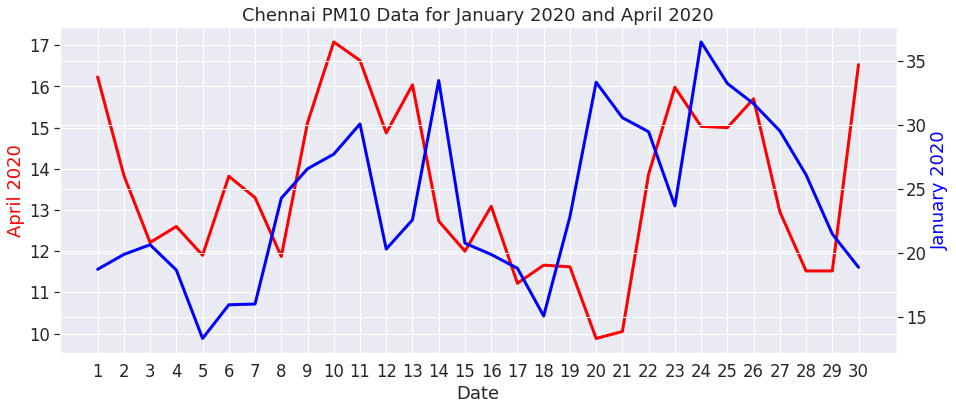

In [304]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Chennai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Chennai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Chennai PM10 Data for January 2020 and April 2020');

Coimbatore PM10 data

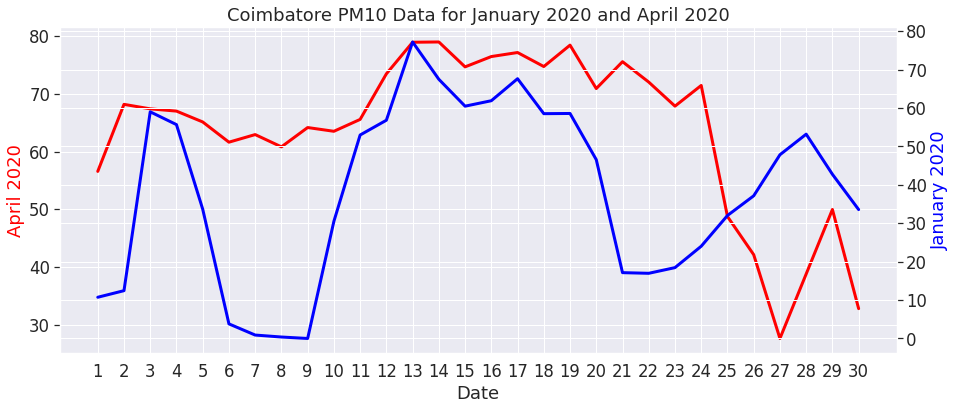

In [305]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Coimbatore'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Coimbatore'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Coimbatore PM10 Data for January 2020 and April 2020');

Delhi PM10 data

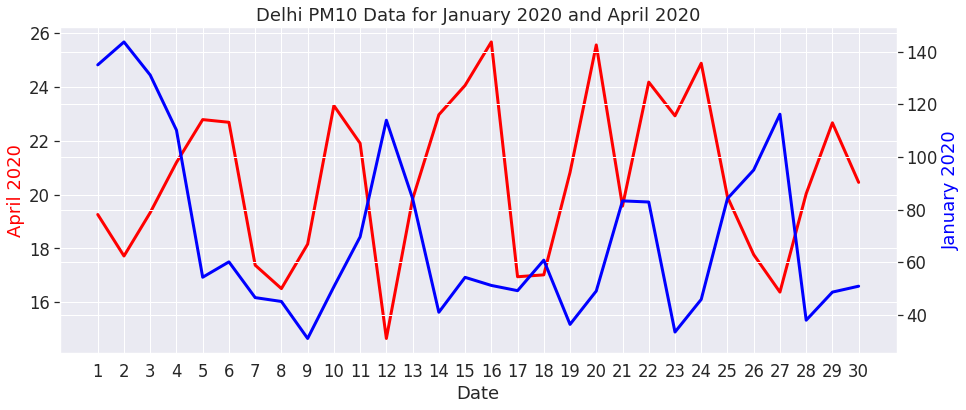

In [306]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Delhi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Delhi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Delhi PM10 Data for January 2020 and April 2020');

Ernakulam PM10 data

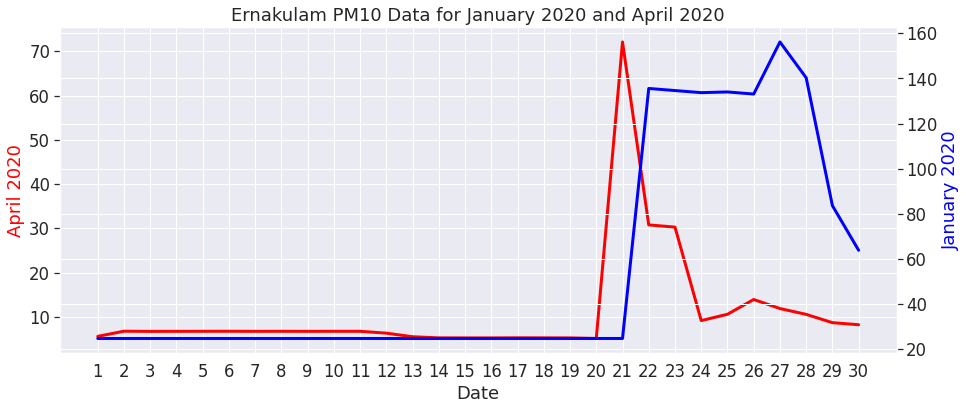

In [307]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Ernakulam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Ernakulam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Ernakulam PM10 Data for January 2020 and April 2020');

Gurugram PM10 data

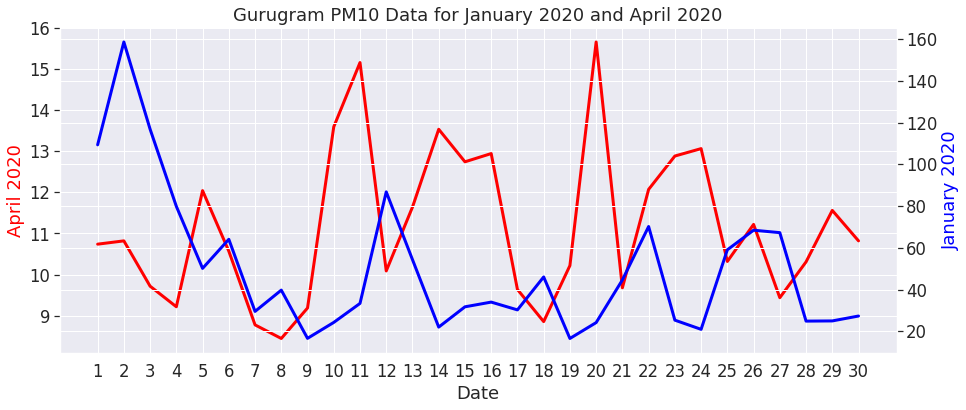

In [308]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Gurugram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Gurugram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Gurugram PM10 Data for January 2020 and April 2020');

Guwahati PM10 data

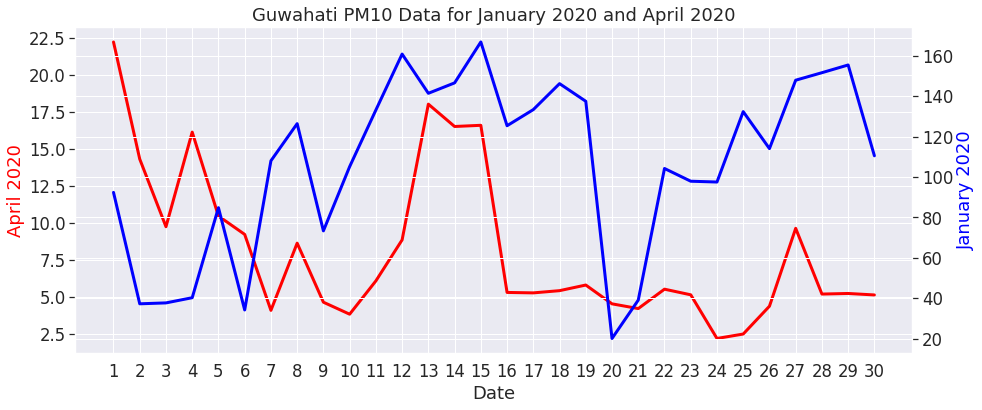

In [309]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Guwahati'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Guwahati'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Guwahati PM10 Data for January 2020 and April 2020');

Hyderabad PM10 data

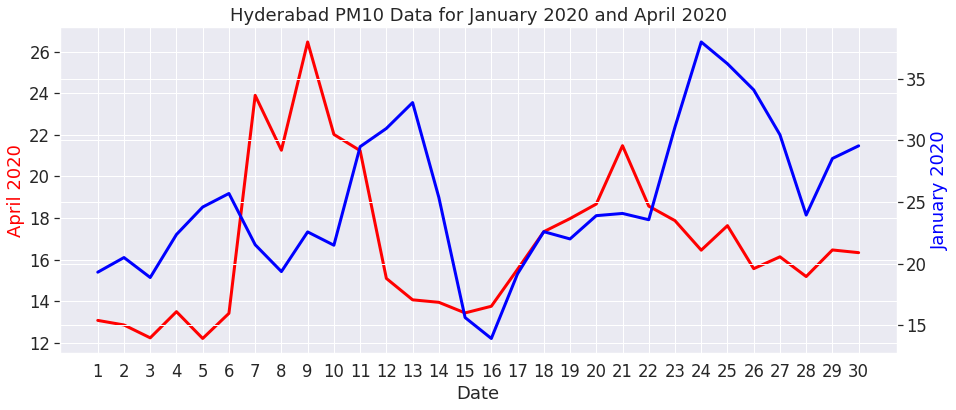

In [311]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Hyderabad'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Hyderabad'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Hyderabad PM10 Data for January 2020 and April 2020');

Jaipur PM10 data

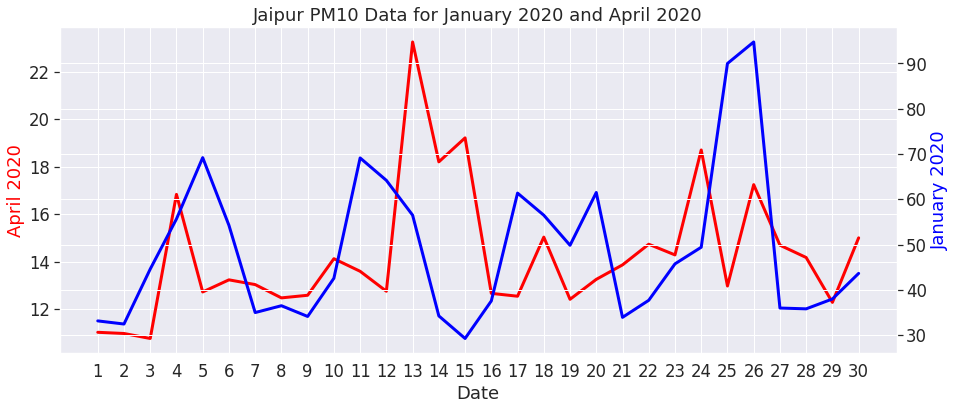

In [312]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Jaipur'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Jaipur'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Jaipur PM10 Data for January 2020 and April 2020');

Kochi PM10 data

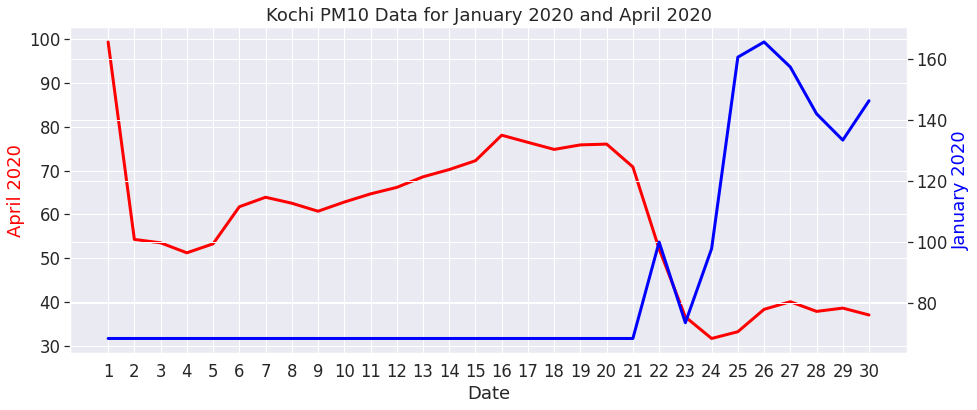

In [313]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Kochi'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Kochi'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kochi PM10 Data for January 2020 and April 2020');

Kolkata PM10 data

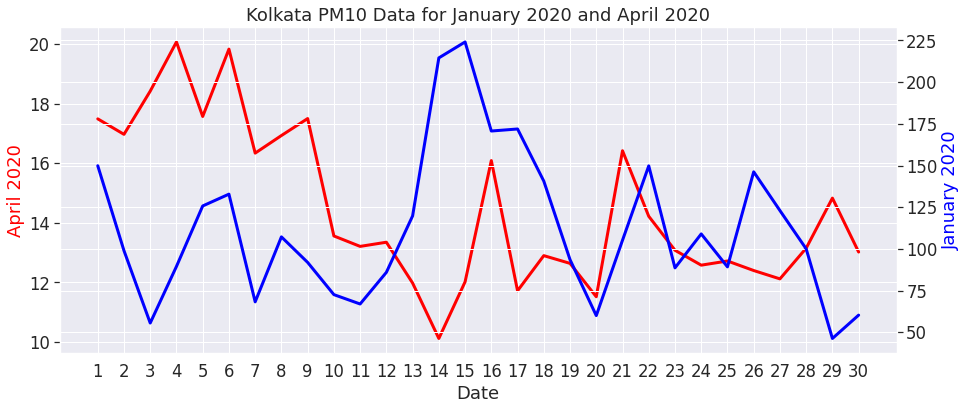

In [314]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Kolkata'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Kolkata'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Kolkata PM10 Data for January 2020 and April 2020');

Lucknow PM10 data

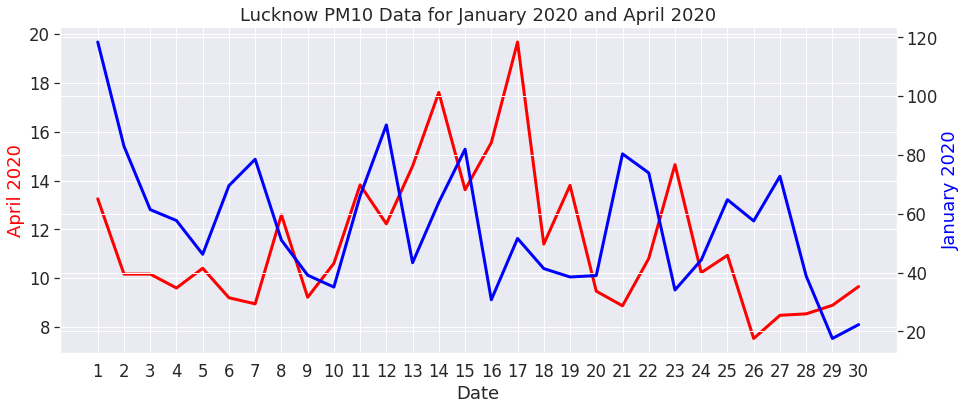

In [315]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Lucknow'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Lucknow'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Lucknow PM10 Data for January 2020 and April 2020');

Mumbai PM10 data

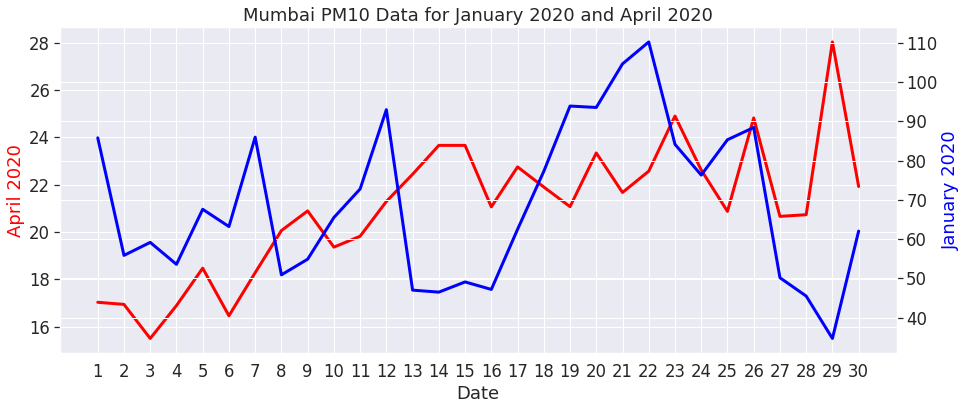

In [316]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Mumbai'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Mumbai'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Mumbai PM10 Data for January 2020 and April 2020');

Patna PM10 data

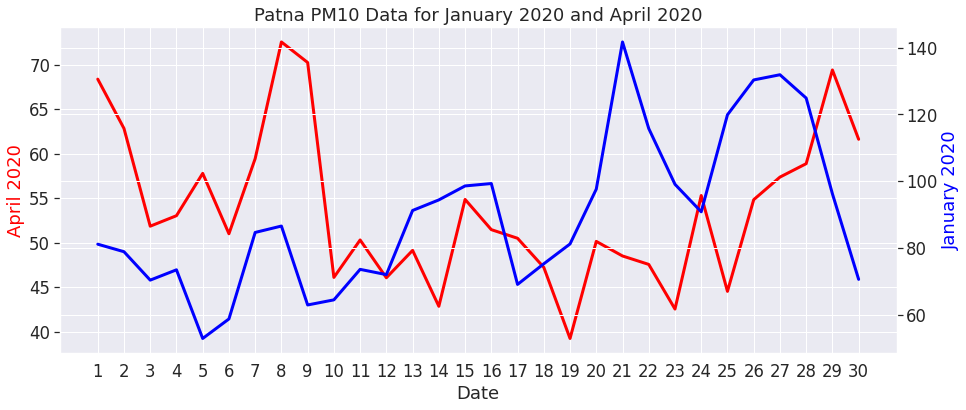

In [317]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna PM10 Data for January 2020 and April 2020');

Shillong PM10 data

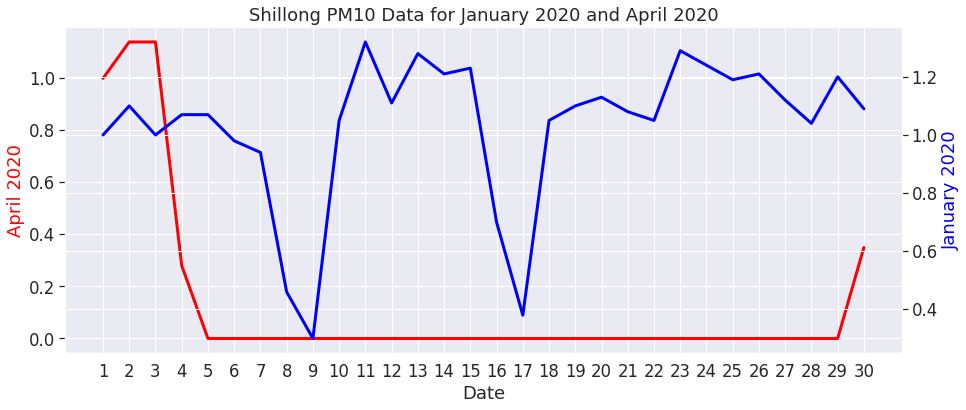

In [319]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Shillong'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Shillong'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Shillong PM10 Data for January 2020 and April 2020');

Talcher PM10 data

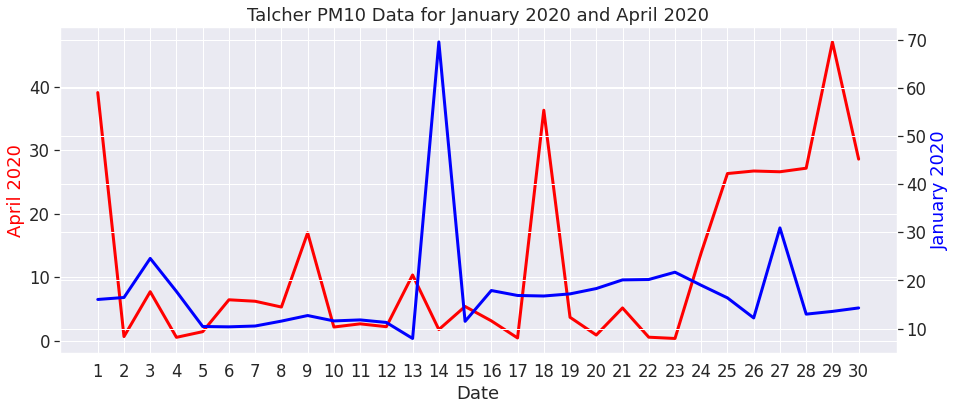

In [320]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Talcher'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Talcher'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Talcher PM10 Data for January 2020 and April 2020');

Patna PM10 data

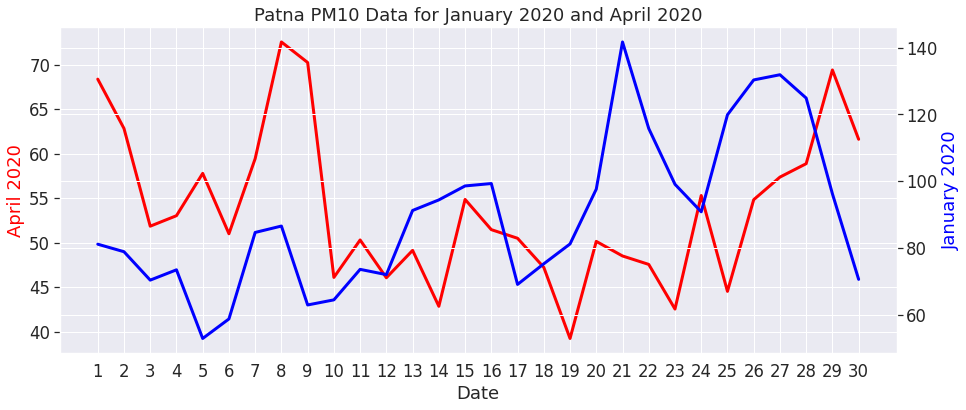

In [322]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Patna'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Patna'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Patna PM10 Data for January 2020 and April 2020');

Thiruvananthapuram PM10 data

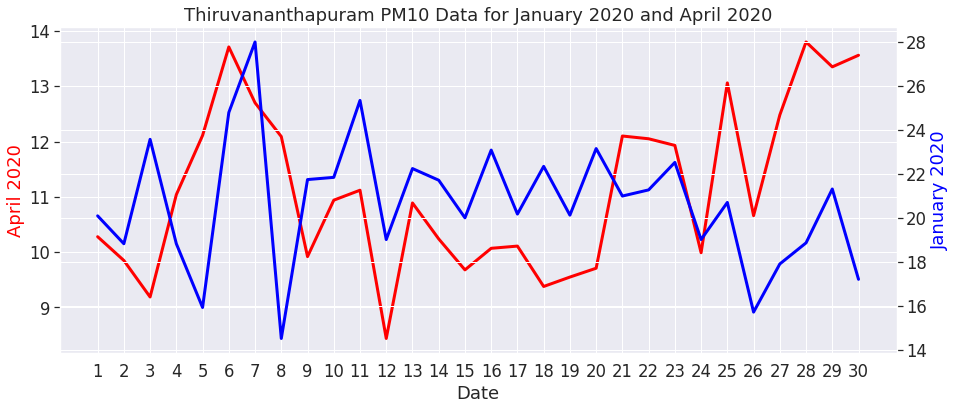

In [321]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Thiruvananthapuram'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Thiruvananthapuram'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Thiruvananthapuram PM10 Data for January 2020 and April 2020');

Visakhapatnam PM10 data

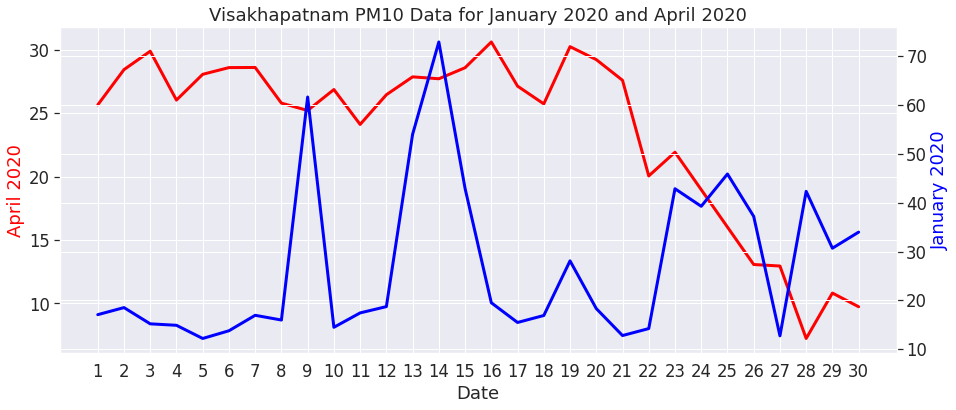

In [323]:
sns.set(palette='Paired');
sns.set_context("notebook", font_scale= 1.5, rc={"lines.linewidth": 3});
fig, ax = plt.subplots(figsize = (15,6));
sns.lineplot(dfPM10_Apr2020.index,dfPM10_Apr2020['Visakhapatnam'],ax=ax,color='red');
ax.set_ylabel('April 2020',color='red')

ax2 = ax.twinx()
sns.lineplot(dfPM10_Jan2020.index,dfPM10_Jan2020['Visakhapatnam'],ax=ax2,color='blue');
ax2.set_xticklabels(labels=range(1,31), rotation=0, ha='right');
ax2.set_ylabel('January 2020',color='blue')

plt.title('Visakhapatnam PM10 Data for January 2020 and April 2020');